Hi! In this notebook, I will provide an intuitive discussion of how to train vanilla-GAN and DCGAN.
OS: Windows10
GPU: RTX3070 \
Let us first import the necessary libraries we will use for training the network.

In [1]:
import torch
from torch import nn, optim
from torchvision import transforms, datasets
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np

I usually start my notebooks by setting the device I will be using to train the network. In most cases, models could be trained in either CPU or GPU. BUT!!! GPU training is always faster.\
PS. This is only for single GPU, implementing in multiple GPUs require parallel processing.

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Next, we download and transform the datasets. In this implementation, we will use mnist and celeb-a.

In [3]:
def mnist_data(res_val=28): #res_val resizes the image to desired resolution. Default for mnist = 28, default for celeb-a = 64.
    
    compose = transforms.Compose(
        [transforms.Resize([res_val,res_val]),
         transforms.ToTensor(),
         transforms.Normalize((.5,),(.5,))
        ]
    )
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir,train=True,transform=compose,download=True), res_val

def celeba_data(res_val=64):
    
    compose = transforms.Compose(
        [transforms.Resize([res_val,res_val]),
         transforms.ToTensor(),
         transforms.Normalize((.5,.5,.5),(.5,.5,.5))
        ]
    )
    out_dir = './dataset'
    return datasets.CelebA(root=out_dir,transform=compose,download=True), res_val

In [31]:
#loading of datasets, currently only mnist can be downloaded since celeb-a reached download limit

mnist, res_val = mnist_data()
dc_mnist, dc_val = mnist_data(res_val=64)
# celeba = celeba_data()

I always like to visualize the dataset first before creating and training my models. I usually do this by checking the shapes and displaying images in a grid.

torch.Size([16, 1, 28, 28])


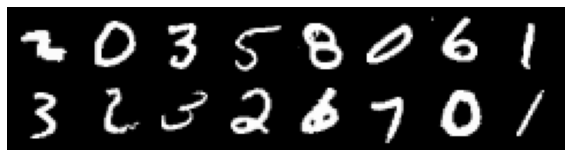

In [5]:
#Visualization of dataset
loader = DataLoader(mnist,batch_size=16,shuffle=True)
for x,y in loader:
    print(x.shape)
    fig = plt.figure(figsize=(10,10))
    grid = make_grid(x[:16],nrows=4,normalize=True,scale_each=True)
    plt.imshow(np.transpose(grid.numpy(),(1,2,0)))
    plt.axis('off')
    break

Next we import the models we will train!

In [6]:
from models.vanilla import Discriminator as vdisc
from models.vanilla import Generator as vgen

Now that we have loaded the models. We will now set the hyperparameters!

In [7]:
###GENERAL###
batch_size = 16
learning_rate = 0.0002
beta = 0.5
epochs = 5

###FOR MNIST###
df = res_val #n_features
dnc = 1 #n_classes for discriminator
gf = 100 #size of noise / n_features
gnc = res_val #n_classes for generator

###FOR CELEBA###

Crucial for training the models are the loss function, optimizers and dataloaders! Do not forget to set beta and learning rates!

In [8]:
dNet = vdisc(n_classes=dnc,n_features=df).to(device)
gNet = vgen(n_classes=gnc,n_features=gf).to(device)

criterion = nn.BCELoss()
optimD = optim.Adam(dNet.parameters(),lr=learning_rate,betas=(beta,0.999))
optimG = optim.Adam(gNet.parameters(),lr=learning_rate,betas=(beta,0.999))

Architecture of discriminator and generator models.

In [9]:
print(dNet)
print(gNet)

Discriminator(
  (main): Sequential(
    (0): Linear(in_features=784, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Dropout(p=0.3, inplace=False)
    (3): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
    )
    (4): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
    )
  )
  (fc): Sequential(
    (0): Linear(in_features=256, out_features=1, bias=True)
    (1): Sigmoid()
  )
)
Generator(
  (main): Sequential(
    (0): Linear(in_features=100, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
  )
  (fc): Sequential(
    (0): Linear(in_features=1024, out_features=784, bias=True)
    (1): Tanh()
  )
)


In [10]:
def noise(size):
    return torch.randn(size,gf)
test_noise = noise(64)

In [11]:
def train(dataset,test_noise=test_noise,epochs=epochs,noise_size=gf,batch_size=batch_size,linear=True,learning_rate=0.0002,beta=0.9):
    
    loader = DataLoader(dataset,batch_size=batch_size,shuffle=True)
    num_batch = len(loader)
    
    def img_noise(size):
        if linear:
            n = torch.randn(size,noise_size)
        else:
            n = torch.randn(size,noise_size,1,1)
        return n

    images = []
    g_loss = []
    d_loss = []
    
    for epoch in range(epochs):
        
        print('-'*40)
        
        for i, (real_data,_) in enumerate(loader):
            
            N = real_data.shape[0]
            
            optimD.zero_grad()
            
            #Discriminator training on real data
            real_data = real_data.to(device)
            labels = torch.ones((N,1),dtype=torch.float,device=device)
                                  
            output = dNet(real_data)
            dx_real = output.mean().item()
            error_dreal = criterion(output,labels)
            error_dreal.backward()
            
            #Discriminator training on fake data
            noise = img_noise(N) #here the noise will be used also for generator.
            fake_data = gNet(noise.to(device)).detach()
            labels = torch.zeros((N,1),dtype=torch.float,device=device)
            
            output = dNet(fake_data)
            dx_fake = output.mean().item()
            error_dfake = criterion(output,labels)
            error_dfake.backward()
            
            errorD = error_dreal + error_dfake
            optimD.step()
            
            #Generator training
            optimG.zero_grad()
            labels = torch.ones((N,1),dtype=torch.float,device=device)
            
            fake_data = gNet(noise.to(device))
            output = dNet(fake_data)
            dx_gen = output.mean().item()
            errorG = criterion(output,labels)
            errorG.backward()
            optimG.step()
            
            g_loss.append(errorG.item())
            d_loss.append(errorD.item())
            if (i) % 100 == 0:
                print(f'Epoch: [{epoch+1}/{epochs}] Batch: [{i}/{num_batch}]')
                print(f'Loss_D: {errorD.item()} Loss_G: {errorG.item()}')
                print(f'D(x): {dx_real} D(G(z)): {dx_fake}')
                
                with torch.no_grad():
                    fake_imgs = gNet(test_noise.to(device)).detach().cpu()
                    if linear:
                        fake_imgs = fake_imgs.view(-1,1,df,df)
                    fig,ax = plt.subplots(figsize=(16,16))
                    grid = make_grid(fake_imgs,normalize=True,scale_each=True)
                    images.append(grid)
                    h_grid = make_grid(fake_imgs[:16],nrows=10,normalize=True,scale_each=True)
                    ax = ax.imshow(np.transpose(h_grid,(1,2,0)))
                    plt.axis('off')
                    plt.show()

    return images, g_loss, d_loss

----------------------------------------
Epoch: [1/5] Batch: [0/3750]
Loss_D: 1.368514895439148 Loss_G: 0.6926175951957703
D(x): 0.5093702077865601 D(G(z)): 0.5002294778823853


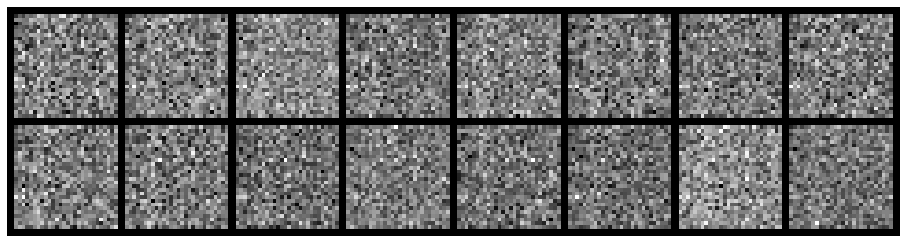

Epoch: [1/5] Batch: [100/3750]
Loss_D: 1.2720705270767212 Loss_G: 1.0231677293777466
D(x): 0.6572098731994629 D(G(z)): 0.5537338256835938


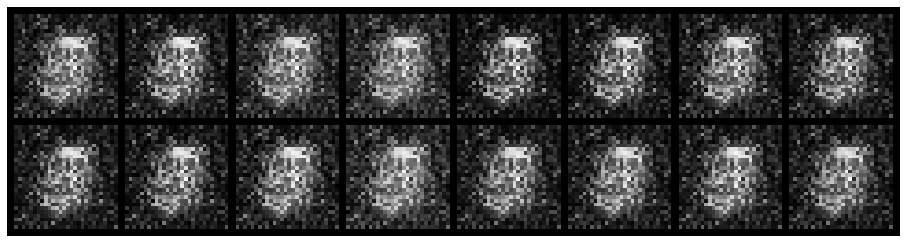

Epoch: [1/5] Batch: [200/3750]
Loss_D: 0.7175894975662231 Loss_G: 1.8053065538406372
D(x): 0.9541761875152588 D(G(z)): 0.4732798933982849


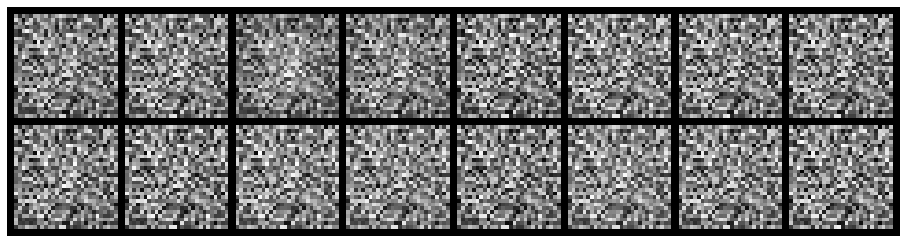

Epoch: [1/5] Batch: [300/3750]
Loss_D: 1.0324076414108276 Loss_G: 0.9560797214508057
D(x): 0.4817652702331543 D(G(z)): 0.12046781182289124


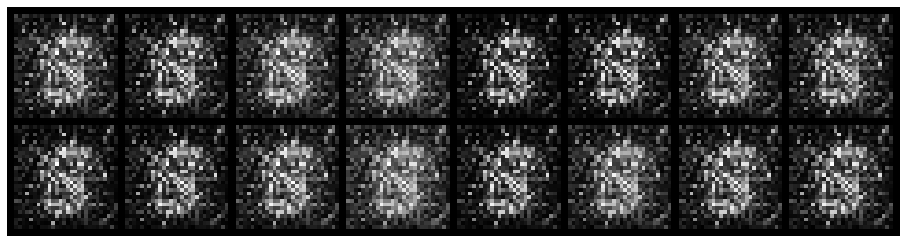

Epoch: [1/5] Batch: [400/3750]
Loss_D: 0.9686596393585205 Loss_G: 4.96113395690918
D(x): 0.9586618542671204 D(G(z)): 0.5875024199485779


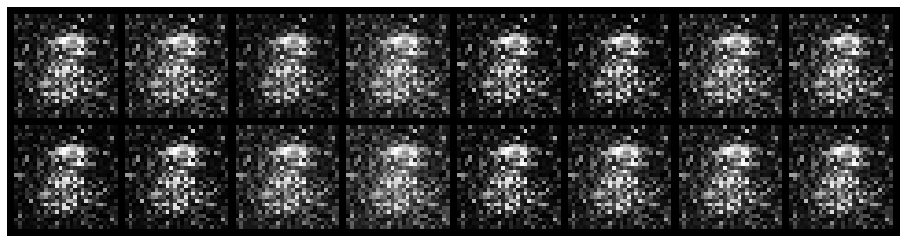

Epoch: [1/5] Batch: [500/3750]
Loss_D: 0.6134640574455261 Loss_G: 4.214842796325684
D(x): 0.9389182925224304 D(G(z)): 0.39769333600997925


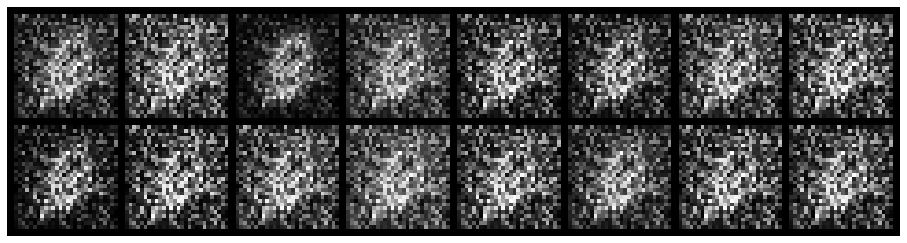

Epoch: [1/5] Batch: [600/3750]
Loss_D: 0.8474324345588684 Loss_G: 3.530827045440674
D(x): 0.8409422636032104 D(G(z)): 0.4416540861129761


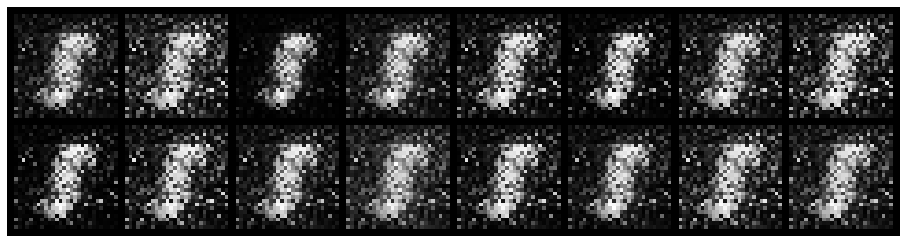

Epoch: [1/5] Batch: [700/3750]
Loss_D: 0.48413601517677307 Loss_G: 2.3752174377441406
D(x): 0.8366153836250305 D(G(z)): 0.2140001803636551


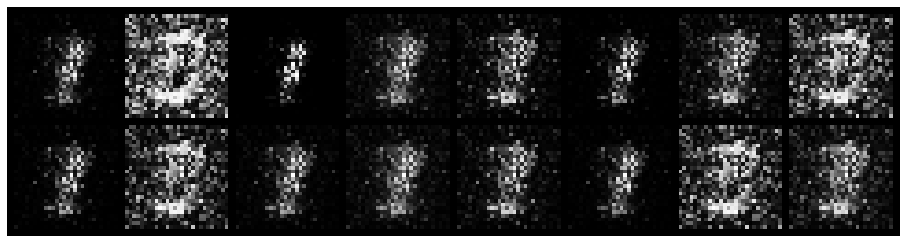

Epoch: [1/5] Batch: [800/3750]
Loss_D: 0.14059263467788696 Loss_G: 4.761674404144287
D(x): 0.9221810102462769 D(G(z)): 0.04777573421597481


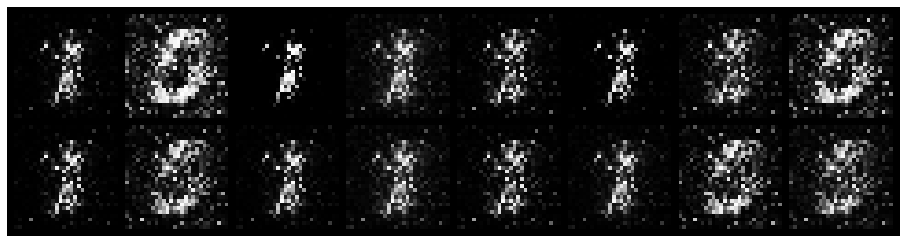

Epoch: [1/5] Batch: [900/3750]
Loss_D: 0.4287075400352478 Loss_G: 2.039883852005005
D(x): 0.8063244223594666 D(G(z)): 0.13205693662166595


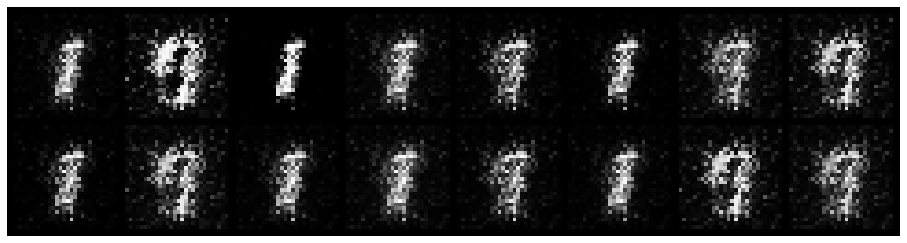

Epoch: [1/5] Batch: [1000/3750]
Loss_D: 0.9926416873931885 Loss_G: 1.6397101879119873
D(x): 0.5230773687362671 D(G(z)): 0.06245553120970726


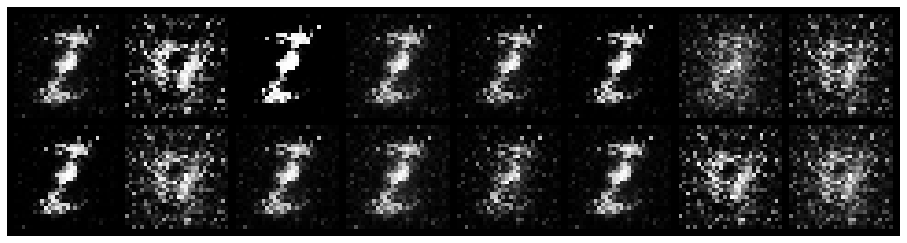

Epoch: [1/5] Batch: [1100/3750]
Loss_D: 0.7089216709136963 Loss_G: 2.149664878845215
D(x): 0.8468155860900879 D(G(z)): 0.3913332223892212


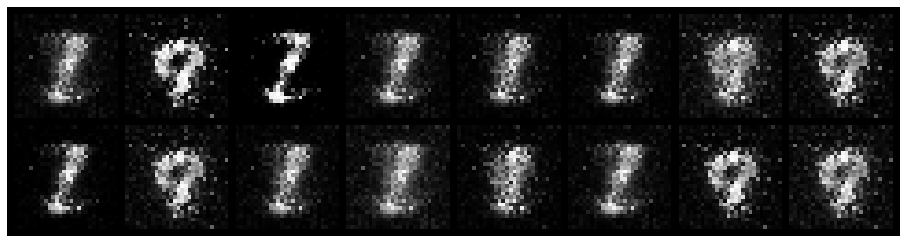

Epoch: [1/5] Batch: [1200/3750]
Loss_D: 1.2486916780471802 Loss_G: 6.868314743041992
D(x): 0.9979820251464844 D(G(z)): 0.6614971160888672


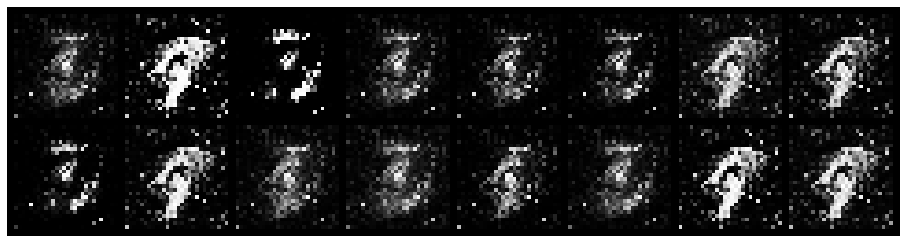

Epoch: [1/5] Batch: [1300/3750]
Loss_D: 0.7624478936195374 Loss_G: 2.876969575881958
D(x): 0.8223040699958801 D(G(z)): 0.38636404275894165


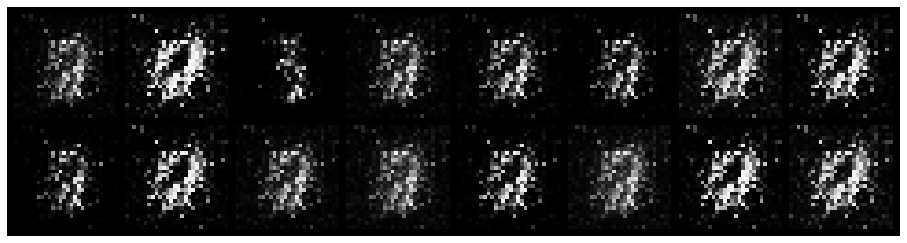

Epoch: [1/5] Batch: [1400/3750]
Loss_D: 1.0220626592636108 Loss_G: 3.505276918411255
D(x): 0.9081286191940308 D(G(z)): 0.4450249671936035


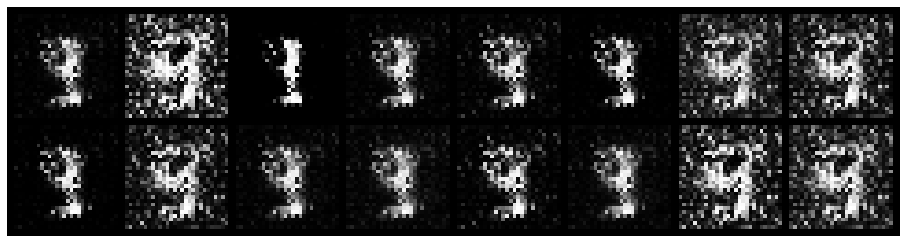

Epoch: [1/5] Batch: [1500/3750]
Loss_D: 0.703911542892456 Loss_G: 2.741454601287842
D(x): 0.8437680006027222 D(G(z)): 0.24183550477027893


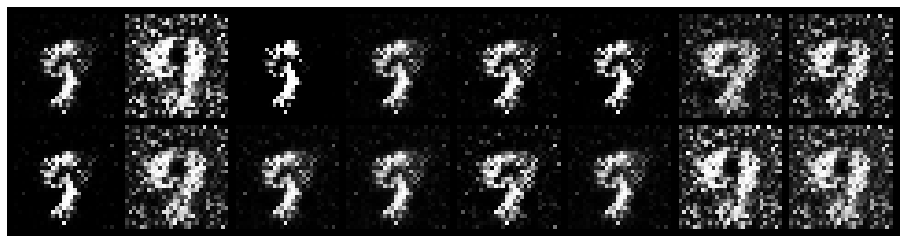

Epoch: [1/5] Batch: [1600/3750]
Loss_D: 0.42281895875930786 Loss_G: 3.3595590591430664
D(x): 0.9687515497207642 D(G(z)): 0.2792859375476837


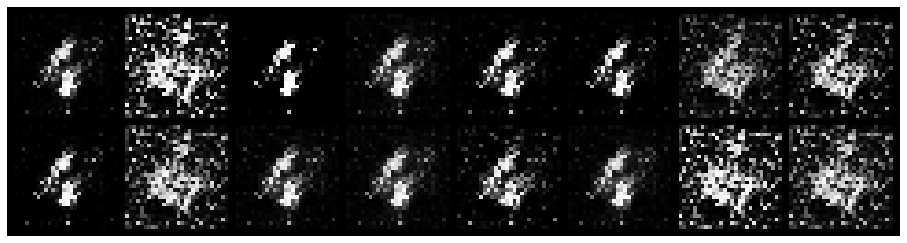

Epoch: [1/5] Batch: [1700/3750]
Loss_D: 0.5387688875198364 Loss_G: 2.6669082641601562
D(x): 0.8106380701065063 D(G(z)): 0.20045596361160278


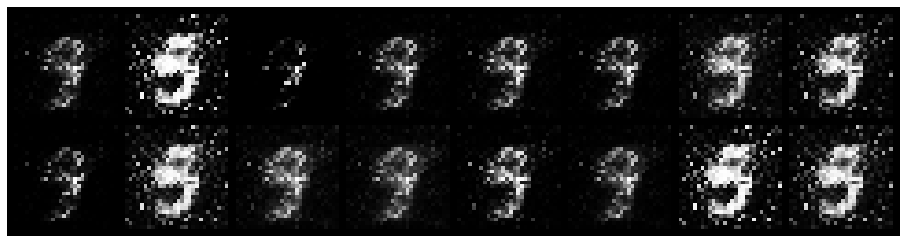

Epoch: [1/5] Batch: [1800/3750]
Loss_D: 0.6917006373405457 Loss_G: 2.0816121101379395
D(x): 0.7314446568489075 D(G(z)): 0.14334842562675476


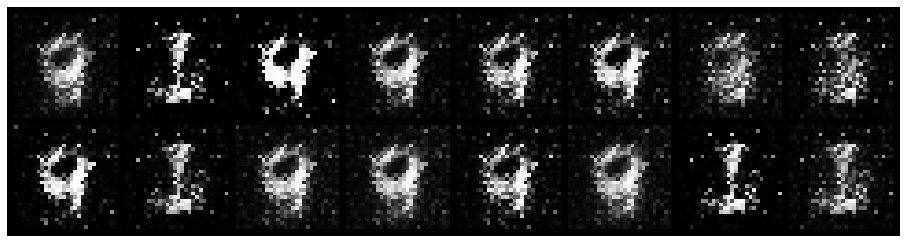

Epoch: [1/5] Batch: [1900/3750]
Loss_D: 0.4654489755630493 Loss_G: 2.729797124862671
D(x): 0.817078709602356 D(G(z)): 0.17661935091018677


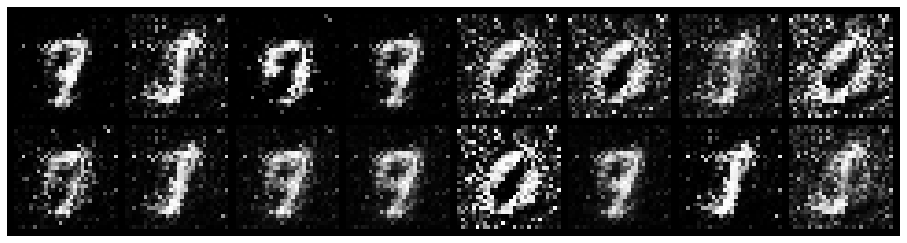

Epoch: [1/5] Batch: [2000/3750]
Loss_D: 0.6691251993179321 Loss_G: 3.416679859161377
D(x): 0.8338000774383545 D(G(z)): 0.2838701009750366


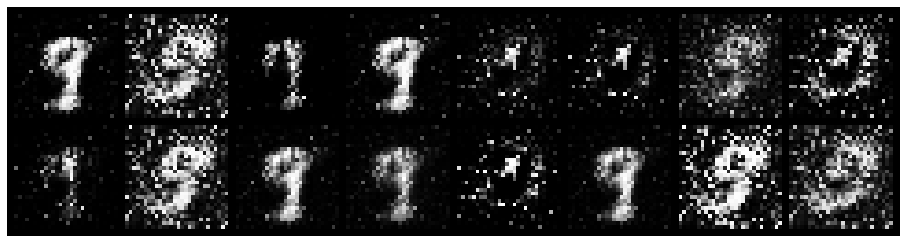

Epoch: [1/5] Batch: [2100/3750]
Loss_D: 0.4701676666736603 Loss_G: 4.9868574142456055
D(x): 0.9189664125442505 D(G(z)): 0.27846354246139526


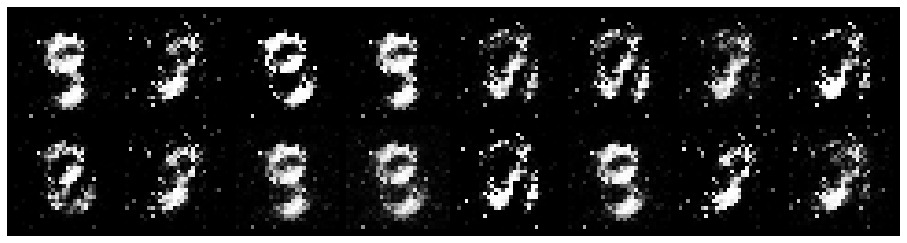

Epoch: [1/5] Batch: [2200/3750]
Loss_D: 0.7242586612701416 Loss_G: 0.8947135806083679
D(x): 0.6700480580329895 D(G(z)): 0.043764255940914154


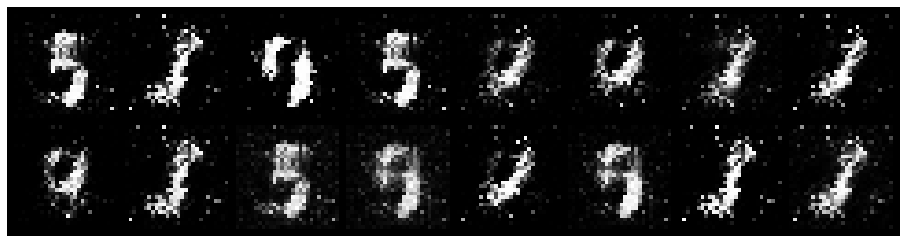

Epoch: [1/5] Batch: [2300/3750]
Loss_D: 1.0077203512191772 Loss_G: 6.9691877365112305
D(x): 0.9790492057800293 D(G(z)): 0.585246741771698


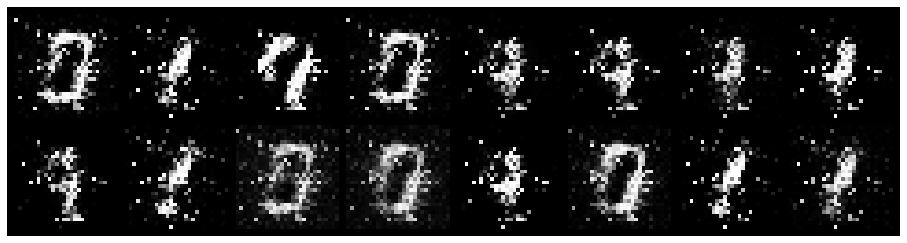

Epoch: [1/5] Batch: [2400/3750]
Loss_D: 0.24613197147846222 Loss_G: 3.976893424987793
D(x): 0.9097833633422852 D(G(z)): 0.12550128996372223


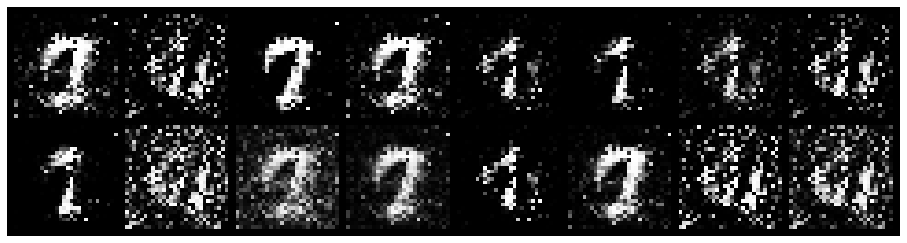

Epoch: [1/5] Batch: [2500/3750]
Loss_D: 0.5524873733520508 Loss_G: 2.983260154724121
D(x): 0.7661819458007812 D(G(z)): 0.15536019206047058


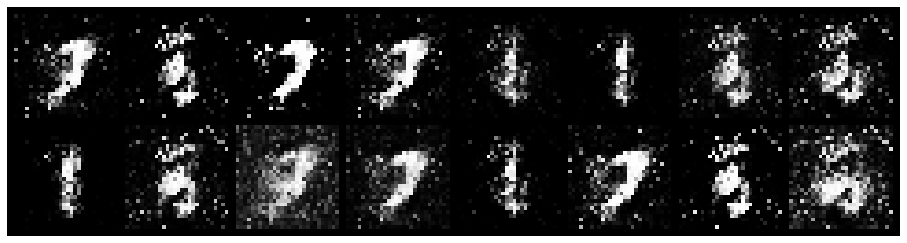

Epoch: [1/5] Batch: [2600/3750]
Loss_D: 0.5563446283340454 Loss_G: 2.9884743690490723
D(x): 0.7620269656181335 D(G(z)): 0.17815513908863068


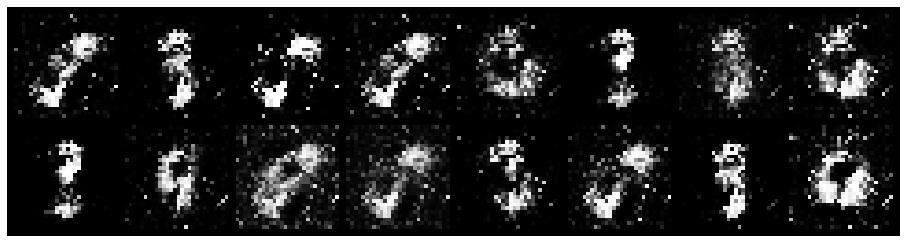

Epoch: [1/5] Batch: [2700/3750]
Loss_D: 0.8699547052383423 Loss_G: 1.3388676643371582
D(x): 0.6276843547821045 D(G(z)): 0.08725590258836746


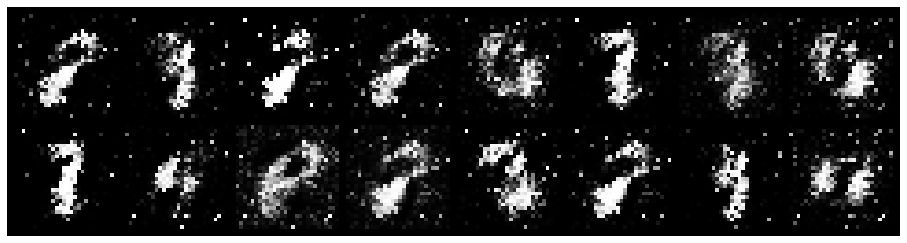

Epoch: [1/5] Batch: [2800/3750]
Loss_D: 0.8619374632835388 Loss_G: 2.8183605670928955
D(x): 0.8931309580802917 D(G(z)): 0.47106418013572693


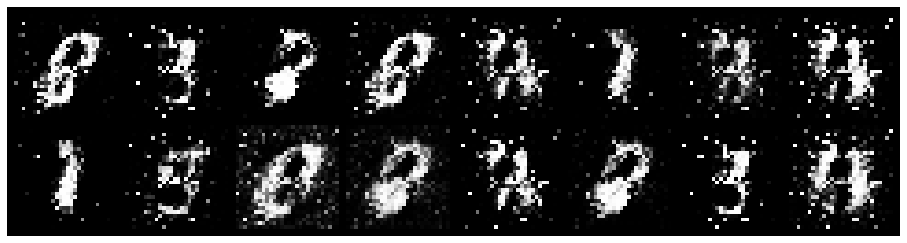

Epoch: [1/5] Batch: [2900/3750]
Loss_D: 0.8808172345161438 Loss_G: 1.2171146869659424
D(x): 0.5977994203567505 D(G(z)): 0.06787442415952682


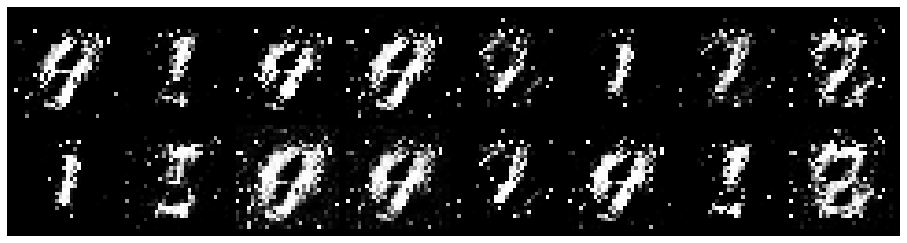

Epoch: [1/5] Batch: [3000/3750]
Loss_D: 1.0017144680023193 Loss_G: 2.182202100753784
D(x): 0.858111560344696 D(G(z)): 0.4338218569755554


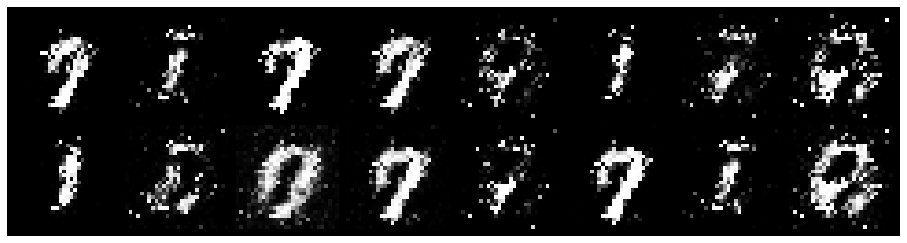

Epoch: [1/5] Batch: [3100/3750]
Loss_D: 0.6446989178657532 Loss_G: 2.6017704010009766
D(x): 0.793080747127533 D(G(z)): 0.21729327738285065


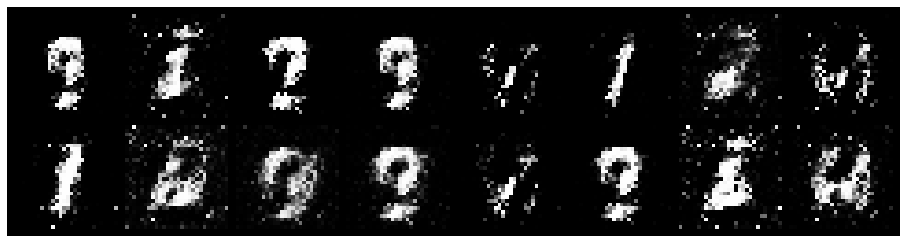

Epoch: [1/5] Batch: [3200/3750]
Loss_D: 0.6546566486358643 Loss_G: 2.4896388053894043
D(x): 0.6715965270996094 D(G(z)): 0.04972367361187935


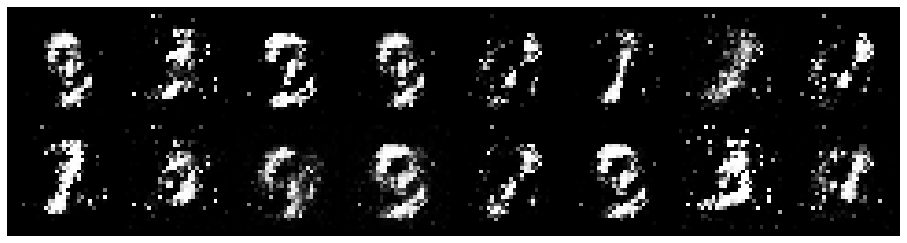

Epoch: [1/5] Batch: [3300/3750]
Loss_D: 0.38105568289756775 Loss_G: 2.0443270206451416
D(x): 0.8891888856887817 D(G(z)): 0.20505014061927795


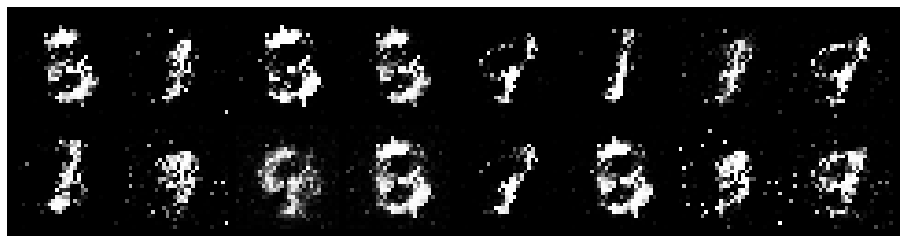

Epoch: [1/5] Batch: [3400/3750]
Loss_D: 0.45129138231277466 Loss_G: 3.548844814300537
D(x): 0.890641450881958 D(G(z)): 0.18406346440315247


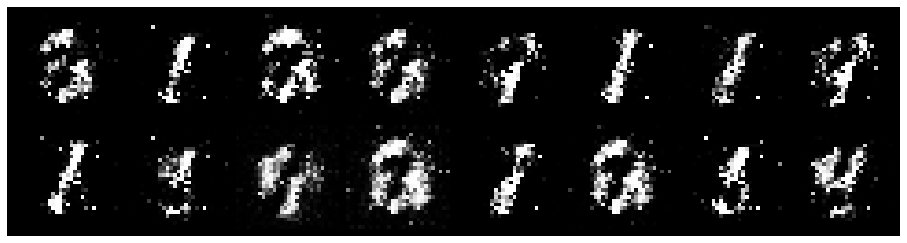

Epoch: [1/5] Batch: [3500/3750]
Loss_D: 0.8007331490516663 Loss_G: 1.2922557592391968
D(x): 0.7143857479095459 D(G(z)): 0.2598332166671753


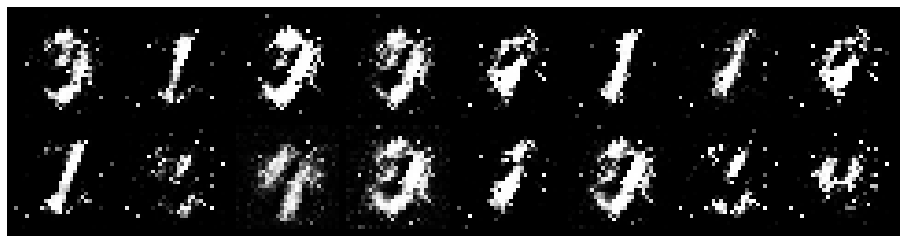

Epoch: [1/5] Batch: [3600/3750]
Loss_D: 0.4679803252220154 Loss_G: 2.5867276191711426
D(x): 0.8378516435623169 D(G(z)): 0.17820654809474945


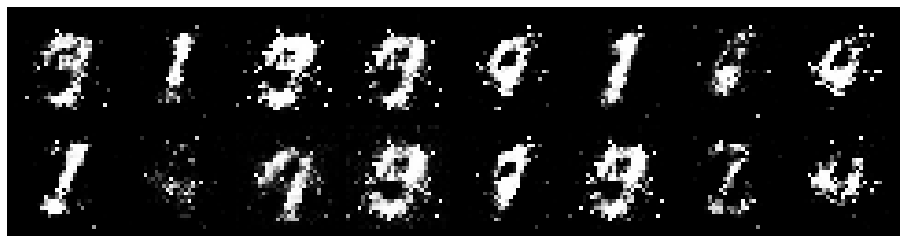

Epoch: [1/5] Batch: [3700/3750]
Loss_D: 0.25066131353378296 Loss_G: 2.312731981277466
D(x): 0.8814640045166016 D(G(z)): 0.09253045916557312


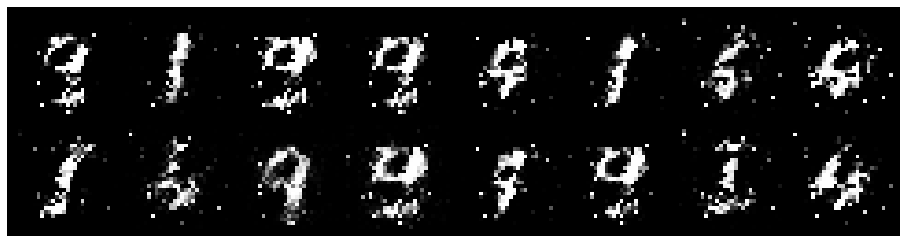

----------------------------------------
Epoch: [2/5] Batch: [0/3750]
Loss_D: 1.2160844802856445 Loss_G: 1.7790746688842773
D(x): 0.533889889717102 D(G(z)): 0.10795262455940247


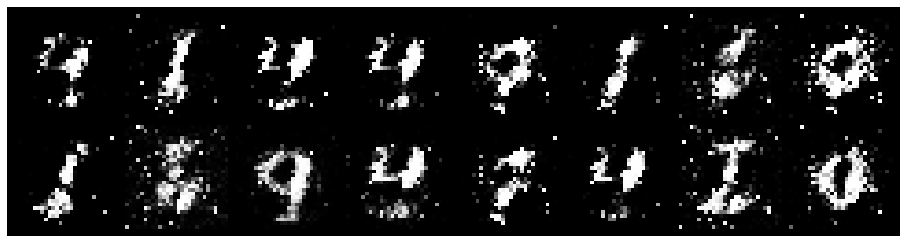

Epoch: [2/5] Batch: [100/3750]
Loss_D: 1.0619542598724365 Loss_G: 2.216501235961914
D(x): 0.6401568651199341 D(G(z)): 0.08164211362600327


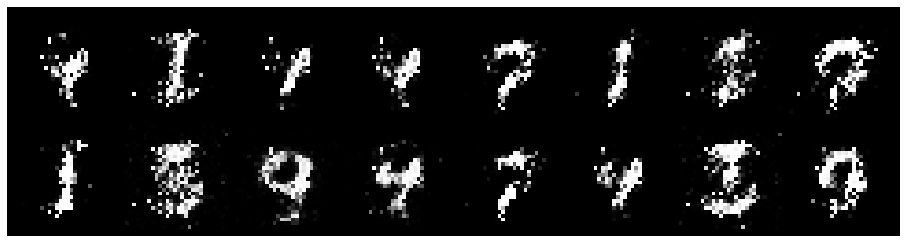

Epoch: [2/5] Batch: [200/3750]
Loss_D: 0.4083465039730072 Loss_G: 2.009810209274292
D(x): 0.8625576496124268 D(G(z)): 0.1850433647632599


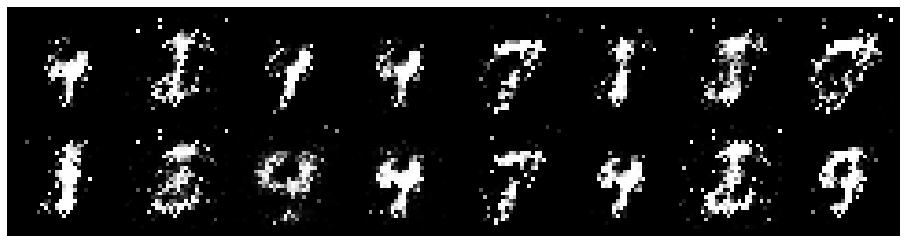

Epoch: [2/5] Batch: [300/3750]
Loss_D: 0.9537942409515381 Loss_G: 0.9993329048156738
D(x): 0.5984557271003723 D(G(z)): 0.08520442247390747


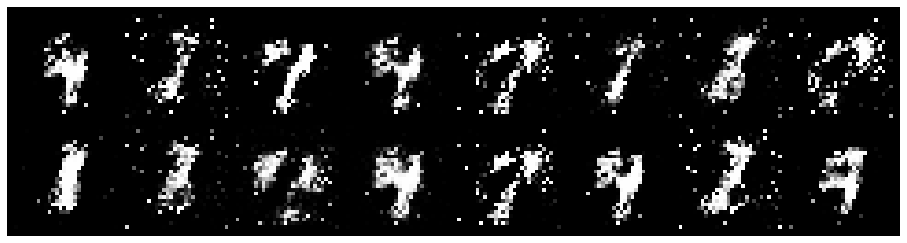

Epoch: [2/5] Batch: [400/3750]
Loss_D: 0.7062308192253113 Loss_G: 3.7090744972229004
D(x): 0.8907681107521057 D(G(z)): 0.3957473039627075


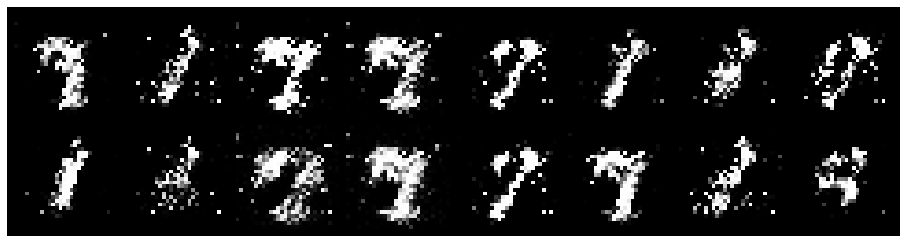

Epoch: [2/5] Batch: [500/3750]
Loss_D: 0.7221945524215698 Loss_G: 2.069086790084839
D(x): 0.8013015389442444 D(G(z)): 0.28283536434173584


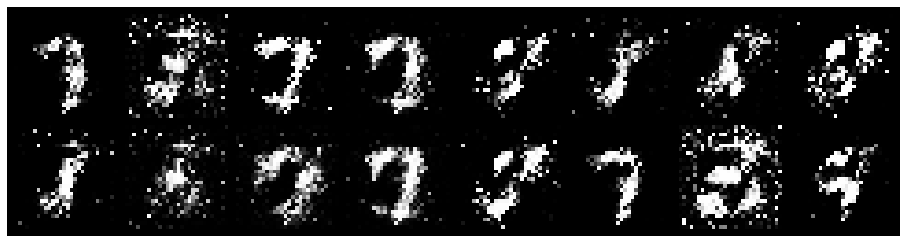

Epoch: [2/5] Batch: [600/3750]
Loss_D: 0.4769378900527954 Loss_G: 2.541468620300293
D(x): 0.8032900094985962 D(G(z)): 0.17227931320667267


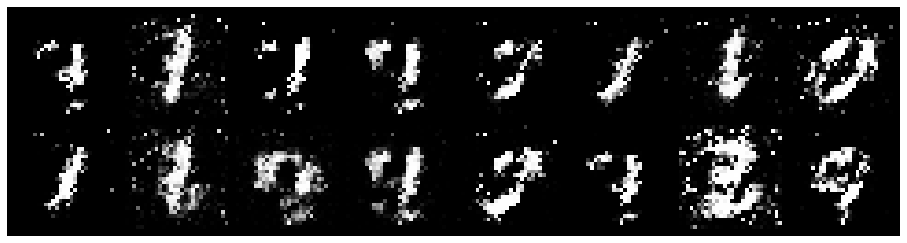

Epoch: [2/5] Batch: [700/3750]
Loss_D: 0.5619454979896545 Loss_G: 1.4635242223739624
D(x): 0.7297134399414062 D(G(z)): 0.1458590030670166


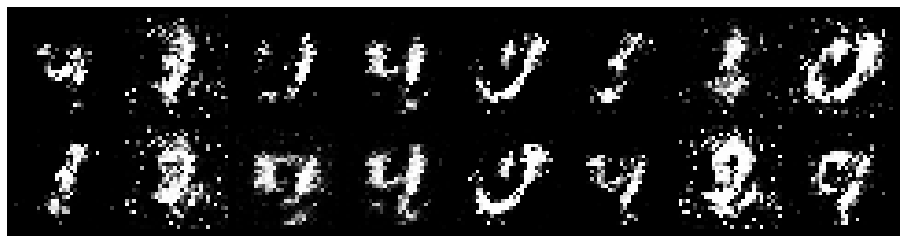

Epoch: [2/5] Batch: [800/3750]
Loss_D: 0.5023359656333923 Loss_G: 0.9796305894851685
D(x): 0.7687631845474243 D(G(z)): 0.08361248672008514


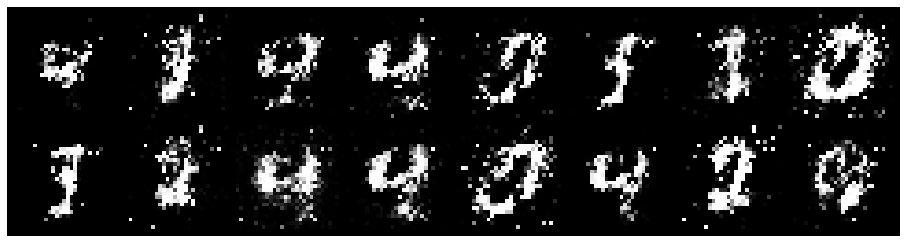

Epoch: [2/5] Batch: [900/3750]
Loss_D: 1.0615379810333252 Loss_G: 1.6951472759246826
D(x): 0.5978196859359741 D(G(z)): 0.05323361977934837


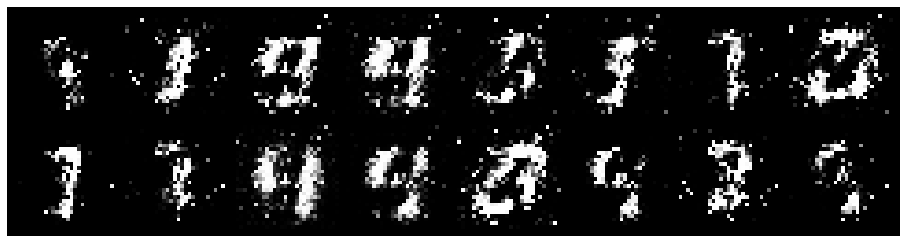

Epoch: [2/5] Batch: [1000/3750]
Loss_D: 0.7247797250747681 Loss_G: 1.51759934425354
D(x): 0.7210654020309448 D(G(z)): 0.15472471714019775


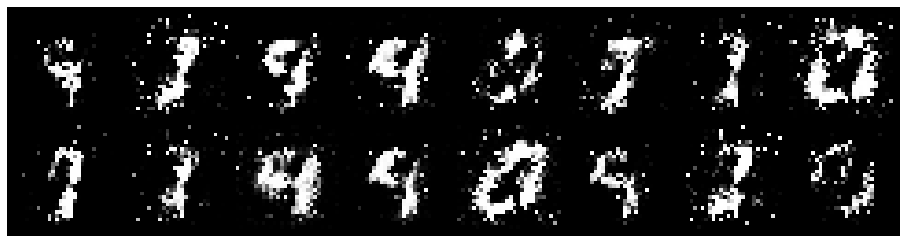

Epoch: [2/5] Batch: [1100/3750]
Loss_D: 0.36073780059814453 Loss_G: 3.768004894256592
D(x): 0.775543749332428 D(G(z)): 0.027499614283442497


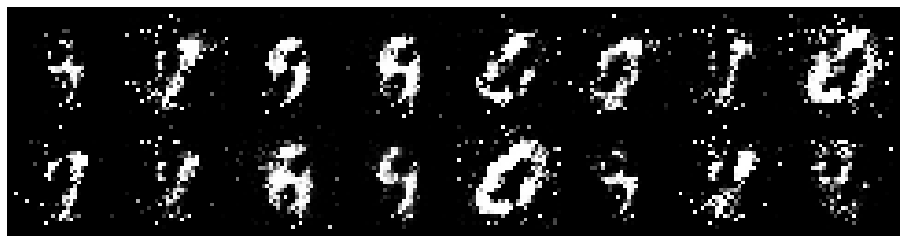

Epoch: [2/5] Batch: [1200/3750]
Loss_D: 0.4947998821735382 Loss_G: 2.147611141204834
D(x): 0.7688010931015015 D(G(z)): 0.13725224137306213


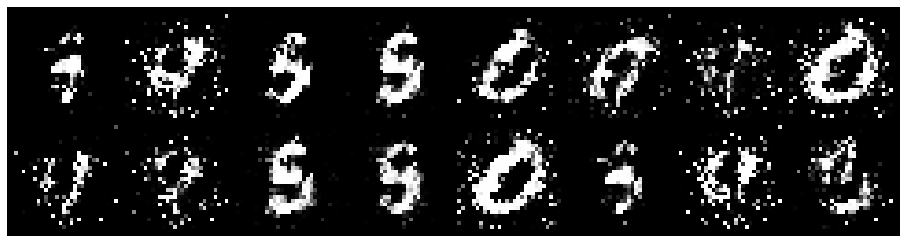

Epoch: [2/5] Batch: [1300/3750]
Loss_D: 0.5771486759185791 Loss_G: 4.724306106567383
D(x): 0.9273757934570312 D(G(z)): 0.33636602759361267


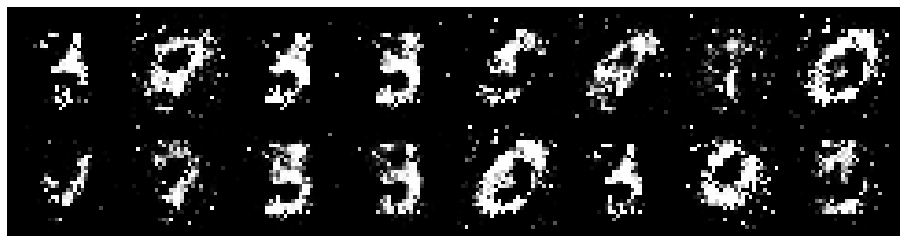

Epoch: [2/5] Batch: [1400/3750]
Loss_D: 0.7303359508514404 Loss_G: 2.622910261154175
D(x): 0.7076159715652466 D(G(z)): 0.21586376428604126


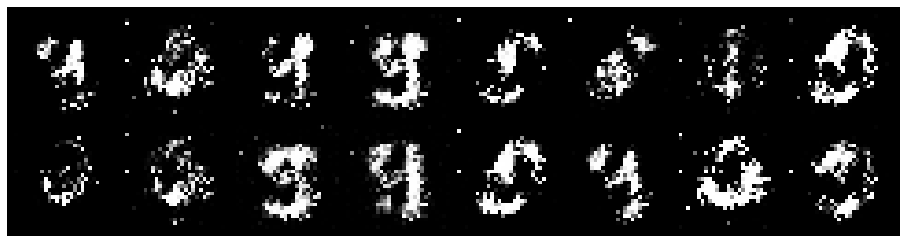

Epoch: [2/5] Batch: [1500/3750]
Loss_D: 0.32456910610198975 Loss_G: 3.250985622406006
D(x): 0.859222412109375 D(G(z)): 0.12004680931568146


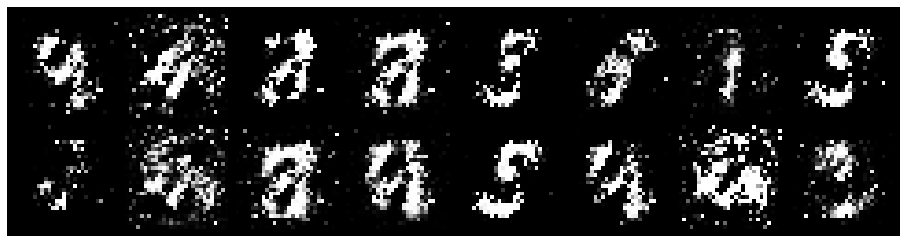

Epoch: [2/5] Batch: [1600/3750]
Loss_D: 0.5773791670799255 Loss_G: 3.5601954460144043
D(x): 0.8397641777992249 D(G(z)): 0.27875158190727234


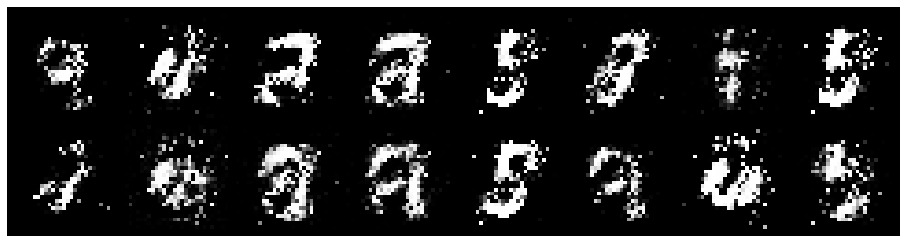

Epoch: [2/5] Batch: [1700/3750]
Loss_D: 0.7437533140182495 Loss_G: 1.1835613250732422
D(x): 0.6458871364593506 D(G(z)): 0.12731122970581055


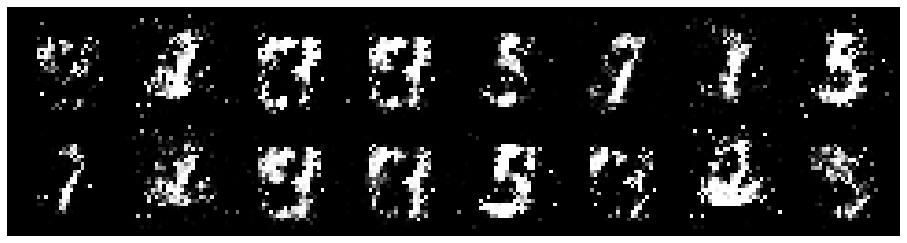

Epoch: [2/5] Batch: [1800/3750]
Loss_D: 0.540947437286377 Loss_G: 3.177158832550049
D(x): 0.8696523308753967 D(G(z)): 0.2436290830373764


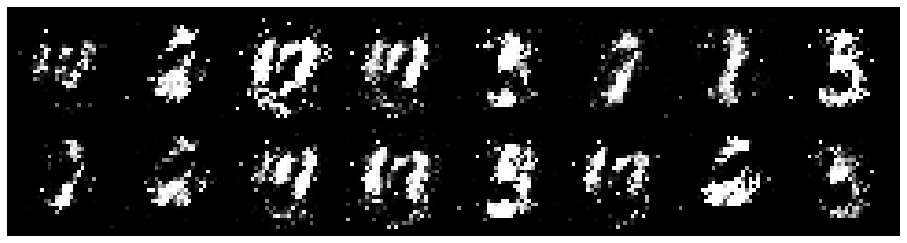

Epoch: [2/5] Batch: [1900/3750]
Loss_D: 1.1841310262680054 Loss_G: 1.6947660446166992
D(x): 0.6621968746185303 D(G(z)): 0.2859870195388794


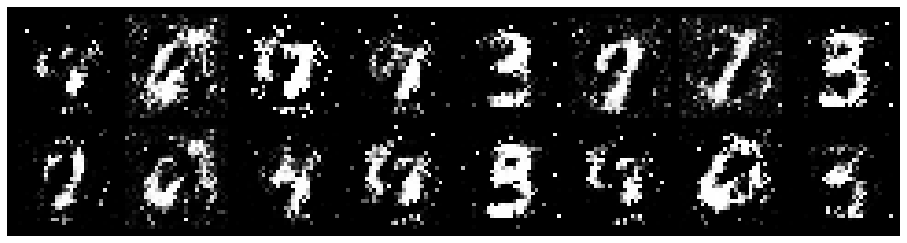

Epoch: [2/5] Batch: [2000/3750]
Loss_D: 0.7113708853721619 Loss_G: 1.96483314037323
D(x): 0.7769755125045776 D(G(z)): 0.21718454360961914


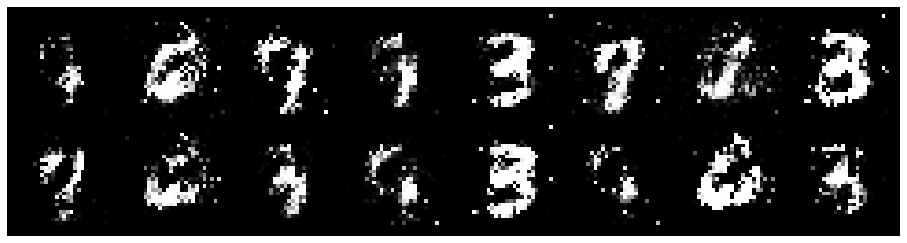

Epoch: [2/5] Batch: [2100/3750]
Loss_D: 0.6575916409492493 Loss_G: 1.8804762363433838
D(x): 0.6915197968482971 D(G(z)): 0.13427752256393433


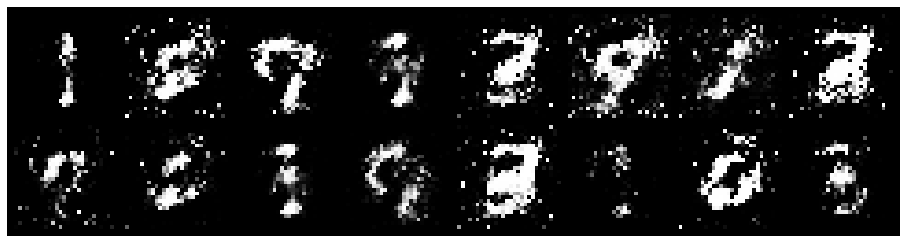

Epoch: [2/5] Batch: [2200/3750]
Loss_D: 0.7096905708312988 Loss_G: 1.7440966367721558
D(x): 0.7219030857086182 D(G(z)): 0.2016735076904297


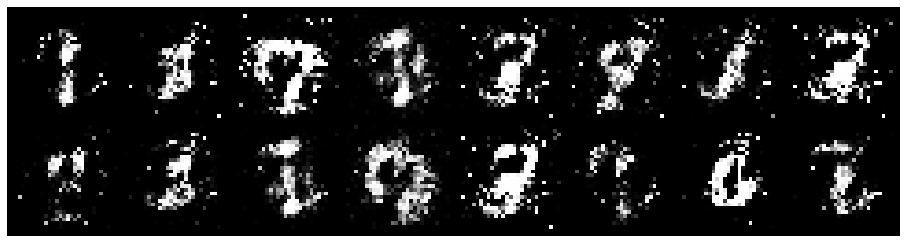

Epoch: [2/5] Batch: [2300/3750]
Loss_D: 0.5177815556526184 Loss_G: 1.9269747734069824
D(x): 0.7691860795021057 D(G(z)): 0.18555915355682373


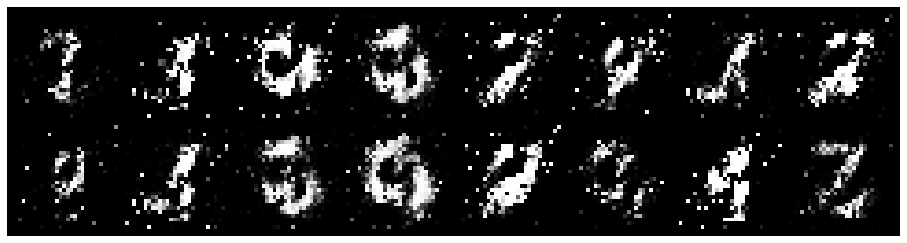

Epoch: [2/5] Batch: [2400/3750]
Loss_D: 0.95787113904953 Loss_G: 2.529407262802124
D(x): 0.9221645593643188 D(G(z)): 0.5259883403778076


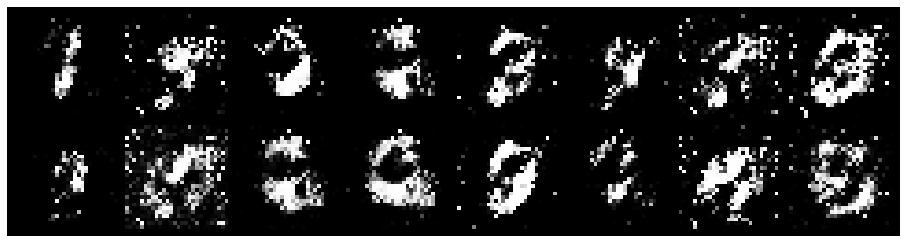

Epoch: [2/5] Batch: [2500/3750]
Loss_D: 0.6970725059509277 Loss_G: 1.45054030418396
D(x): 0.6668849587440491 D(G(z)): 0.08829392492771149


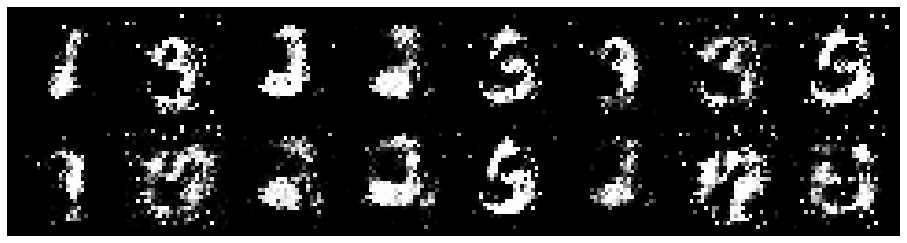

Epoch: [2/5] Batch: [2600/3750]
Loss_D: 0.7981674671173096 Loss_G: 2.429265022277832
D(x): 0.7123497724533081 D(G(z)): 0.19652578234672546


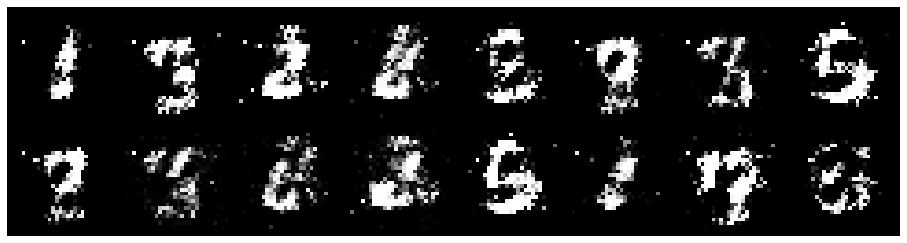

Epoch: [2/5] Batch: [2700/3750]
Loss_D: 0.5094343423843384 Loss_G: 3.2153618335723877
D(x): 0.8232123851776123 D(G(z)): 0.18901249766349792


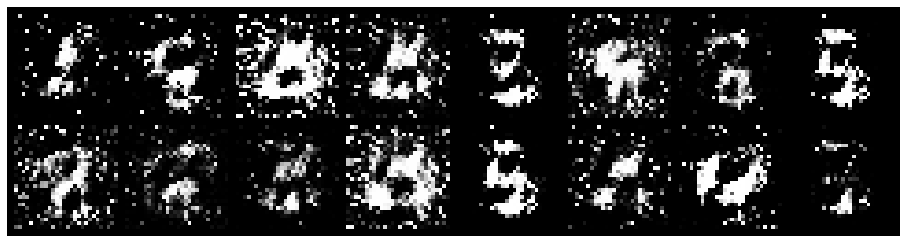

Epoch: [2/5] Batch: [2800/3750]
Loss_D: 0.4586455225944519 Loss_G: 2.9918391704559326
D(x): 0.8845947980880737 D(G(z)): 0.23484256863594055


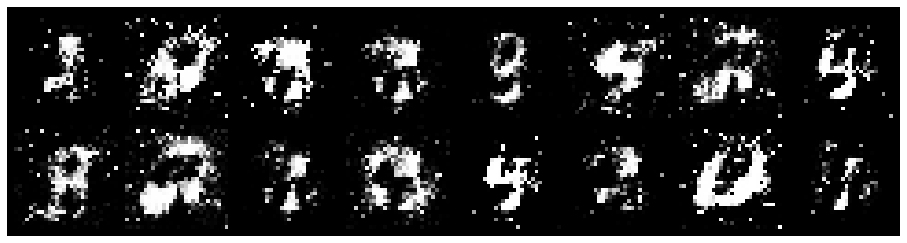

Epoch: [2/5] Batch: [2900/3750]
Loss_D: 1.0061395168304443 Loss_G: 1.4365713596343994
D(x): 0.6465122699737549 D(G(z)): 0.2129577398300171


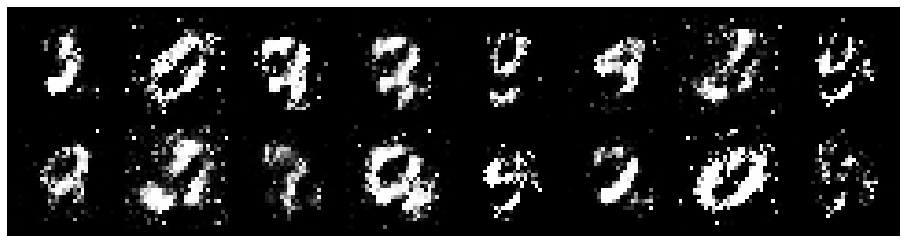

Epoch: [2/5] Batch: [3000/3750]
Loss_D: 0.8734467029571533 Loss_G: 1.3370530605316162
D(x): 0.6578328609466553 D(G(z)): 0.2627065181732178


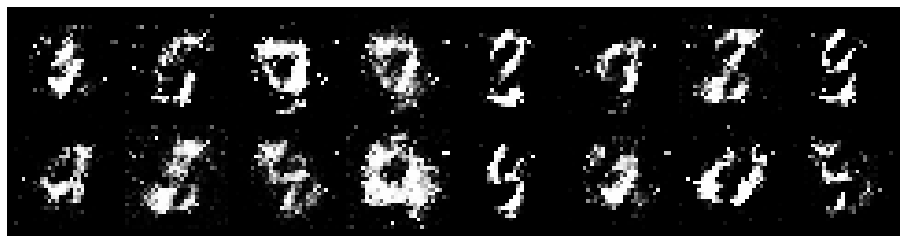

Epoch: [2/5] Batch: [3100/3750]
Loss_D: 0.659437894821167 Loss_G: 2.3122589588165283
D(x): 0.8148396611213684 D(G(z)): 0.31872430443763733


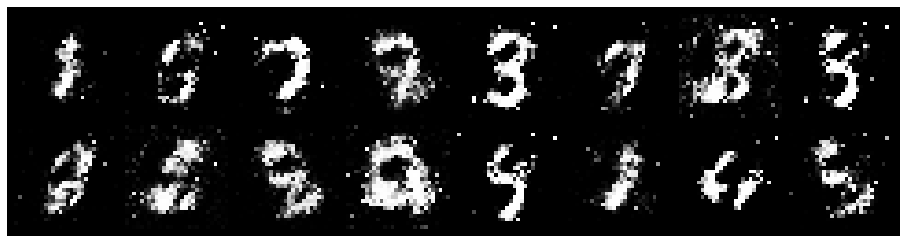

Epoch: [2/5] Batch: [3200/3750]
Loss_D: 0.8775044679641724 Loss_G: 1.765028953552246
D(x): 0.7362180948257446 D(G(z)): 0.3150372803211212


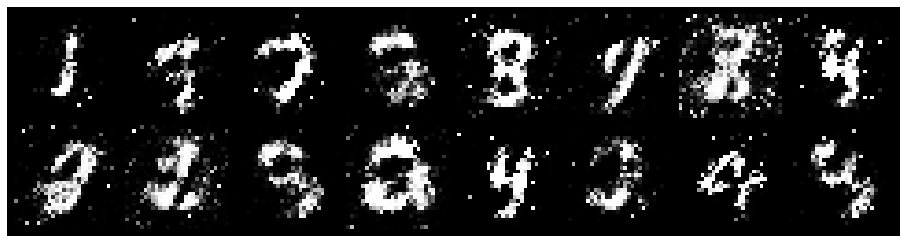

Epoch: [2/5] Batch: [3300/3750]
Loss_D: 0.9806310534477234 Loss_G: 1.1213207244873047
D(x): 0.6679661870002747 D(G(z)): 0.23850010335445404


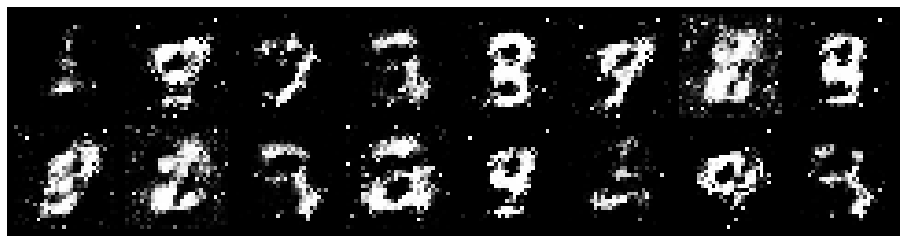

Epoch: [2/5] Batch: [3400/3750]
Loss_D: 0.9766706228256226 Loss_G: 1.0655360221862793
D(x): 0.6092410087585449 D(G(z)): 0.24453967809677124


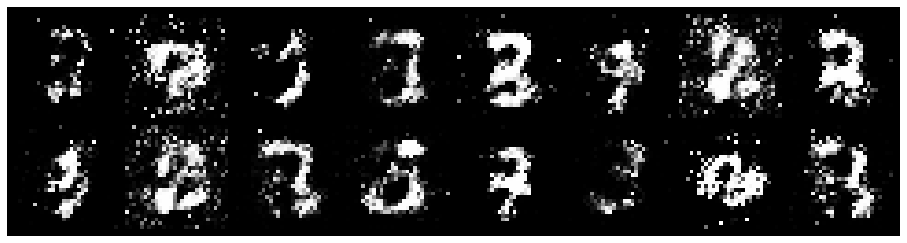

Epoch: [2/5] Batch: [3500/3750]
Loss_D: 0.7562574148178101 Loss_G: 2.346952438354492
D(x): 0.801232099533081 D(G(z)): 0.3540860414505005


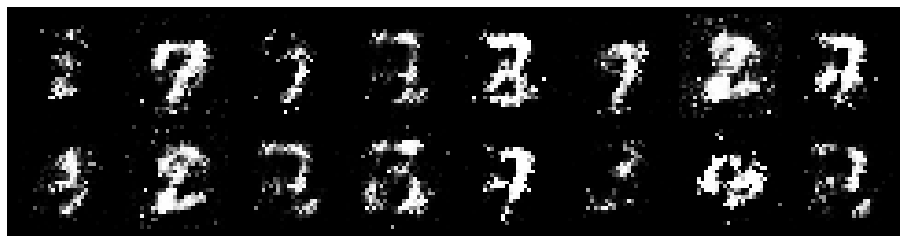

Epoch: [2/5] Batch: [3600/3750]
Loss_D: 0.8977911472320557 Loss_G: 1.639215111732483
D(x): 0.7377320528030396 D(G(z)): 0.34486666321754456


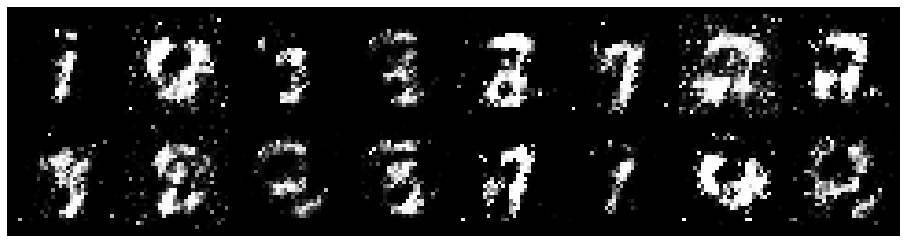

Epoch: [2/5] Batch: [3700/3750]
Loss_D: 0.8074268102645874 Loss_G: 1.829686164855957
D(x): 0.7477214336395264 D(G(z)): 0.31558990478515625


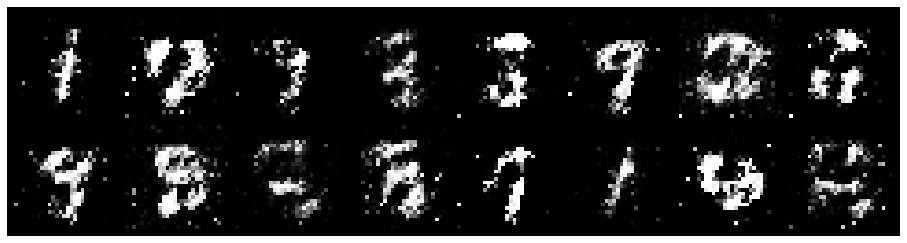

----------------------------------------
Epoch: [3/5] Batch: [0/3750]
Loss_D: 0.9545583724975586 Loss_G: 2.1682398319244385
D(x): 0.6098464727401733 D(G(z)): 0.22317920625209808


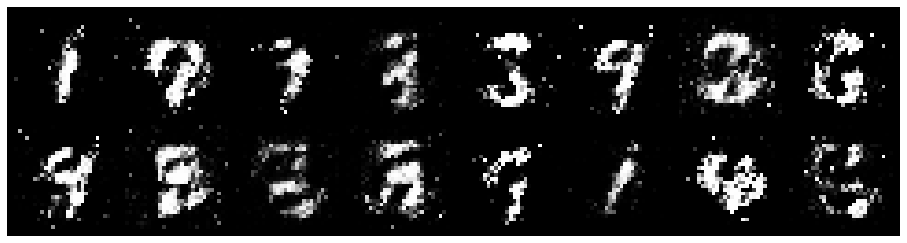

Epoch: [3/5] Batch: [100/3750]
Loss_D: 0.9244916439056396 Loss_G: 1.4894721508026123
D(x): 0.6038554310798645 D(G(z)): 0.19065603613853455


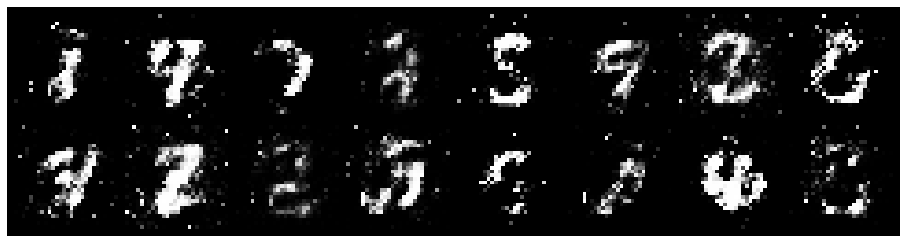

Epoch: [3/5] Batch: [200/3750]
Loss_D: 1.109462022781372 Loss_G: 1.0745325088500977
D(x): 0.5576533079147339 D(G(z)): 0.27575528621673584


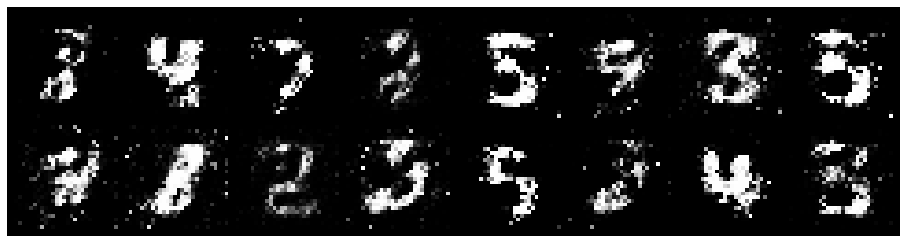

Epoch: [3/5] Batch: [300/3750]
Loss_D: 0.8124351501464844 Loss_G: 2.271674156188965
D(x): 0.9000648856163025 D(G(z)): 0.45207682251930237


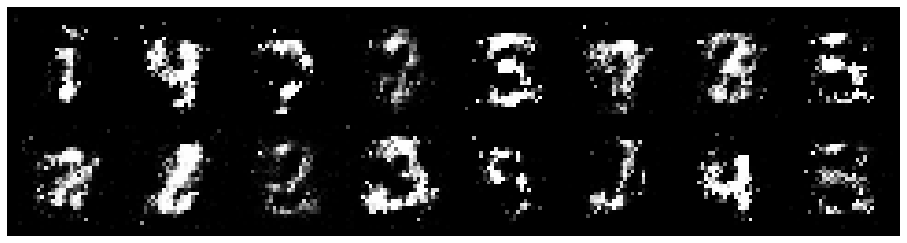

Epoch: [3/5] Batch: [400/3750]
Loss_D: 1.1688278913497925 Loss_G: 1.0178896188735962
D(x): 0.6021542549133301 D(G(z)): 0.40366634726524353


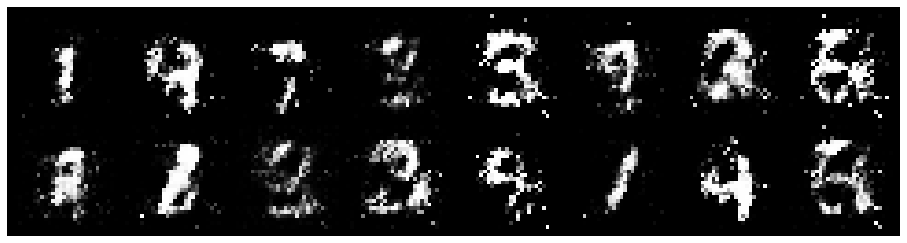

Epoch: [3/5] Batch: [500/3750]
Loss_D: 0.7711817622184753 Loss_G: 1.6192423105239868
D(x): 0.6959067583084106 D(G(z)): 0.19857951998710632


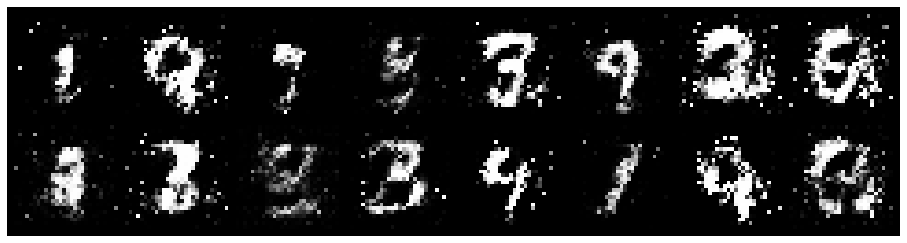

Epoch: [3/5] Batch: [600/3750]
Loss_D: 0.9292067289352417 Loss_G: 1.7503085136413574
D(x): 0.6655430793762207 D(G(z)): 0.2938627600669861


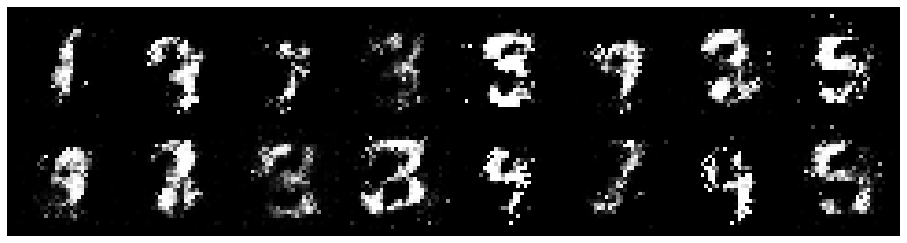

Epoch: [3/5] Batch: [700/3750]
Loss_D: 0.5783443450927734 Loss_G: 2.2289600372314453
D(x): 0.8558998703956604 D(G(z)): 0.30192381143569946


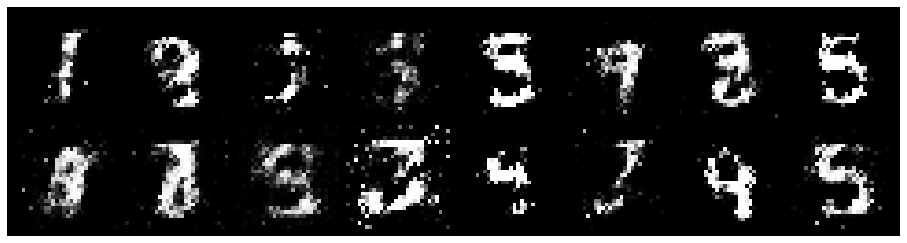

Epoch: [3/5] Batch: [800/3750]
Loss_D: 0.8384085893630981 Loss_G: 1.1591583490371704
D(x): 0.6611310243606567 D(G(z)): 0.2846316695213318


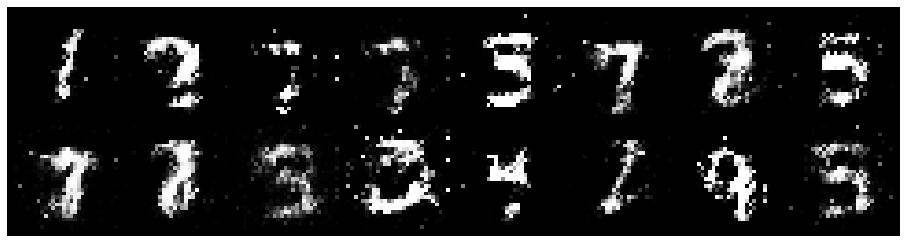

Epoch: [3/5] Batch: [900/3750]
Loss_D: 0.8419735431671143 Loss_G: 1.9569156169891357
D(x): 0.7520923018455505 D(G(z)): 0.39076370000839233


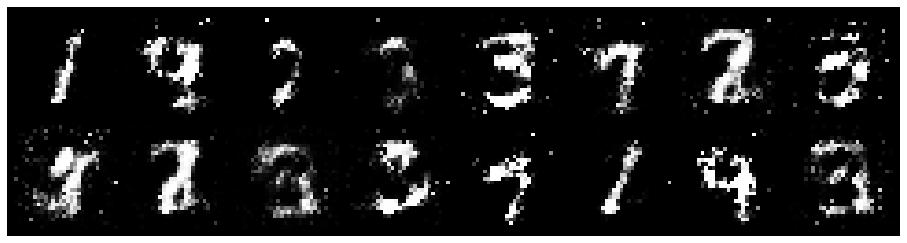

Epoch: [3/5] Batch: [1000/3750]
Loss_D: 0.9507550001144409 Loss_G: 1.4949426651000977
D(x): 0.7091128826141357 D(G(z)): 0.38661330938339233


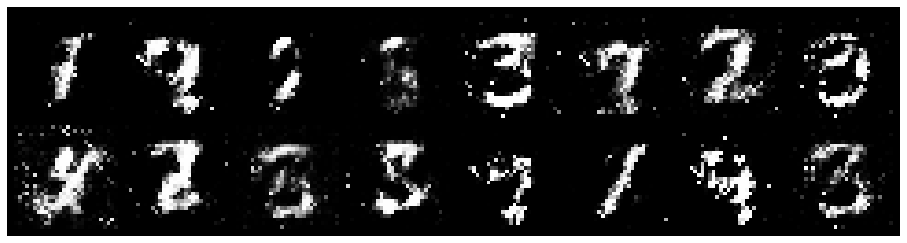

Epoch: [3/5] Batch: [1100/3750]
Loss_D: 1.09375 Loss_G: 1.151793360710144
D(x): 0.6532747149467468 D(G(z)): 0.4010143578052521


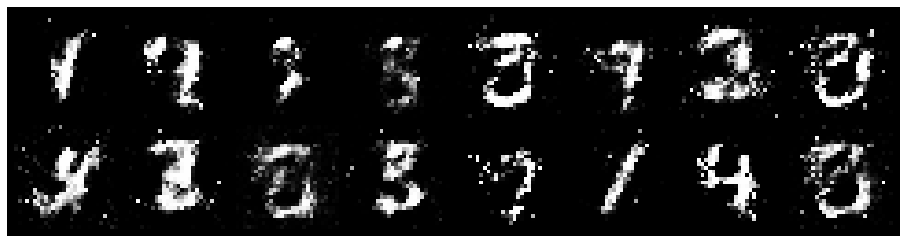

Epoch: [3/5] Batch: [1200/3750]
Loss_D: 0.9453729391098022 Loss_G: 1.8078192472457886
D(x): 0.6629625558853149 D(G(z)): 0.3533119857311249


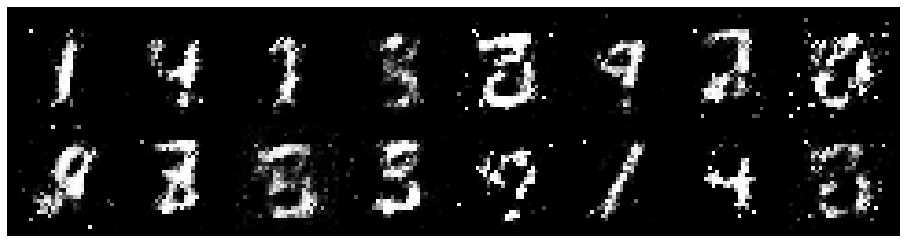

Epoch: [3/5] Batch: [1300/3750]
Loss_D: 0.9028444886207581 Loss_G: 1.3611087799072266
D(x): 0.629218339920044 D(G(z)): 0.2886006236076355


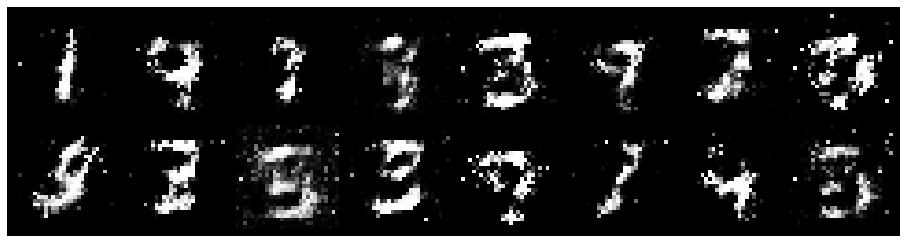

Epoch: [3/5] Batch: [1400/3750]
Loss_D: 1.2790566682815552 Loss_G: 0.6701629757881165
D(x): 0.47071123123168945 D(G(z)): 0.2564641833305359


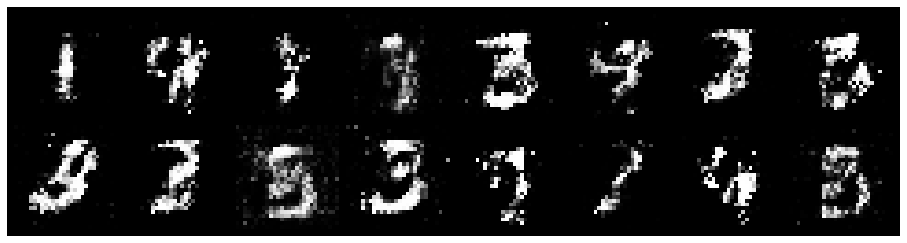

Epoch: [3/5] Batch: [1500/3750]
Loss_D: 0.7882102727890015 Loss_G: 1.547081708908081
D(x): 0.7069101333618164 D(G(z)): 0.2989366054534912


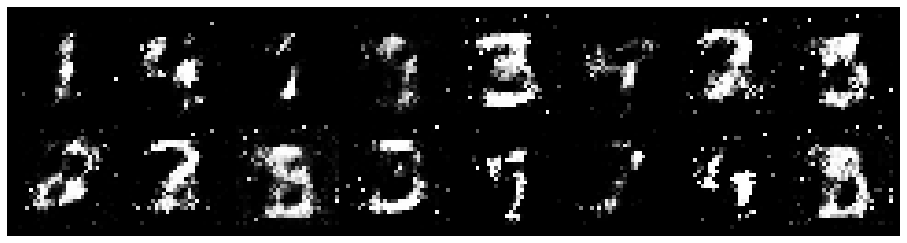

Epoch: [3/5] Batch: [1600/3750]
Loss_D: 1.0660934448242188 Loss_G: 1.9744017124176025
D(x): 0.8321555256843567 D(G(z)): 0.5498059988021851


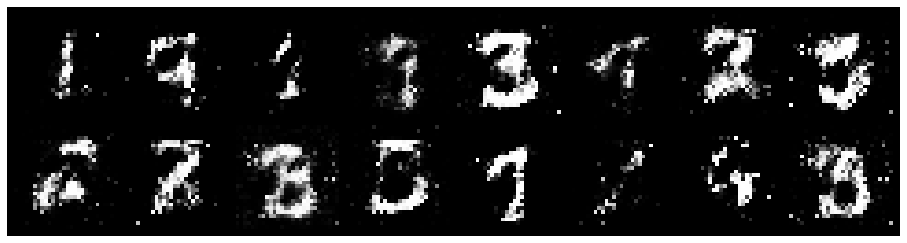

Epoch: [3/5] Batch: [1700/3750]
Loss_D: 1.1106396913528442 Loss_G: 0.9974441528320312
D(x): 0.5343801975250244 D(G(z)): 0.2848197817802429


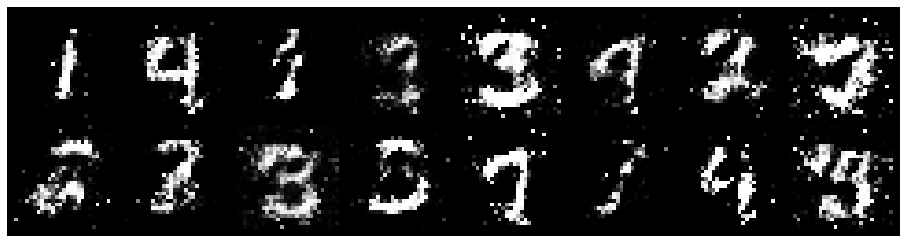

Epoch: [3/5] Batch: [1800/3750]
Loss_D: 1.1524701118469238 Loss_G: 1.0089995861053467
D(x): 0.7111214399337769 D(G(z)): 0.47324711084365845


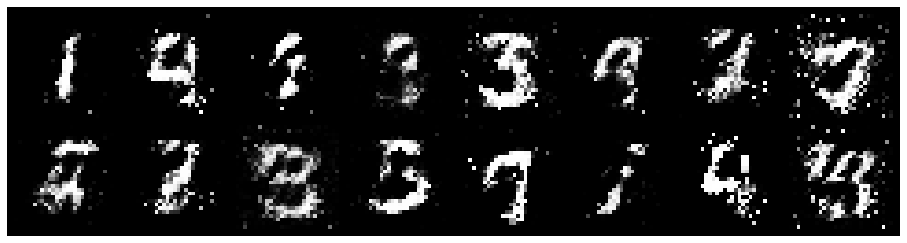

Epoch: [3/5] Batch: [1900/3750]
Loss_D: 0.8850246667861938 Loss_G: 1.6465222835540771
D(x): 0.7796527147293091 D(G(z)): 0.4202632009983063


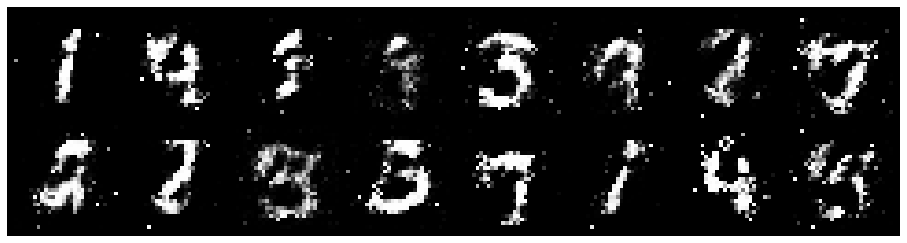

Epoch: [3/5] Batch: [2000/3750]
Loss_D: 1.0960220098495483 Loss_G: 1.380740761756897
D(x): 0.6265688538551331 D(G(z)): 0.3971601724624634


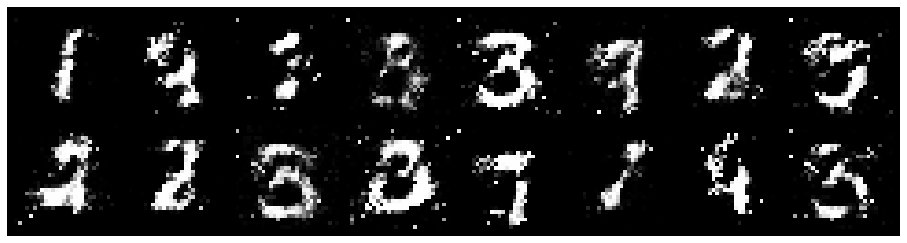

Epoch: [3/5] Batch: [2100/3750]
Loss_D: 1.0263428688049316 Loss_G: 1.5576218366622925
D(x): 0.621803343296051 D(G(z)): 0.3413645625114441


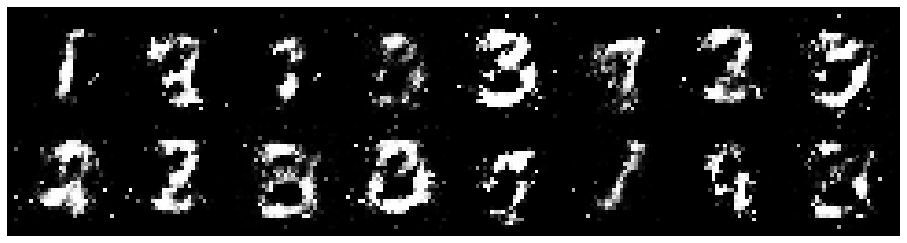

Epoch: [3/5] Batch: [2200/3750]
Loss_D: 0.9094856977462769 Loss_G: 1.058996558189392
D(x): 0.6318890452384949 D(G(z)): 0.2910962402820587


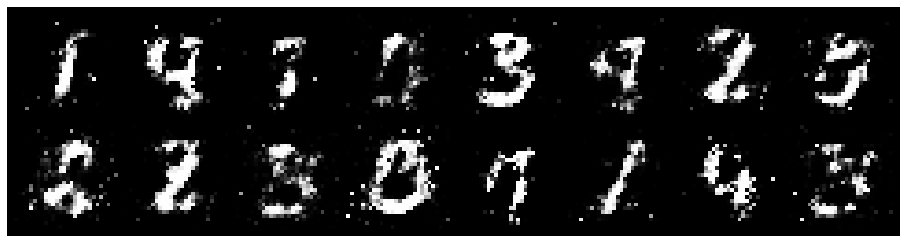

Epoch: [3/5] Batch: [2300/3750]
Loss_D: 1.116882085800171 Loss_G: 0.8213475942611694
D(x): 0.7266063690185547 D(G(z)): 0.4618009626865387


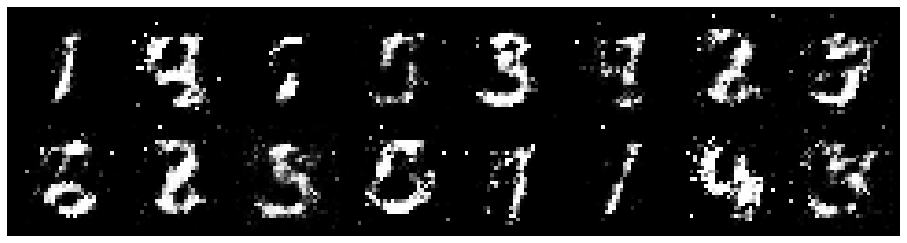

Epoch: [3/5] Batch: [2400/3750]
Loss_D: 0.9439738988876343 Loss_G: 1.376558542251587
D(x): 0.6430761218070984 D(G(z)): 0.30569779872894287


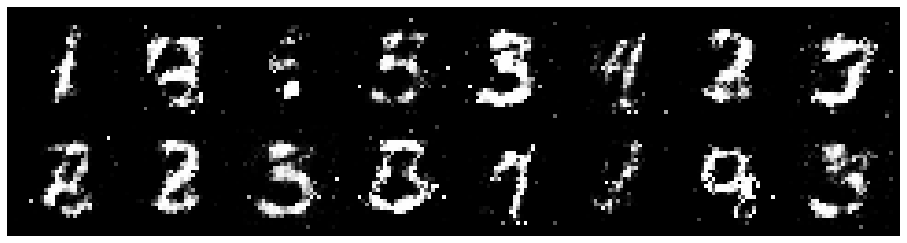

Epoch: [3/5] Batch: [2500/3750]
Loss_D: 1.3222910165786743 Loss_G: 0.9576181769371033
D(x): 0.47969377040863037 D(G(z)): 0.25773417949676514


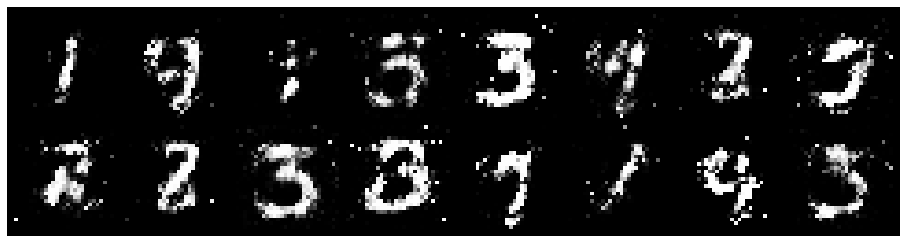

Epoch: [3/5] Batch: [2600/3750]
Loss_D: 1.256058931350708 Loss_G: 1.1130032539367676
D(x): 0.5089435577392578 D(G(z)): 0.3099077343940735


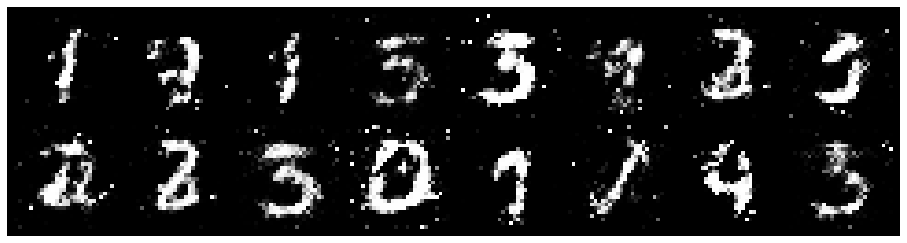

Epoch: [3/5] Batch: [2700/3750]
Loss_D: 0.9967834949493408 Loss_G: 1.5960524082183838
D(x): 0.5742990970611572 D(G(z)): 0.28470075130462646


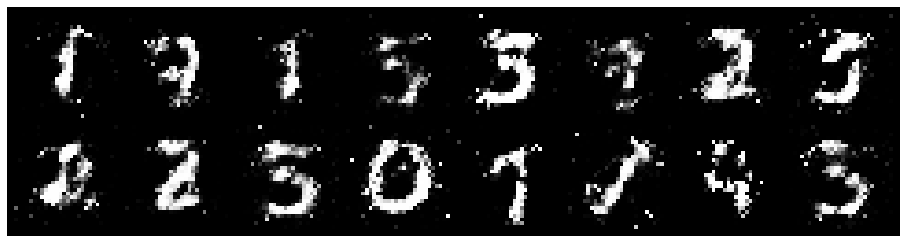

Epoch: [3/5] Batch: [2800/3750]
Loss_D: 1.171868085861206 Loss_G: 1.7585883140563965
D(x): 0.6393247842788696 D(G(z)): 0.46588826179504395


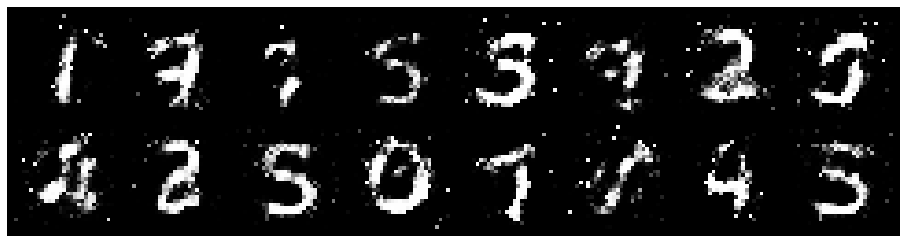

Epoch: [3/5] Batch: [2900/3750]
Loss_D: 0.8893391489982605 Loss_G: 1.321612000465393
D(x): 0.6546705365180969 D(G(z)): 0.29997336864471436


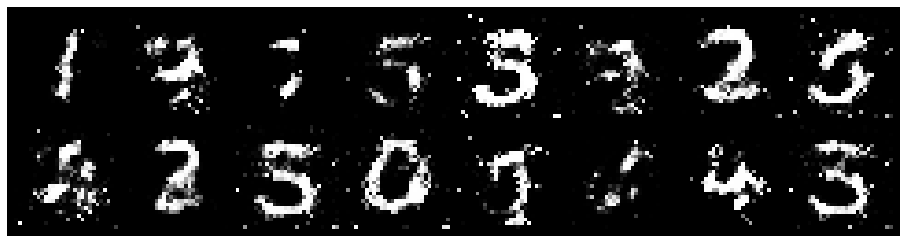

Epoch: [3/5] Batch: [3000/3750]
Loss_D: 1.100192666053772 Loss_G: 1.2153995037078857
D(x): 0.6865445375442505 D(G(z)): 0.47261038422584534


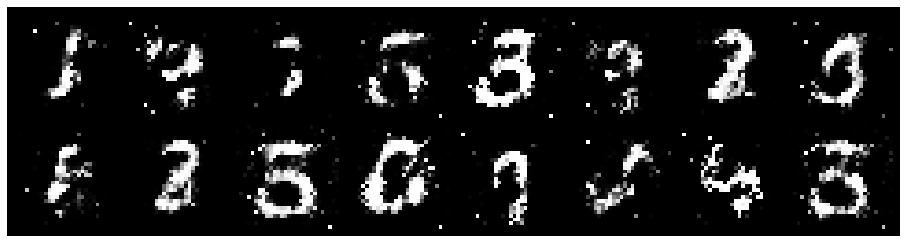

Epoch: [3/5] Batch: [3100/3750]
Loss_D: 1.4516973495483398 Loss_G: 1.702375888824463
D(x): 0.7115362286567688 D(G(z)): 0.6056511402130127


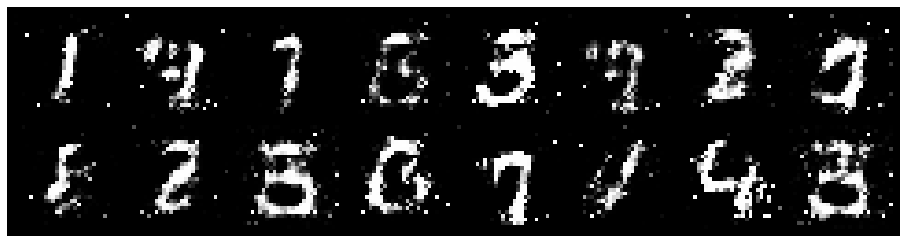

Epoch: [3/5] Batch: [3200/3750]
Loss_D: 1.0938198566436768 Loss_G: 0.8765871524810791
D(x): 0.6189495921134949 D(G(z)): 0.4046052098274231


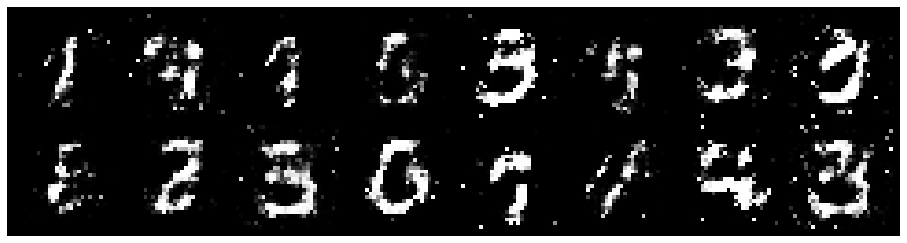

Epoch: [3/5] Batch: [3300/3750]
Loss_D: 1.0105862617492676 Loss_G: 1.2431272268295288
D(x): 0.6567846536636353 D(G(z)): 0.37401214241981506


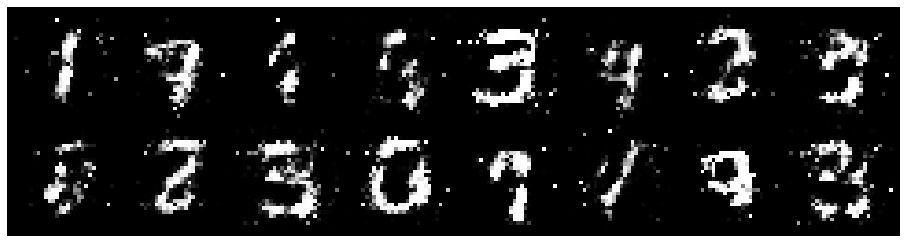

Epoch: [3/5] Batch: [3400/3750]
Loss_D: 1.19153892993927 Loss_G: 1.1183704137802124
D(x): 0.4409646987915039 D(G(z)): 0.21721938252449036


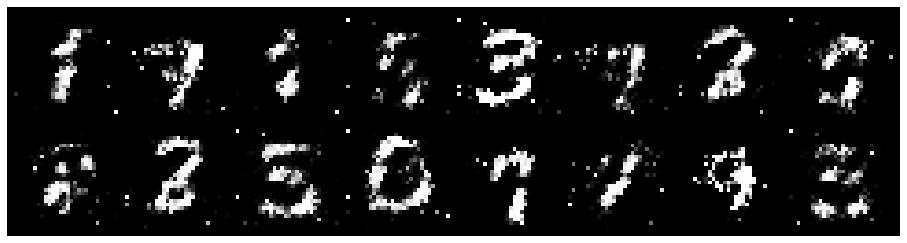

Epoch: [3/5] Batch: [3500/3750]
Loss_D: 1.320372223854065 Loss_G: 0.9007183313369751
D(x): 0.5951603651046753 D(G(z)): 0.41954904794692993


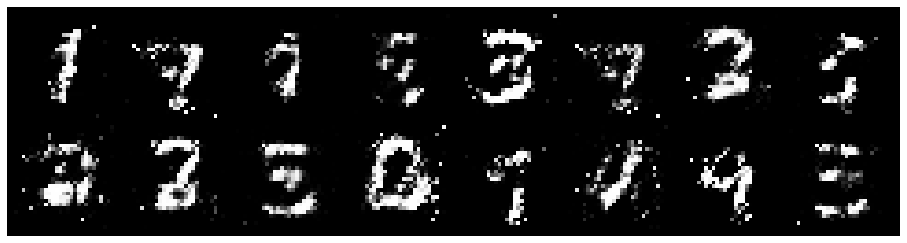

Epoch: [3/5] Batch: [3600/3750]
Loss_D: 0.9037429094314575 Loss_G: 1.1519811153411865
D(x): 0.6568506956100464 D(G(z)): 0.33548080921173096


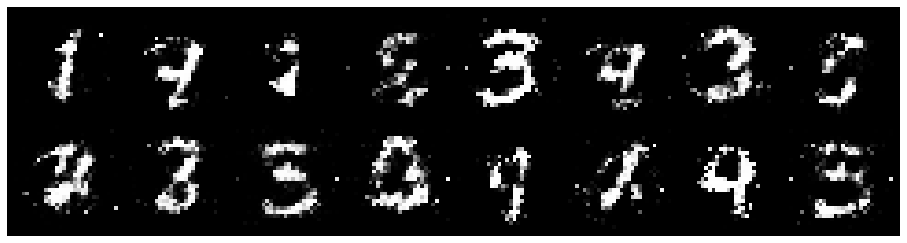

Epoch: [3/5] Batch: [3700/3750]
Loss_D: 1.0615599155426025 Loss_G: 0.787502110004425
D(x): 0.5827372670173645 D(G(z)): 0.25428643822669983


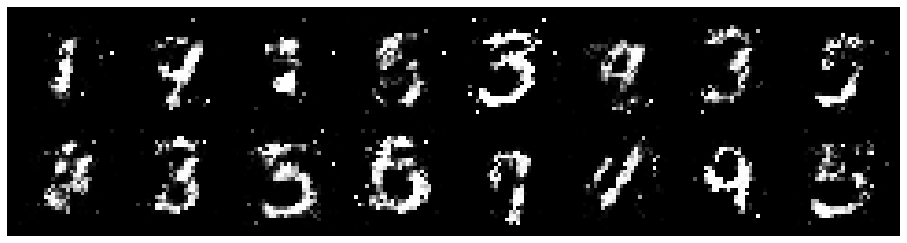

----------------------------------------
Epoch: [4/5] Batch: [0/3750]
Loss_D: 1.3035914897918701 Loss_G: 0.9775011539459229
D(x): 0.5748805403709412 D(G(z)): 0.4142601490020752


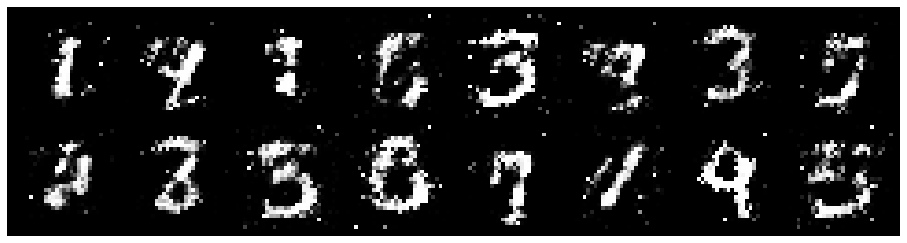

Epoch: [4/5] Batch: [100/3750]
Loss_D: 0.9342154264450073 Loss_G: 1.5574772357940674
D(x): 0.6592937111854553 D(G(z)): 0.35670292377471924


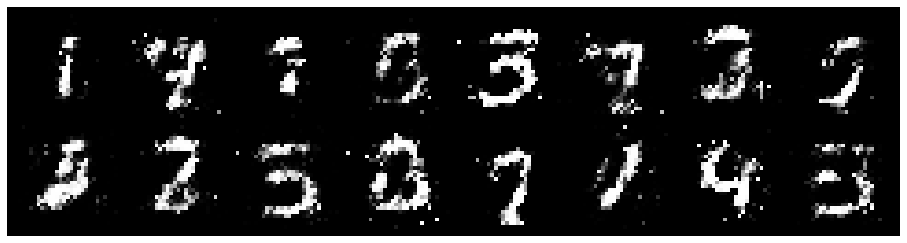

Epoch: [4/5] Batch: [200/3750]
Loss_D: 1.2755515575408936 Loss_G: 1.006770372390747
D(x): 0.44540777802467346 D(G(z)): 0.2824687957763672


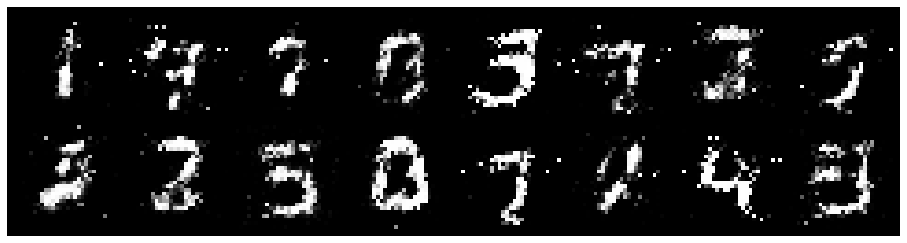

Epoch: [4/5] Batch: [300/3750]
Loss_D: 1.201941728591919 Loss_G: 0.964600682258606
D(x): 0.5364075899124146 D(G(z)): 0.3692832589149475


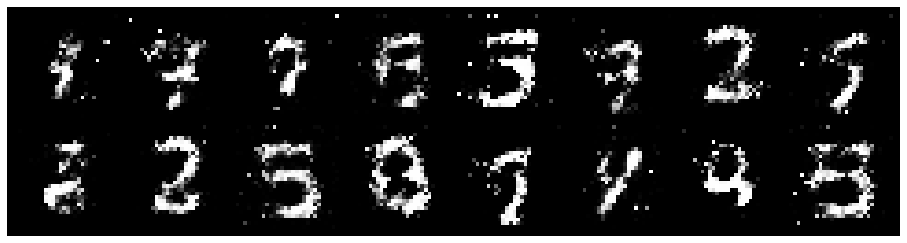

Epoch: [4/5] Batch: [400/3750]
Loss_D: 1.219484567642212 Loss_G: 0.9336848258972168
D(x): 0.4889909327030182 D(G(z)): 0.293515145778656


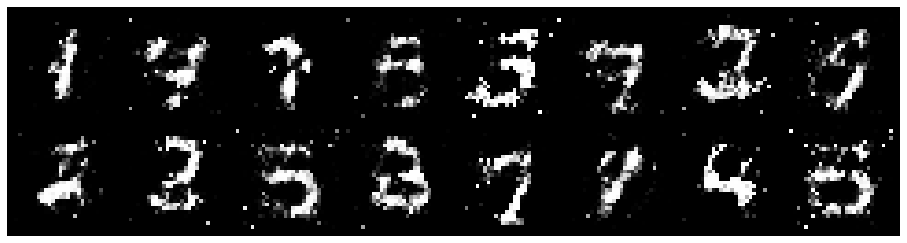

Epoch: [4/5] Batch: [500/3750]
Loss_D: 1.0591415166854858 Loss_G: 1.253213882446289
D(x): 0.587252140045166 D(G(z)): 0.3421361446380615


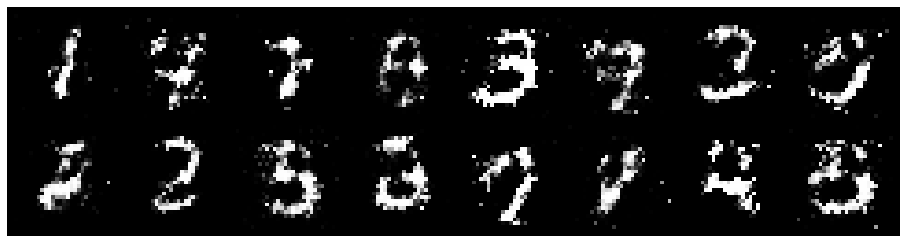

Epoch: [4/5] Batch: [600/3750]
Loss_D: 1.0557805299758911 Loss_G: 1.216262936592102
D(x): 0.7009965181350708 D(G(z)): 0.44947993755340576


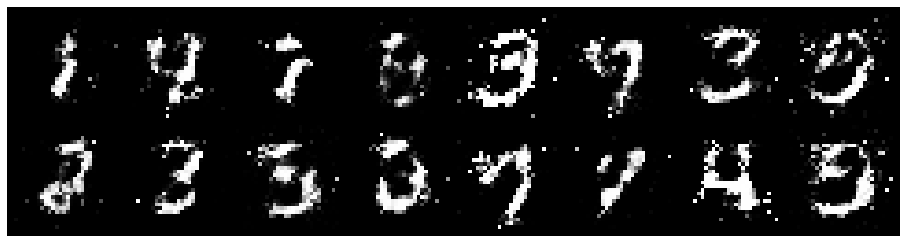

Epoch: [4/5] Batch: [700/3750]
Loss_D: 0.9865638017654419 Loss_G: 1.1368846893310547
D(x): 0.6546187996864319 D(G(z)): 0.3991219997406006


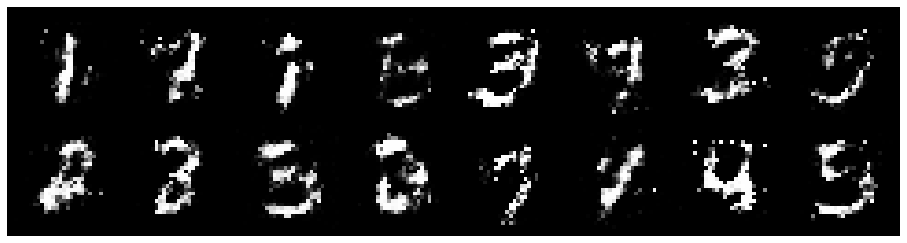

Epoch: [4/5] Batch: [800/3750]
Loss_D: 1.3376473188400269 Loss_G: 0.8894379138946533
D(x): 0.47010916471481323 D(G(z)): 0.31415310502052307


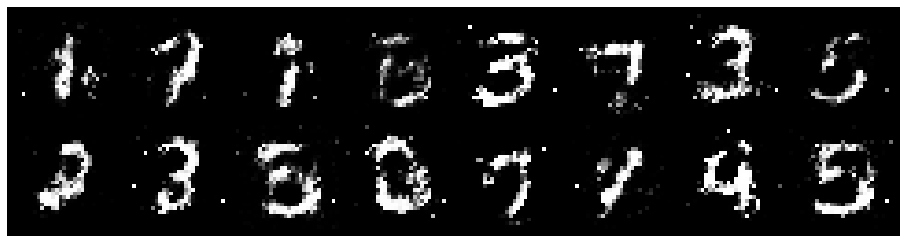

Epoch: [4/5] Batch: [900/3750]
Loss_D: 1.359130859375 Loss_G: 0.7741051912307739
D(x): 0.6123768091201782 D(G(z)): 0.49650055170059204


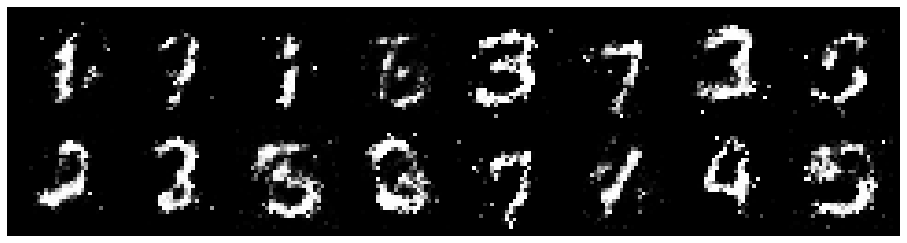

Epoch: [4/5] Batch: [1000/3750]
Loss_D: 1.0848560333251953 Loss_G: 0.9806562662124634
D(x): 0.6042556762695312 D(G(z)): 0.39392802119255066


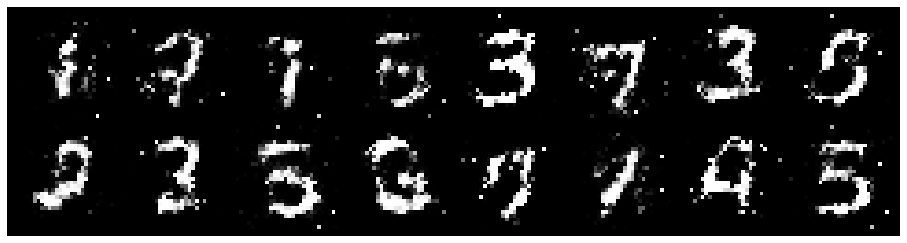

Epoch: [4/5] Batch: [1100/3750]
Loss_D: 0.9737266302108765 Loss_G: 1.2589178085327148
D(x): 0.6757020950317383 D(G(z)): 0.40560442209243774


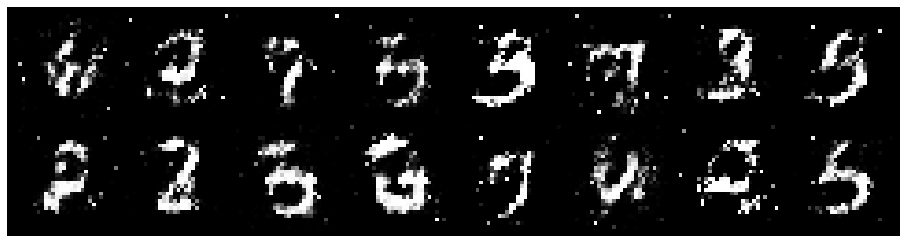

Epoch: [4/5] Batch: [1200/3750]
Loss_D: 1.355062484741211 Loss_G: 0.8180648684501648
D(x): 0.5077450275421143 D(G(z)): 0.34856805205345154


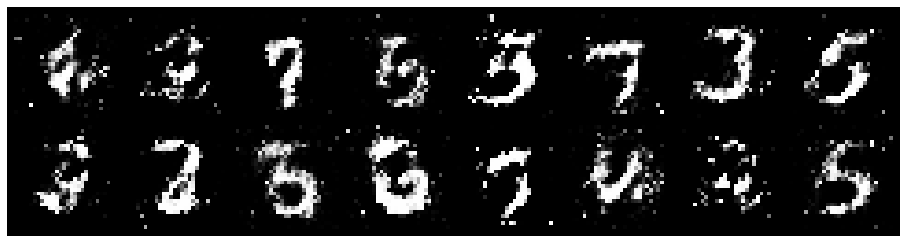

Epoch: [4/5] Batch: [1300/3750]
Loss_D: 1.064814805984497 Loss_G: 1.4799954891204834
D(x): 0.5285381078720093 D(G(z)): 0.29920679330825806


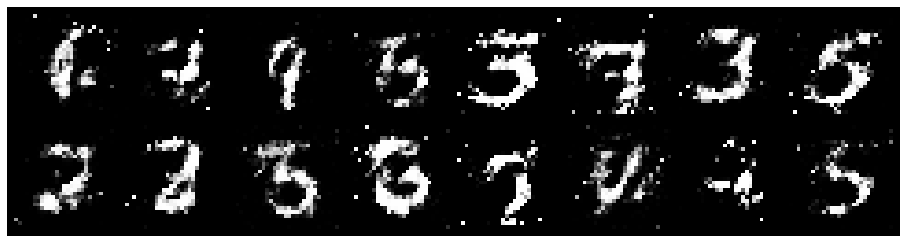

Epoch: [4/5] Batch: [1400/3750]
Loss_D: 0.9450942277908325 Loss_G: 1.2785396575927734
D(x): 0.5673015117645264 D(G(z)): 0.25654807686805725


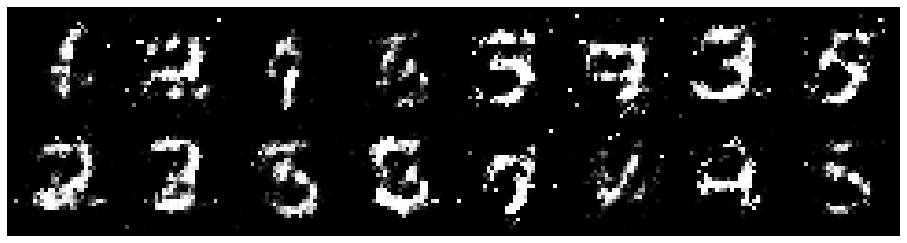

Epoch: [4/5] Batch: [1500/3750]
Loss_D: 1.373099684715271 Loss_G: 1.1222360134124756
D(x): 0.5224705338478088 D(G(z)): 0.39467132091522217


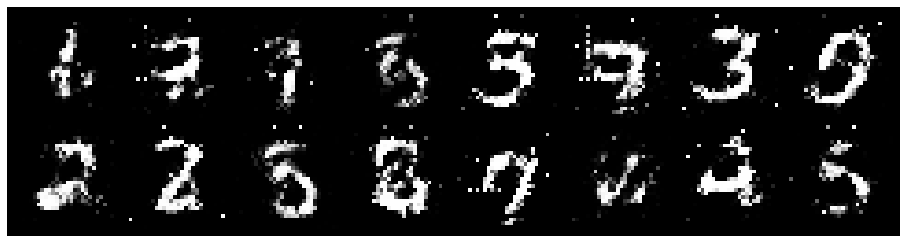

Epoch: [4/5] Batch: [1600/3750]
Loss_D: 1.005812644958496 Loss_G: 1.1067367792129517
D(x): 0.6437994241714478 D(G(z)): 0.3862238824367523


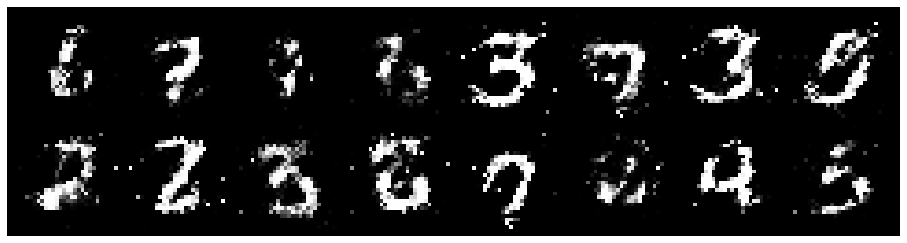

Epoch: [4/5] Batch: [1700/3750]
Loss_D: 1.2632665634155273 Loss_G: 1.029921531677246
D(x): 0.623821496963501 D(G(z)): 0.4996369481086731


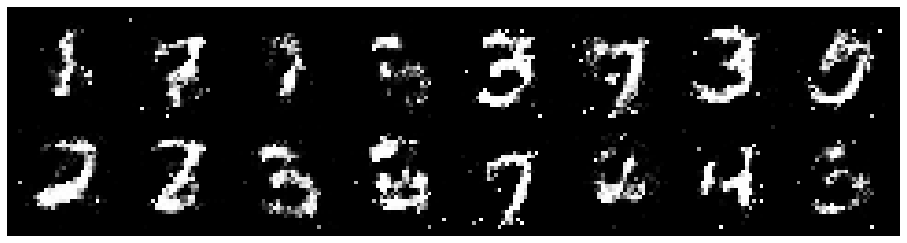

Epoch: [4/5] Batch: [1800/3750]
Loss_D: 1.3383221626281738 Loss_G: 0.8787404894828796
D(x): 0.6390624046325684 D(G(z)): 0.5406155586242676


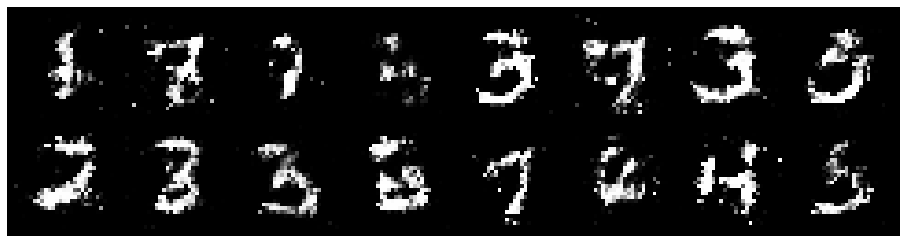

Epoch: [4/5] Batch: [1900/3750]
Loss_D: 1.1117289066314697 Loss_G: 1.1341888904571533
D(x): 0.6550067663192749 D(G(z)): 0.46260082721710205


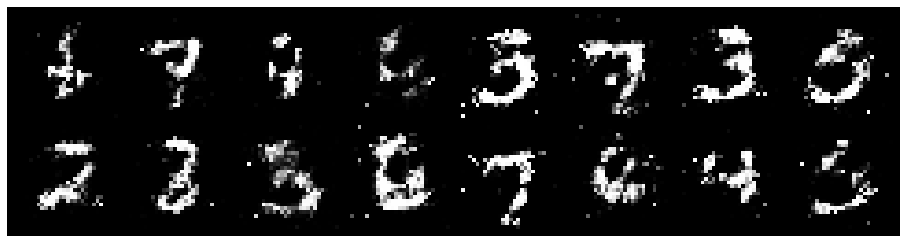

Epoch: [4/5] Batch: [2000/3750]
Loss_D: 1.218302845954895 Loss_G: 1.0498422384262085
D(x): 0.5263458490371704 D(G(z)): 0.3804696500301361


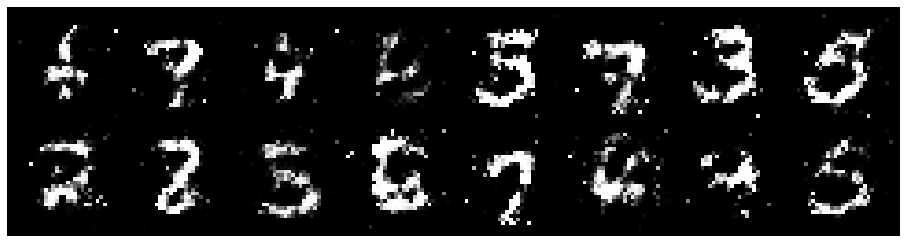

Epoch: [4/5] Batch: [2100/3750]
Loss_D: 1.3562558889389038 Loss_G: 0.935141384601593
D(x): 0.5110581517219543 D(G(z)): 0.4370839297771454


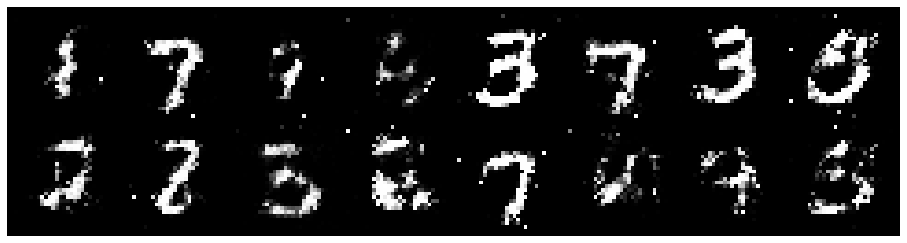

Epoch: [4/5] Batch: [2200/3750]
Loss_D: 1.0770283937454224 Loss_G: 1.20050048828125
D(x): 0.6403564810752869 D(G(z)): 0.4251022934913635


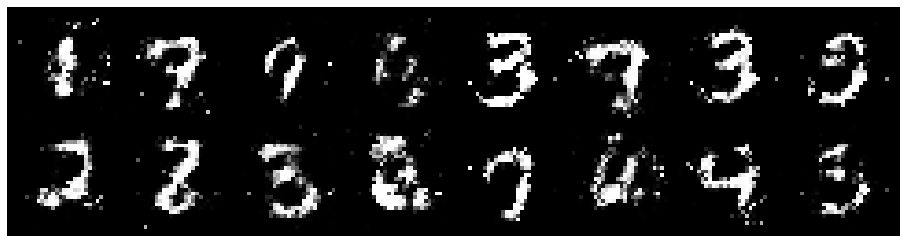

Epoch: [4/5] Batch: [2300/3750]
Loss_D: 1.3311517238616943 Loss_G: 0.8487013578414917
D(x): 0.605743408203125 D(G(z)): 0.5388238430023193


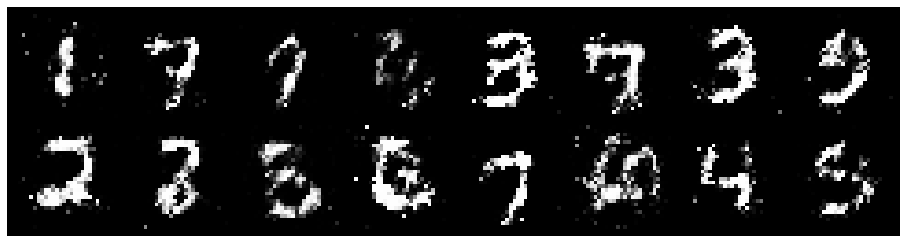

Epoch: [4/5] Batch: [2400/3750]
Loss_D: 1.047948956489563 Loss_G: 1.0709236860275269
D(x): 0.7055254578590393 D(G(z)): 0.462030291557312


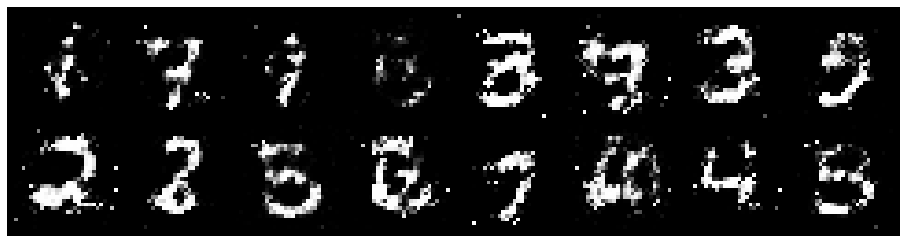

Epoch: [4/5] Batch: [2500/3750]
Loss_D: 1.1993074417114258 Loss_G: 0.9023606181144714
D(x): 0.5210104584693909 D(G(z)): 0.3884396553039551


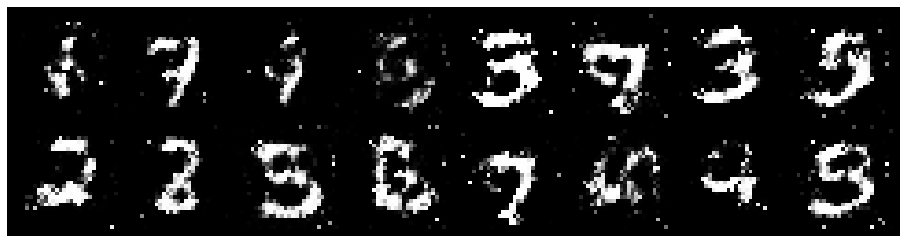

Epoch: [4/5] Batch: [2600/3750]
Loss_D: 1.2545521259307861 Loss_G: 0.9369997382164001
D(x): 0.6058293581008911 D(G(z)): 0.45841991901397705


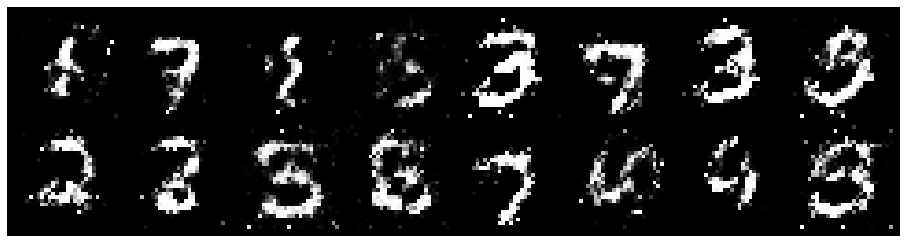

Epoch: [4/5] Batch: [2700/3750]
Loss_D: 1.3461860418319702 Loss_G: 1.011374831199646
D(x): 0.49403873085975647 D(G(z)): 0.4174951910972595


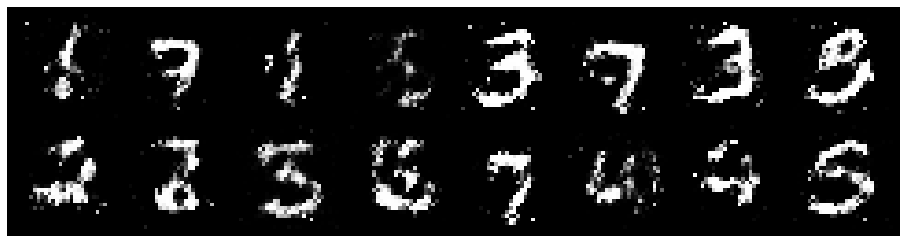

Epoch: [4/5] Batch: [2800/3750]
Loss_D: 1.2445060014724731 Loss_G: 0.9476870894432068
D(x): 0.5202257633209229 D(G(z)): 0.38239040970802307


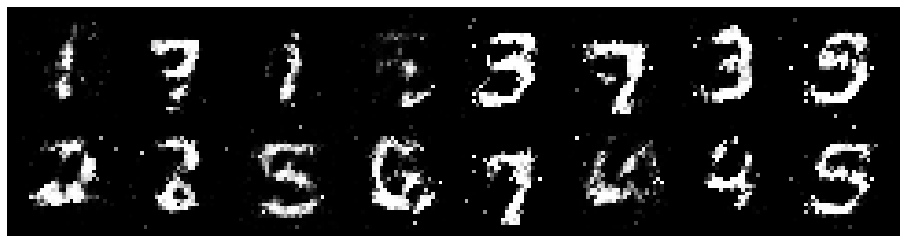

Epoch: [4/5] Batch: [2900/3750]
Loss_D: 1.249696135520935 Loss_G: 0.9621508121490479
D(x): 0.6727707982063293 D(G(z)): 0.532595157623291


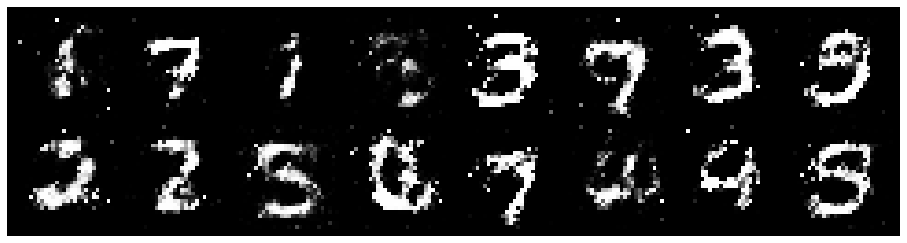

Epoch: [4/5] Batch: [3000/3750]
Loss_D: 1.1447110176086426 Loss_G: 1.1066312789916992
D(x): 0.5932648777961731 D(G(z)): 0.42348310351371765


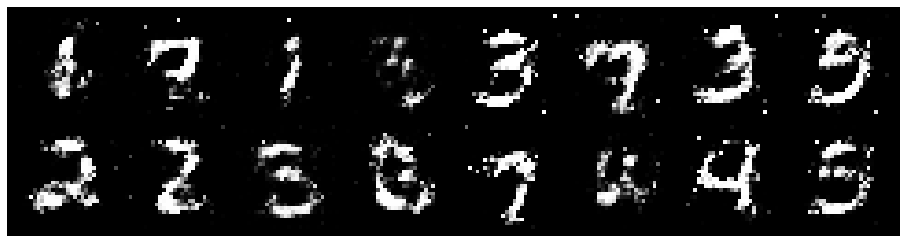

Epoch: [4/5] Batch: [3100/3750]
Loss_D: 1.292339563369751 Loss_G: 0.8335518836975098
D(x): 0.5628765821456909 D(G(z)): 0.46392184495925903


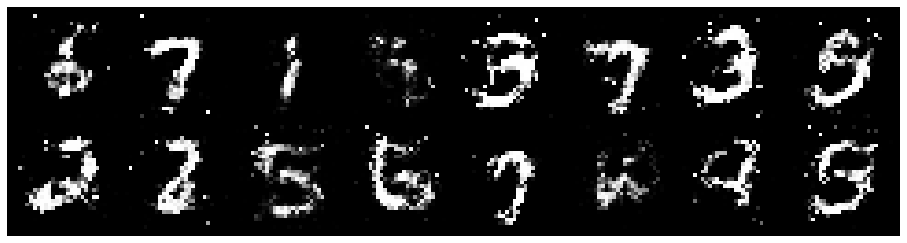

Epoch: [4/5] Batch: [3200/3750]
Loss_D: 1.172178030014038 Loss_G: 0.9551815390586853
D(x): 0.6942057609558105 D(G(z)): 0.5139786005020142


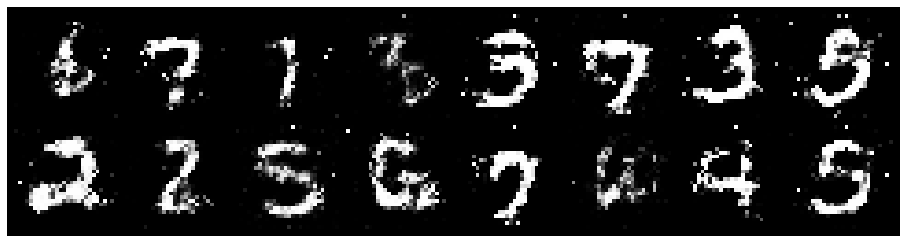

Epoch: [4/5] Batch: [3300/3750]
Loss_D: 1.2857413291931152 Loss_G: 0.9993454217910767
D(x): 0.5842373371124268 D(G(z)): 0.4892297387123108


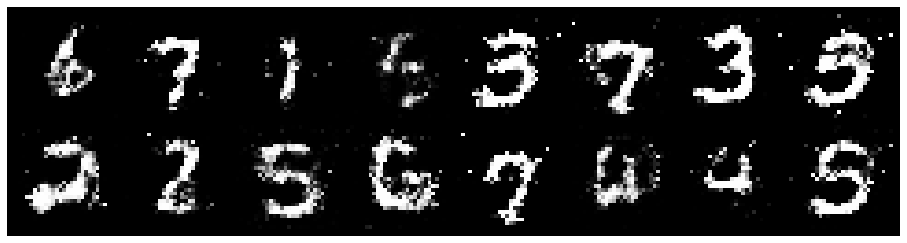

Epoch: [4/5] Batch: [3400/3750]
Loss_D: 1.2453523874282837 Loss_G: 1.0031101703643799
D(x): 0.5526614785194397 D(G(z)): 0.42862874269485474


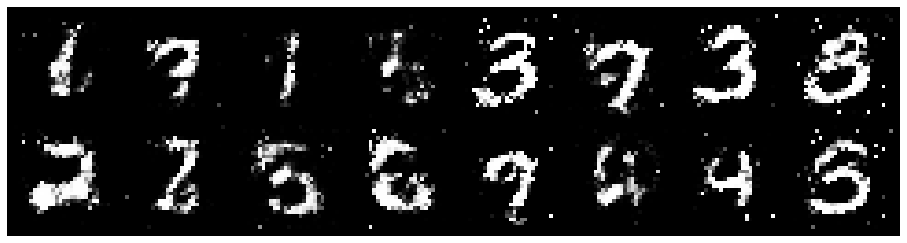

Epoch: [4/5] Batch: [3500/3750]
Loss_D: 1.4446842670440674 Loss_G: 0.7535524368286133
D(x): 0.4571780264377594 D(G(z)): 0.43126657605171204


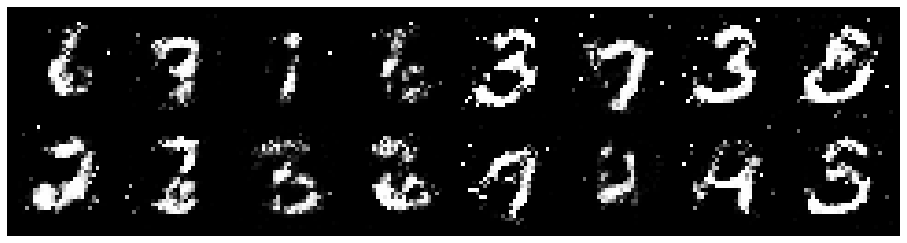

Epoch: [4/5] Batch: [3600/3750]
Loss_D: 1.1497148275375366 Loss_G: 0.973785400390625
D(x): 0.5163537263870239 D(G(z)): 0.3198435604572296


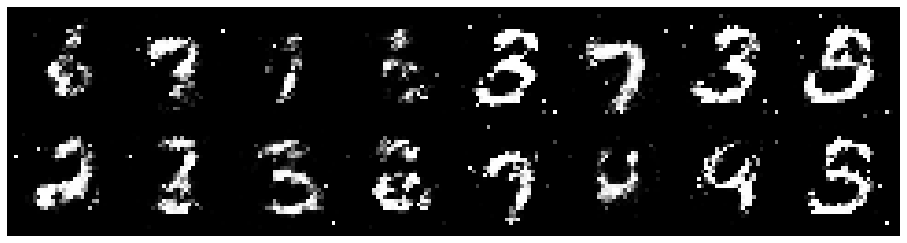

Epoch: [4/5] Batch: [3700/3750]
Loss_D: 1.2332768440246582 Loss_G: 0.9973502159118652
D(x): 0.543948769569397 D(G(z)): 0.44035255908966064


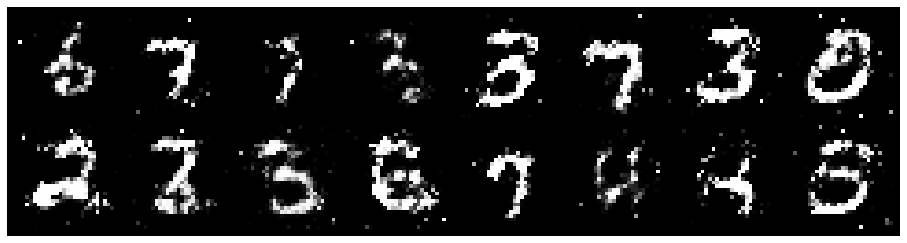

----------------------------------------
Epoch: [5/5] Batch: [0/3750]
Loss_D: 1.364177942276001 Loss_G: 0.7344471216201782
D(x): 0.4955188035964966 D(G(z)): 0.4270997941493988


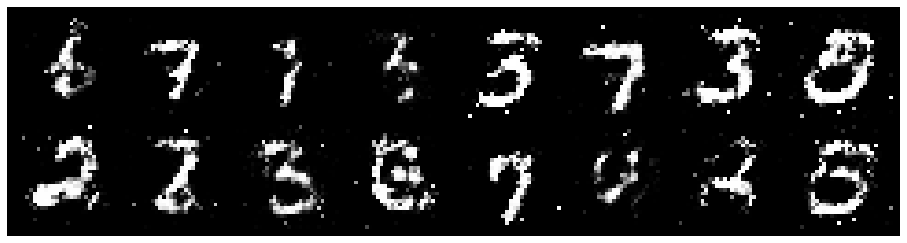

Epoch: [5/5] Batch: [100/3750]
Loss_D: 1.0850398540496826 Loss_G: 1.0594069957733154
D(x): 0.6168311834335327 D(G(z)): 0.41928577423095703


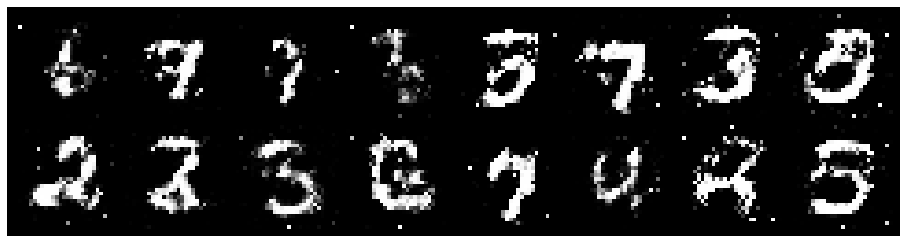

Epoch: [5/5] Batch: [200/3750]
Loss_D: 1.1903936862945557 Loss_G: 0.9831608533859253
D(x): 0.5561748147010803 D(G(z)): 0.4276807904243469


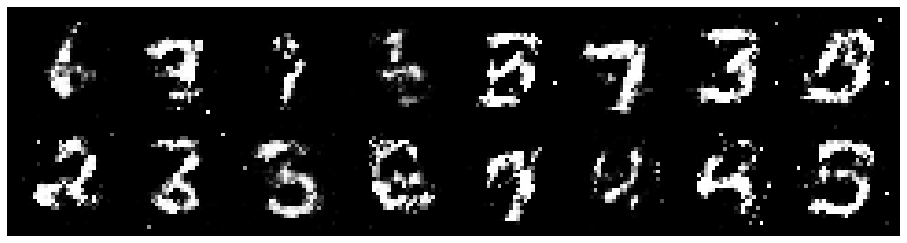

Epoch: [5/5] Batch: [300/3750]
Loss_D: 1.5376062393188477 Loss_G: 1.0815660953521729
D(x): 0.6044869422912598 D(G(z)): 0.5584338903427124


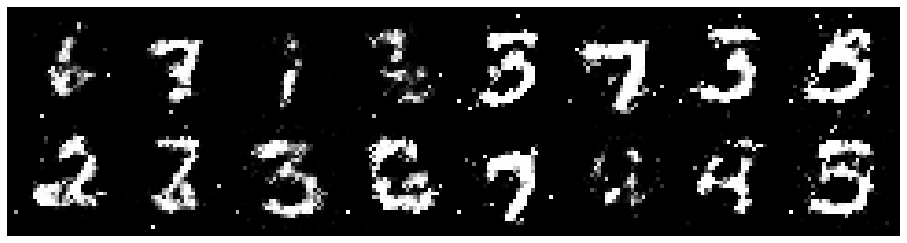

Epoch: [5/5] Batch: [400/3750]
Loss_D: 1.354874610900879 Loss_G: 0.7987440824508667
D(x): 0.6096453666687012 D(G(z)): 0.5470343828201294


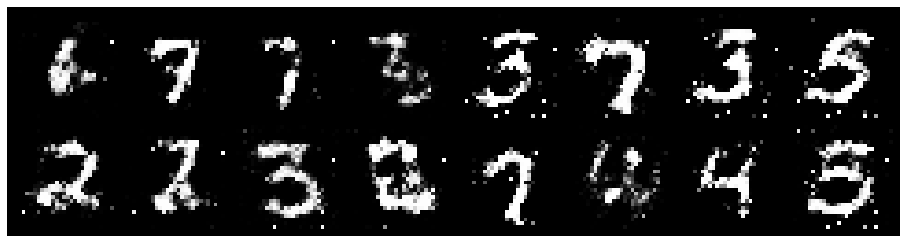

Epoch: [5/5] Batch: [500/3750]
Loss_D: 1.305182695388794 Loss_G: 0.9815737009048462
D(x): 0.4836256206035614 D(G(z)): 0.3986467719078064


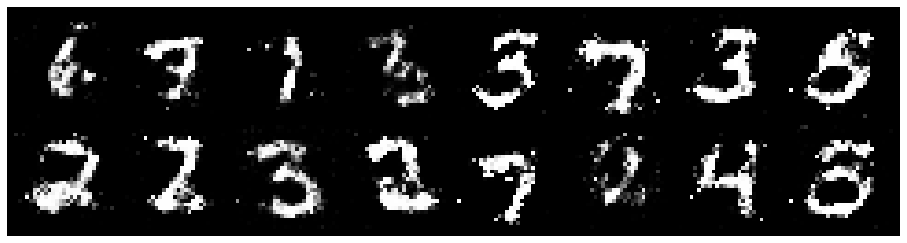

Epoch: [5/5] Batch: [600/3750]
Loss_D: 1.3195383548736572 Loss_G: 0.8564726710319519
D(x): 0.5228104591369629 D(G(z)): 0.452298104763031


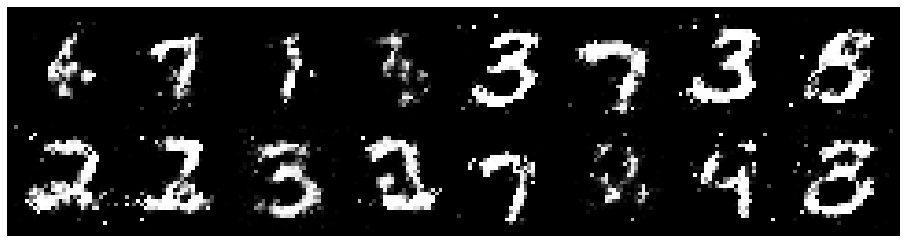

Epoch: [5/5] Batch: [700/3750]
Loss_D: 1.3275736570358276 Loss_G: 1.1211477518081665
D(x): 0.5170409679412842 D(G(z)): 0.43967586755752563


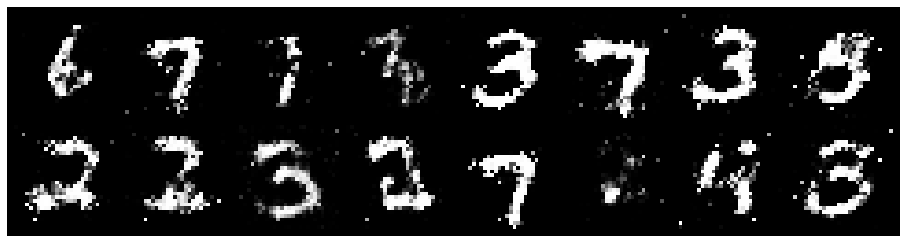

Epoch: [5/5] Batch: [800/3750]
Loss_D: 1.3235911130905151 Loss_G: 1.080317497253418
D(x): 0.6030433773994446 D(G(z)): 0.5160979628562927


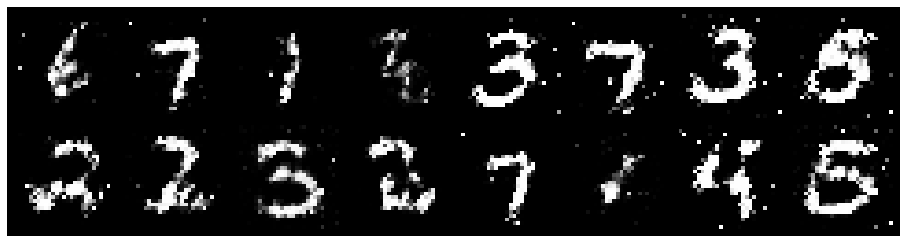

Epoch: [5/5] Batch: [900/3750]
Loss_D: 1.2580721378326416 Loss_G: 0.7441068887710571
D(x): 0.5369610786437988 D(G(z)): 0.444338858127594


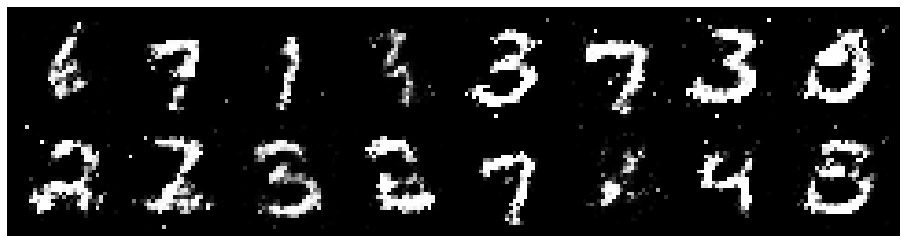

Epoch: [5/5] Batch: [1000/3750]
Loss_D: 1.248298168182373 Loss_G: 0.9965601563453674
D(x): 0.5426110029220581 D(G(z)): 0.42570286989212036


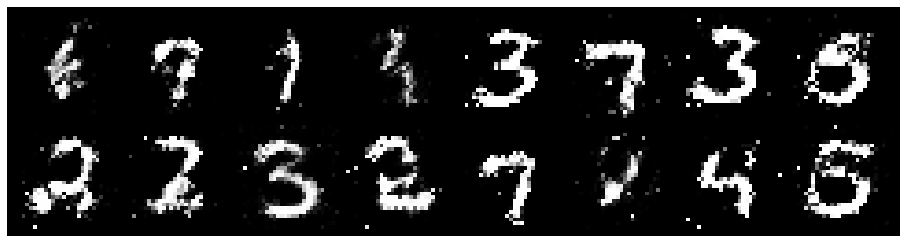

Epoch: [5/5] Batch: [1100/3750]
Loss_D: 1.2215771675109863 Loss_G: 0.7470247149467468
D(x): 0.501030683517456 D(G(z)): 0.366058349609375


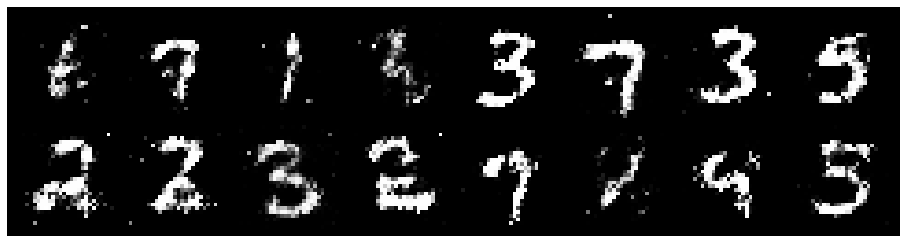

Epoch: [5/5] Batch: [1200/3750]
Loss_D: 1.426466464996338 Loss_G: 0.9641754627227783
D(x): 0.5579653978347778 D(G(z)): 0.5127370357513428


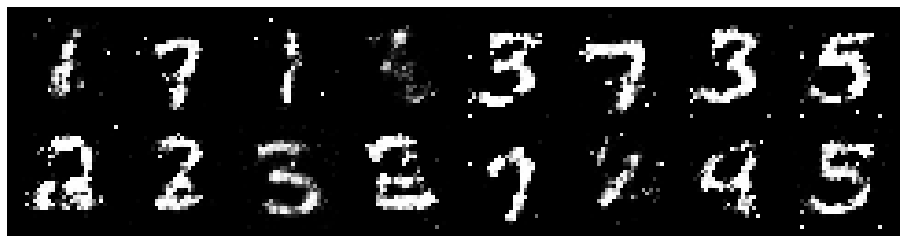

Epoch: [5/5] Batch: [1300/3750]
Loss_D: 1.3971633911132812 Loss_G: 0.9036116003990173
D(x): 0.4922146201133728 D(G(z)): 0.450426310300827


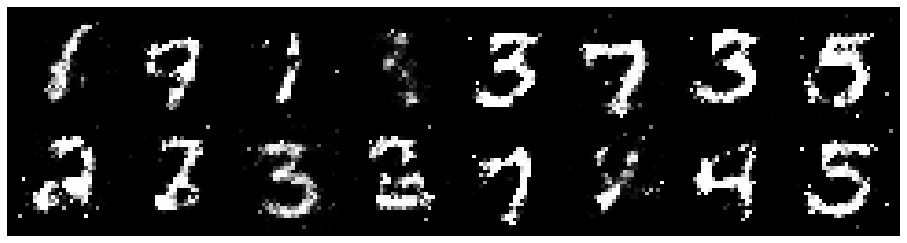

Epoch: [5/5] Batch: [1400/3750]
Loss_D: 1.2684754133224487 Loss_G: 0.8703446388244629
D(x): 0.5116059184074402 D(G(z)): 0.43505144119262695


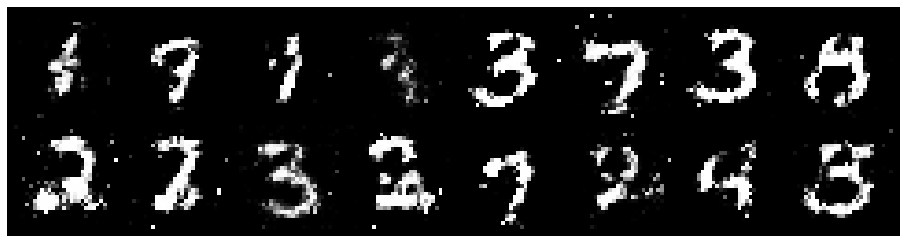

Epoch: [5/5] Batch: [1500/3750]
Loss_D: 1.3308051824569702 Loss_G: 0.7223958373069763
D(x): 0.5260251760482788 D(G(z)): 0.4548380374908447


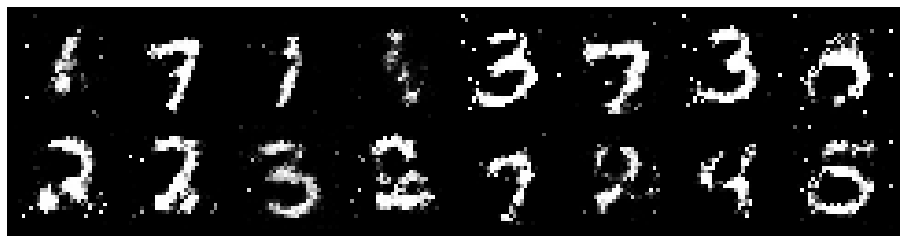

Epoch: [5/5] Batch: [1600/3750]
Loss_D: 1.1698929071426392 Loss_G: 0.7298415899276733
D(x): 0.5772188305854797 D(G(z)): 0.41166865825653076


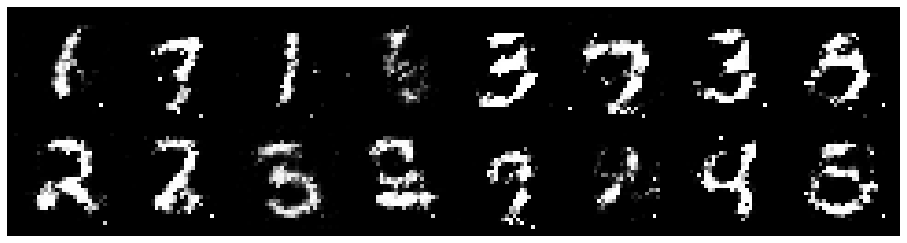

Epoch: [5/5] Batch: [1700/3750]
Loss_D: 1.1795223951339722 Loss_G: 0.8817363977432251
D(x): 0.5819463729858398 D(G(z)): 0.42885464429855347


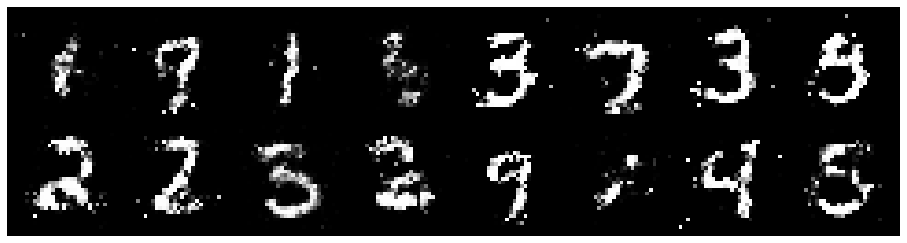

Epoch: [5/5] Batch: [1800/3750]
Loss_D: 1.4691321849822998 Loss_G: 1.0492708683013916
D(x): 0.5302273035049438 D(G(z)): 0.469186931848526


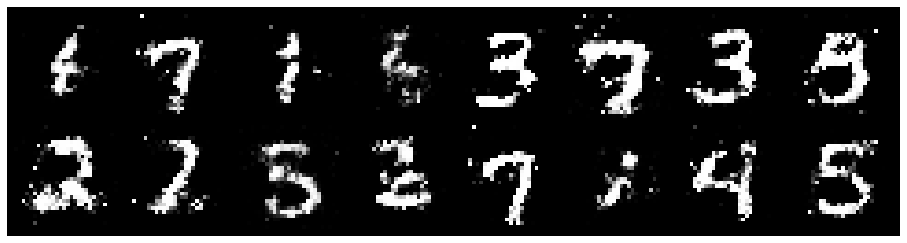

Epoch: [5/5] Batch: [1900/3750]
Loss_D: 1.1703944206237793 Loss_G: 0.9440948963165283
D(x): 0.5204504132270813 D(G(z)): 0.3834463655948639


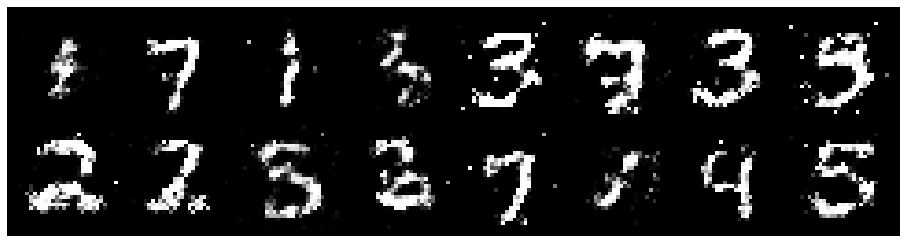

Epoch: [5/5] Batch: [2000/3750]
Loss_D: 1.3569767475128174 Loss_G: 0.9592252969741821
D(x): 0.5106045007705688 D(G(z)): 0.4626781940460205


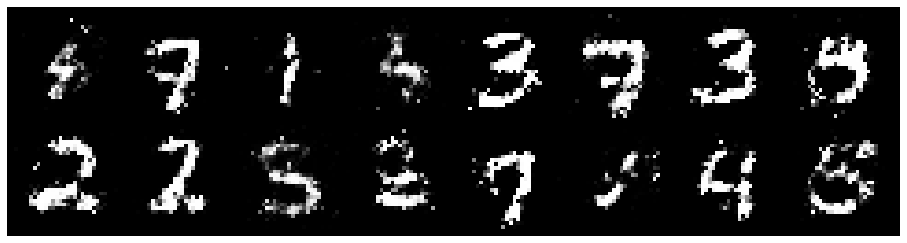

Epoch: [5/5] Batch: [2100/3750]
Loss_D: 1.1801409721374512 Loss_G: 1.120481252670288
D(x): 0.6052229404449463 D(G(z)): 0.42472657561302185


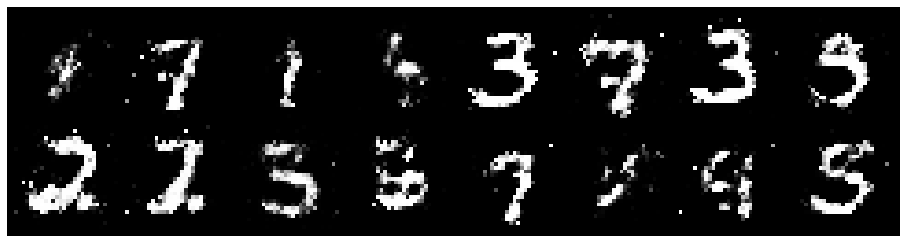

Epoch: [5/5] Batch: [2200/3750]
Loss_D: 1.1417515277862549 Loss_G: 1.0451834201812744
D(x): 0.5449357032775879 D(G(z)): 0.3586028814315796


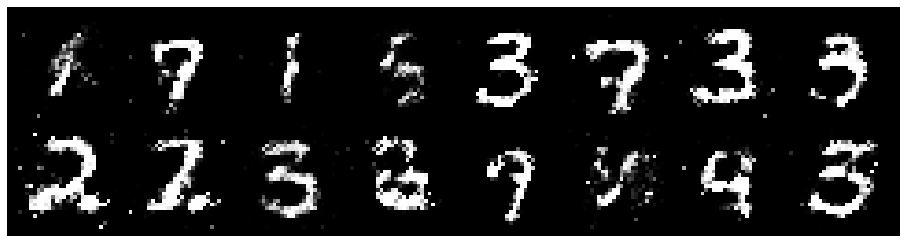

Epoch: [5/5] Batch: [2300/3750]
Loss_D: 1.2112518548965454 Loss_G: 1.1044844388961792
D(x): 0.6228307485580444 D(G(z)): 0.4937637448310852


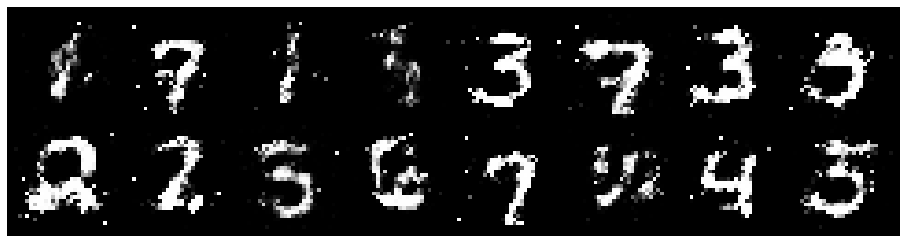

Epoch: [5/5] Batch: [2400/3750]
Loss_D: 1.296078085899353 Loss_G: 0.9294047355651855
D(x): 0.5750783681869507 D(G(z)): 0.4882618486881256


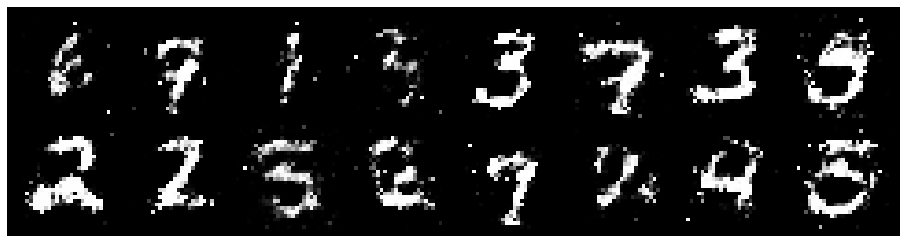

Epoch: [5/5] Batch: [2500/3750]
Loss_D: 1.2584782838821411 Loss_G: 0.8722400665283203
D(x): 0.5585718154907227 D(G(z)): 0.4488263726234436


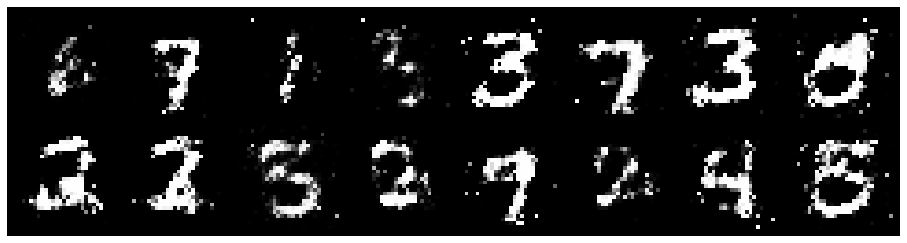

Epoch: [5/5] Batch: [2600/3750]
Loss_D: 1.1499361991882324 Loss_G: 0.9112671613693237
D(x): 0.6093039512634277 D(G(z)): 0.4551212191581726


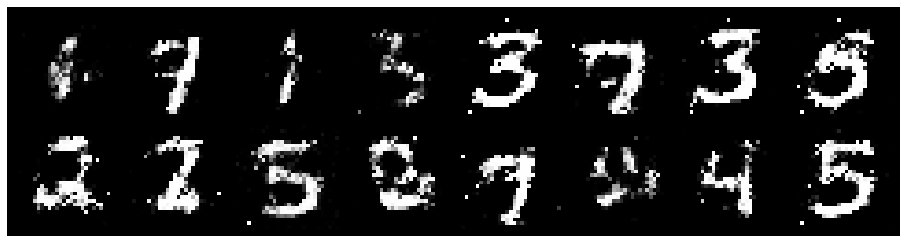

Epoch: [5/5] Batch: [2700/3750]
Loss_D: 1.2928192615509033 Loss_G: 0.7247920036315918
D(x): 0.5571118593215942 D(G(z)): 0.46773627400398254


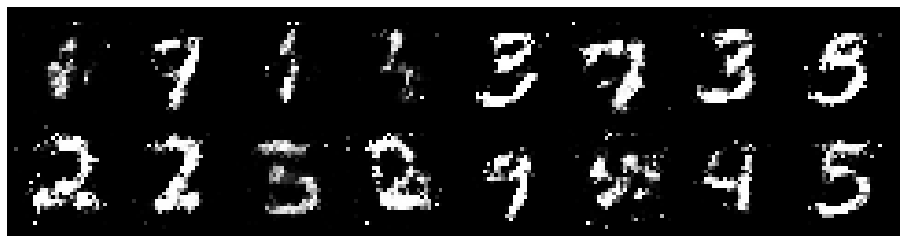

Epoch: [5/5] Batch: [2800/3750]
Loss_D: 1.2723692655563354 Loss_G: 0.8949826955795288
D(x): 0.5912774205207825 D(G(z)): 0.488614022731781


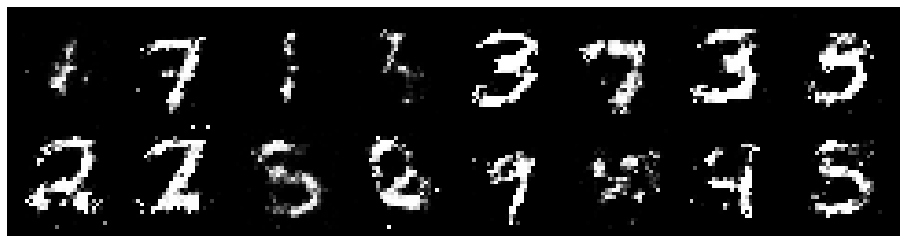

Epoch: [5/5] Batch: [2900/3750]
Loss_D: 1.3402551412582397 Loss_G: 0.7981177568435669
D(x): 0.5151973366737366 D(G(z)): 0.46815308928489685


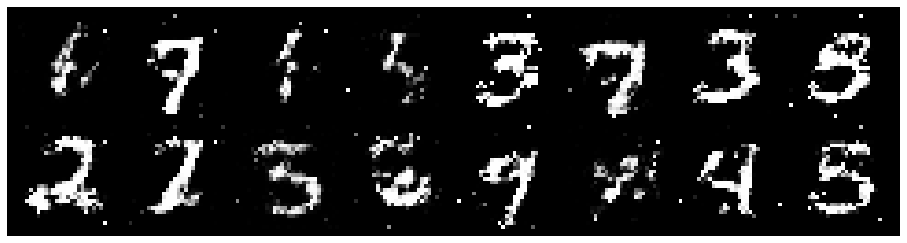

Epoch: [5/5] Batch: [3000/3750]
Loss_D: 1.1603411436080933 Loss_G: 1.0311957597732544
D(x): 0.5286386013031006 D(G(z)): 0.382338285446167


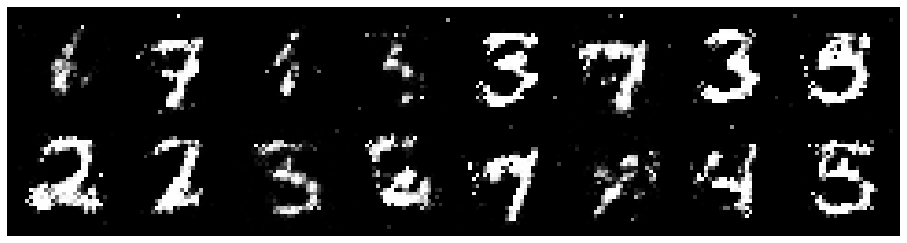

Epoch: [5/5] Batch: [3100/3750]
Loss_D: 1.3337414264678955 Loss_G: 0.8603650331497192
D(x): 0.5289021134376526 D(G(z)): 0.4754767119884491


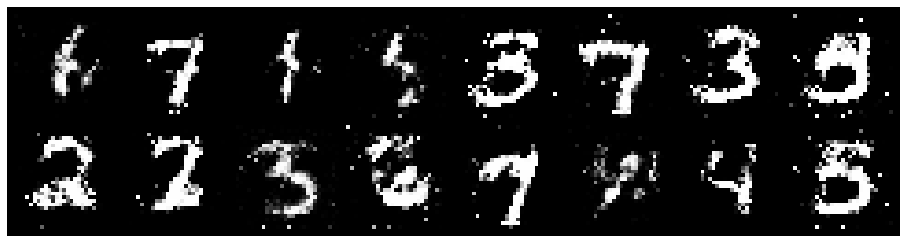

Epoch: [5/5] Batch: [3200/3750]
Loss_D: 1.3762452602386475 Loss_G: 0.8935359716415405
D(x): 0.5332432985305786 D(G(z)): 0.4510653018951416


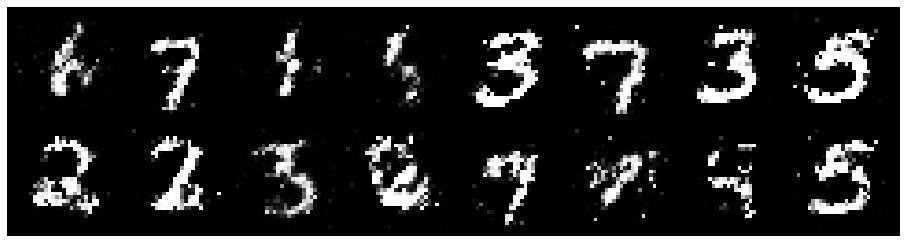

Epoch: [5/5] Batch: [3300/3750]
Loss_D: 1.1798144578933716 Loss_G: 0.9984955787658691
D(x): 0.545072615146637 D(G(z)): 0.4117114543914795


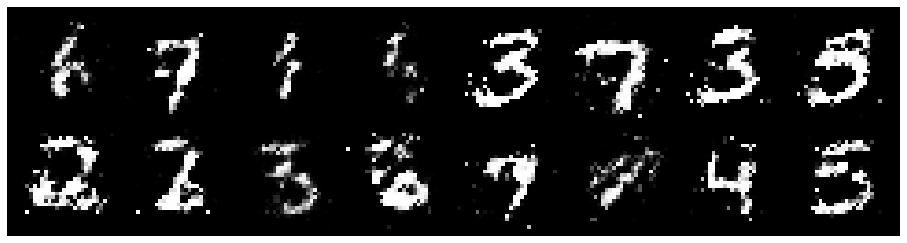

Epoch: [5/5] Batch: [3400/3750]
Loss_D: 1.4798892736434937 Loss_G: 1.0659981966018677
D(x): 0.6399168372154236 D(G(z)): 0.6028662919998169


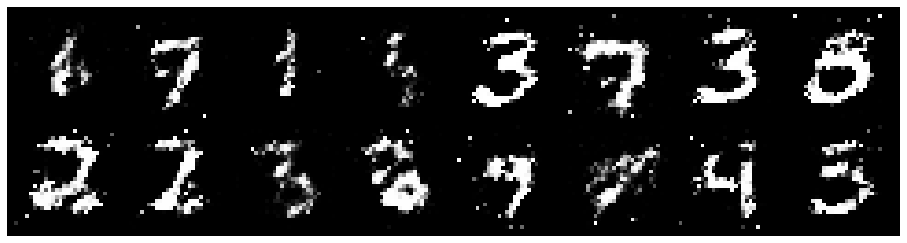

Epoch: [5/5] Batch: [3500/3750]
Loss_D: 1.4066123962402344 Loss_G: 0.8278883695602417
D(x): 0.6033698916435242 D(G(z)): 0.5653880834579468


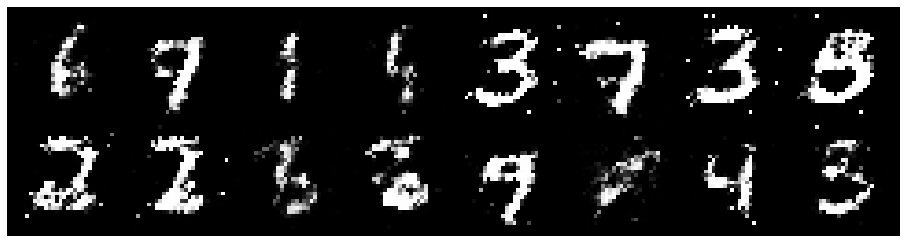

Epoch: [5/5] Batch: [3600/3750]
Loss_D: 1.2707788944244385 Loss_G: 0.7790910005569458
D(x): 0.5347104072570801 D(G(z)): 0.448067843914032


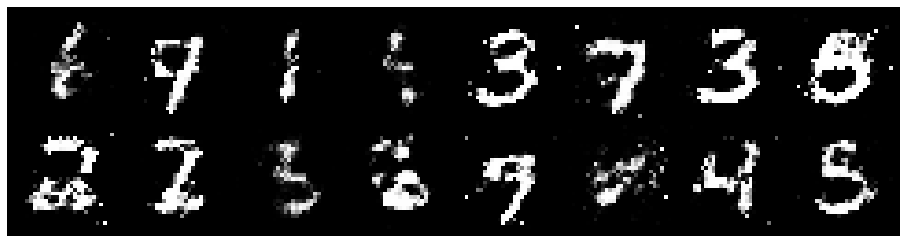

Epoch: [5/5] Batch: [3700/3750]
Loss_D: 1.08990478515625 Loss_G: 1.0805540084838867
D(x): 0.5765941143035889 D(G(z)): 0.39493268728256226


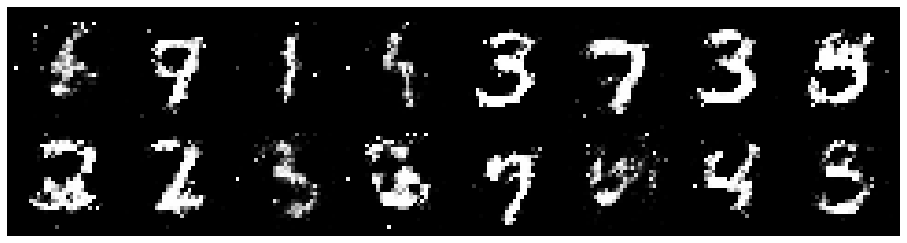

In [12]:
imgs, g_loss, d_loss = train(dataset=mnist)

Plotting the results! I personally like the ggplot plt style since the colors are more vibrant.\
Note that we only trained our GAN for 5 epochs!

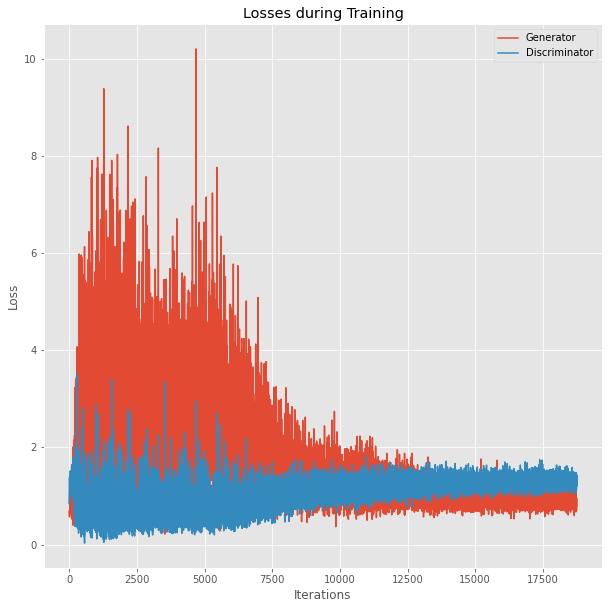

In [13]:
plt.style.use('ggplot')
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Losses during Training')
ax.plot(g_loss,label="Generator")
ax.plot(d_loss,label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Saving results as a gif for Github upload.

In [19]:
import cv2 as cv
import imageio
import os

#VERY VERY ROUGH CONVERSION. But it worked. Got a bit lazy here. hehe
converted_list = [np.transpose((i*255).numpy().astype('uint8'),(1,2,0)) for i in imgs]

imageio.mimsave('./mnist_test.gif',converted_list,fps=5)

Hi! In this portion we will start training with DCGAN. An improved network from vanilla-GAN which uses convolutions!

In [20]:
#we reshape the fixed test_noise we initialized earlier
test_noise = test_noise.reshape(-1,gf,1,1)

In [21]:
from models.dcgan import Discriminator, Generator

In [22]:
dNet = Discriminator().to(device)
gNet = Generator().to(device)

criterion = nn.BCELoss()
optimD = optim.Adam(dNet.parameters(),lr=learning_rate,betas=(0.5,0.999))
optimG = optim.Adam(gNet.parameters(),lr=learning_rate,betas=(0.5,0.999))

----------------------------------------
Epoch: [1/5] Batch: [0/3750]
Loss_D: 1.4072357416152954 Loss_G: 6.888333320617676
D(x): 0.4599676728248596 D(G(z)): 0.45318955183029175


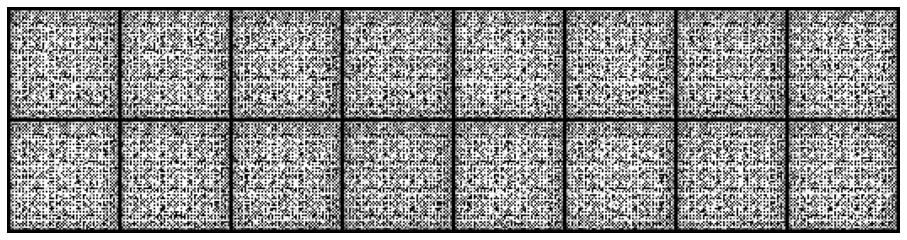

Epoch: [1/5] Batch: [100/3750]
Loss_D: 0.0007335772970691323 Loss_G: 8.734573364257812
D(x): 0.9996351003646851 D(G(z)): 0.00036772346356883645


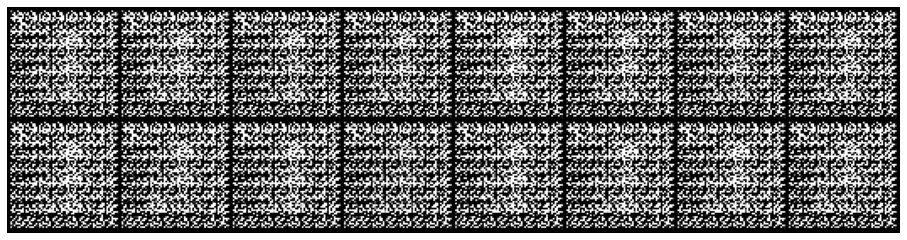

Epoch: [1/5] Batch: [200/3750]
Loss_D: 0.00023490753665100783 Loss_G: 9.245159149169922
D(x): 0.9999572038650513 D(G(z)): 0.00019211138715036213


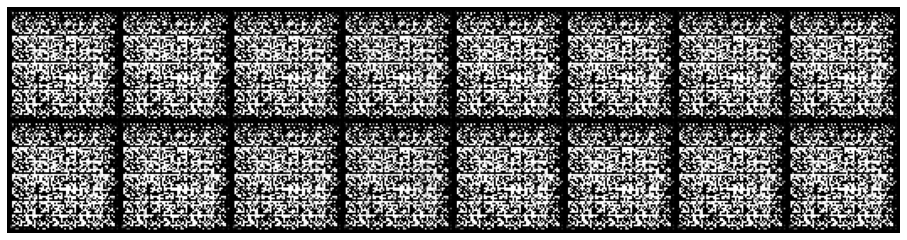

Epoch: [1/5] Batch: [300/3750]
Loss_D: 0.00012782379053533077 Loss_G: 9.823783874511719
D(x): 0.9999516010284424 D(G(z)): 7.937905320432037e-05


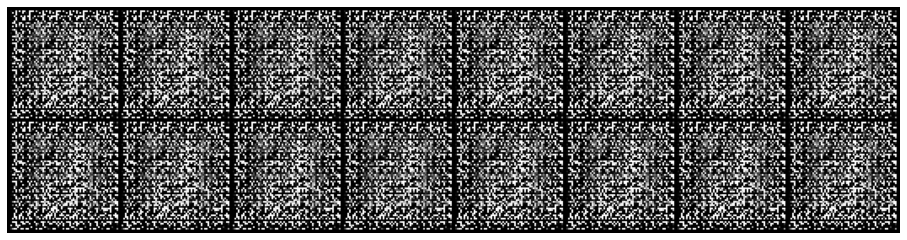

Epoch: [1/5] Batch: [400/3750]
Loss_D: 0.00015806707961019129 Loss_G: 10.105487823486328
D(x): 0.9999790787696838 D(G(z)): 0.00013713649241253734


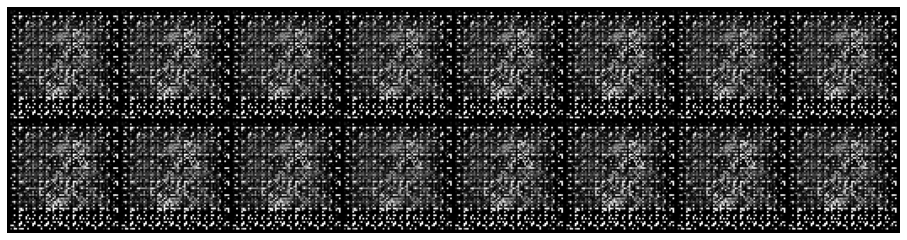

Epoch: [1/5] Batch: [500/3750]
Loss_D: 0.05415361002087593 Loss_G: 5.316229820251465
D(x): 0.9984877705574036 D(G(z)): 0.05093877762556076


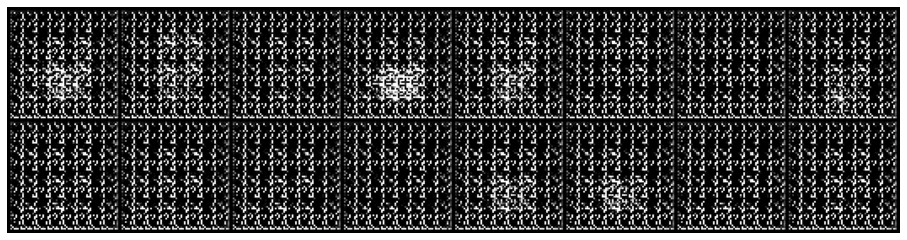

Epoch: [1/5] Batch: [600/3750]
Loss_D: 0.0016458580503240228 Loss_G: 6.924671649932861
D(x): 0.9995659589767456 D(G(z)): 0.0012106208596378565


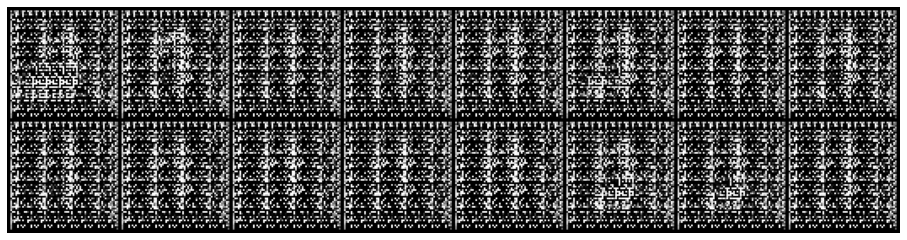

Epoch: [1/5] Batch: [700/3750]
Loss_D: 0.0014370440039783716 Loss_G: 7.047739028930664
D(x): 0.9997745156288147 D(G(z)): 0.0012105677742511034


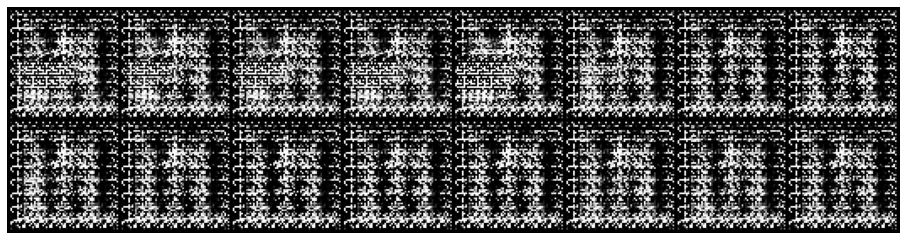

Epoch: [1/5] Batch: [800/3750]
Loss_D: 0.504021167755127 Loss_G: 3.926470994949341
D(x): 0.8181895613670349 D(G(z)): 0.14470325410366058


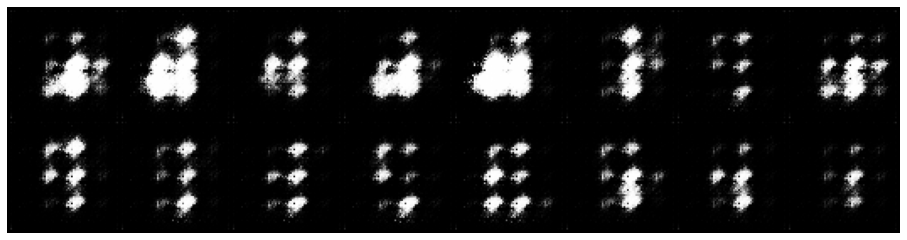

Epoch: [1/5] Batch: [900/3750]
Loss_D: 0.6489037275314331 Loss_G: 2.921679973602295
D(x): 0.6569784283638 D(G(z)): 0.16028261184692383


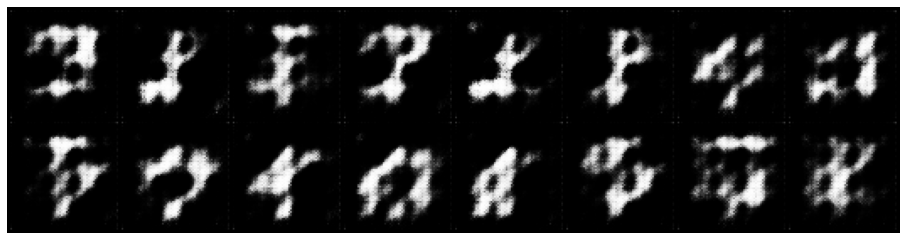

Epoch: [1/5] Batch: [1000/3750]
Loss_D: 1.273888349533081 Loss_G: 0.5554360747337341
D(x): 0.39713677763938904 D(G(z)): 0.11388634890317917


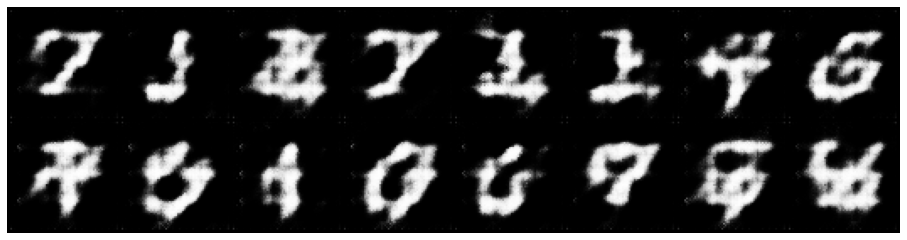

Epoch: [1/5] Batch: [1100/3750]
Loss_D: 0.7034124135971069 Loss_G: 1.9439804553985596
D(x): 0.7299063801765442 D(G(z)): 0.2832009196281433


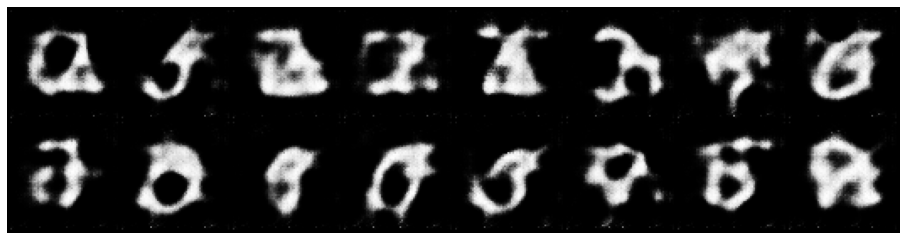

Epoch: [1/5] Batch: [1200/3750]
Loss_D: 0.7834410667419434 Loss_G: 1.9708737134933472
D(x): 0.5703809857368469 D(G(z)): 0.1527285873889923


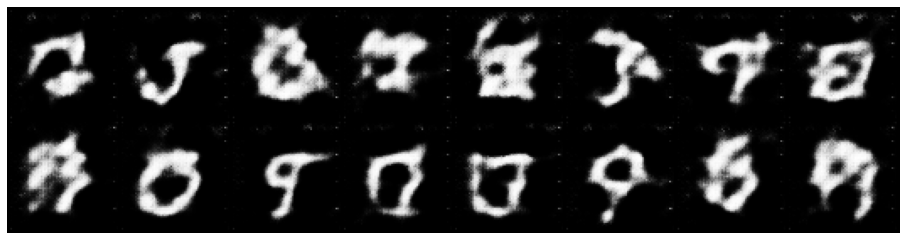

Epoch: [1/5] Batch: [1300/3750]
Loss_D: 1.3361586332321167 Loss_G: 1.6608319282531738
D(x): 0.828426718711853 D(G(z)): 0.6077203750610352


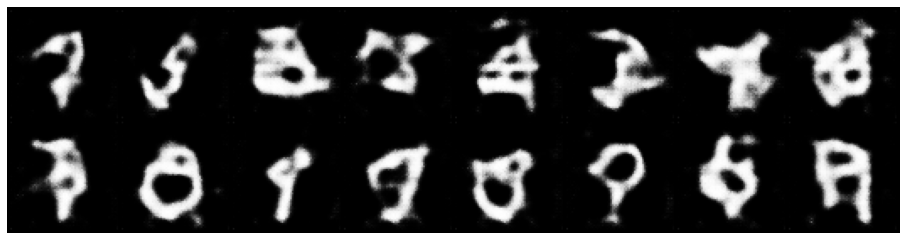

Epoch: [1/5] Batch: [1400/3750]
Loss_D: 1.4787051677703857 Loss_G: 0.8236130475997925
D(x): 0.2746632397174835 D(G(z)): 0.028963923454284668


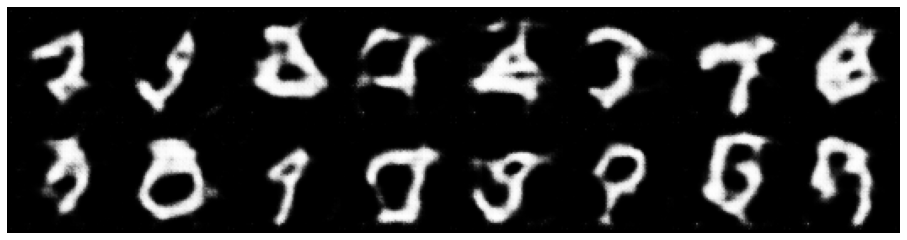

Epoch: [1/5] Batch: [1500/3750]
Loss_D: 0.5628490447998047 Loss_G: 3.0523428916931152
D(x): 0.8477755188941956 D(G(z)): 0.3047884702682495


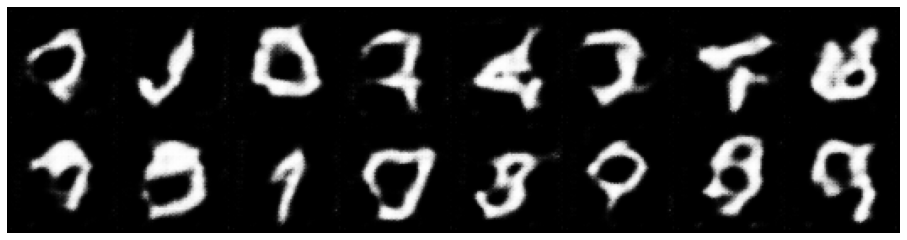

Epoch: [1/5] Batch: [1600/3750]
Loss_D: 0.6106934547424316 Loss_G: 2.086392402648926
D(x): 0.6848089694976807 D(G(z)): 0.1406620442867279


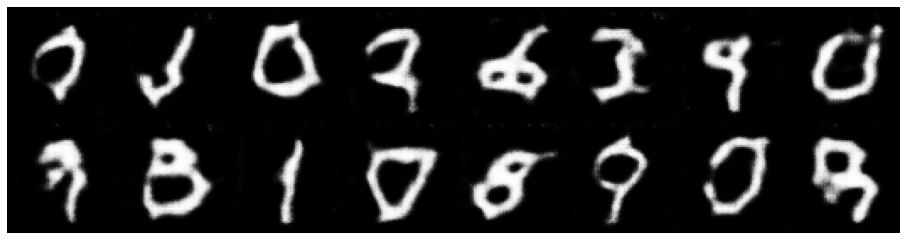

Epoch: [1/5] Batch: [1700/3750]
Loss_D: 0.5512752532958984 Loss_G: 2.3643758296966553
D(x): 0.7650191783905029 D(G(z)): 0.21208223700523376


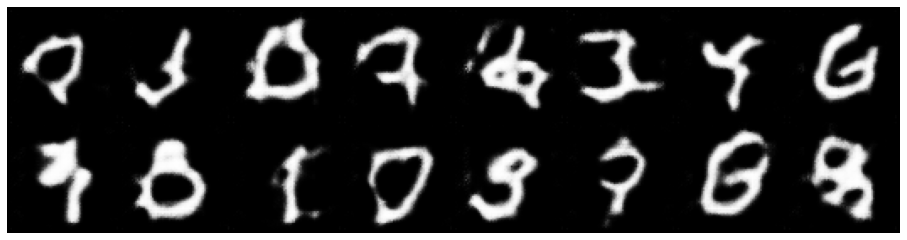

Epoch: [1/5] Batch: [1800/3750]
Loss_D: 0.7007230520248413 Loss_G: 1.054497241973877
D(x): 0.5698305368423462 D(G(z)): 0.08429092168807983


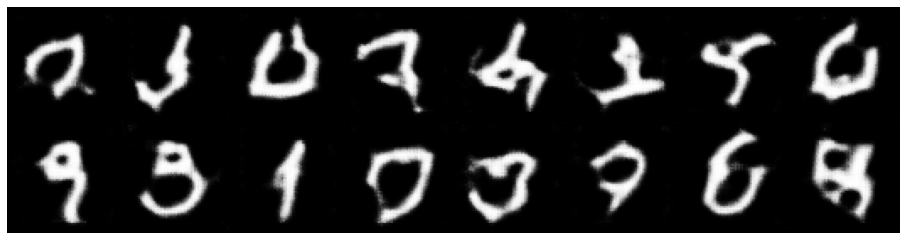

Epoch: [1/5] Batch: [1900/3750]
Loss_D: 1.7522472143173218 Loss_G: 1.5872139930725098
D(x): 0.21683819591999054 D(G(z)): 0.026868171989917755


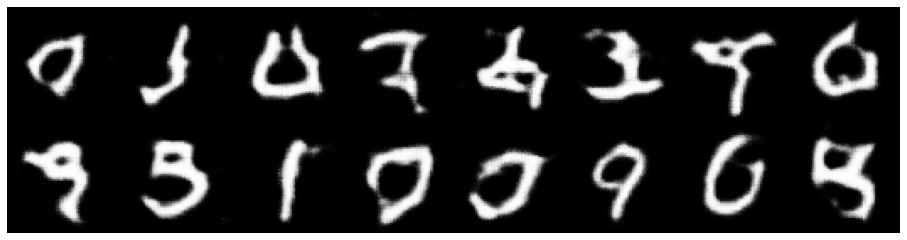

Epoch: [1/5] Batch: [2000/3750]
Loss_D: 0.6308565139770508 Loss_G: 1.4515163898468018
D(x): 0.6373820900917053 D(G(z)): 0.14103657007217407


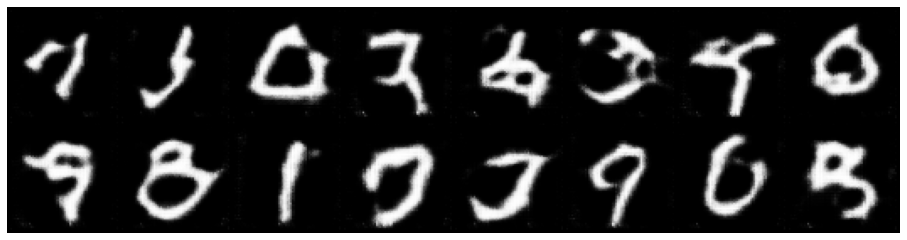

Epoch: [1/5] Batch: [2100/3750]
Loss_D: 0.44627541303634644 Loss_G: 3.4688472747802734
D(x): 0.8858847618103027 D(G(z)): 0.25261014699935913


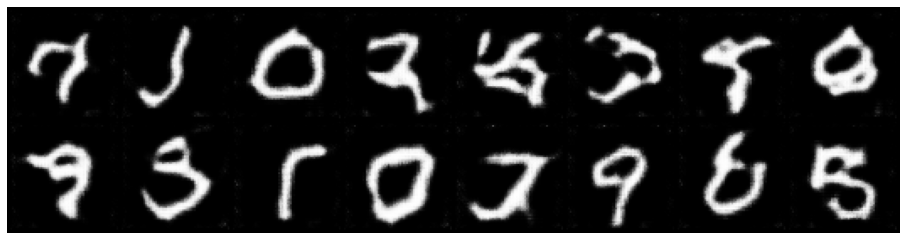

Epoch: [1/5] Batch: [2200/3750]
Loss_D: 0.2032177448272705 Loss_G: 2.813401222229004
D(x): 0.8536426424980164 D(G(z)): 0.021873442456126213


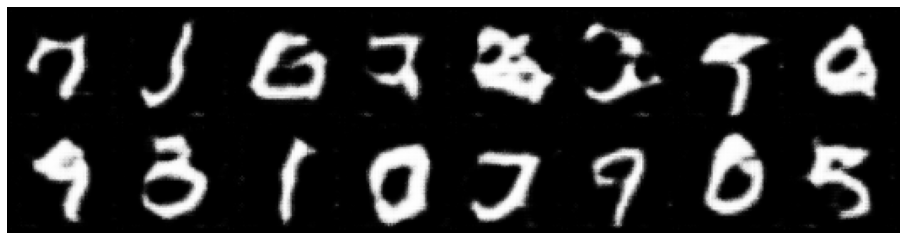

Epoch: [1/5] Batch: [2300/3750]
Loss_D: 0.8038434386253357 Loss_G: 1.2517502307891846
D(x): 0.7131500840187073 D(G(z)): 0.3437919616699219


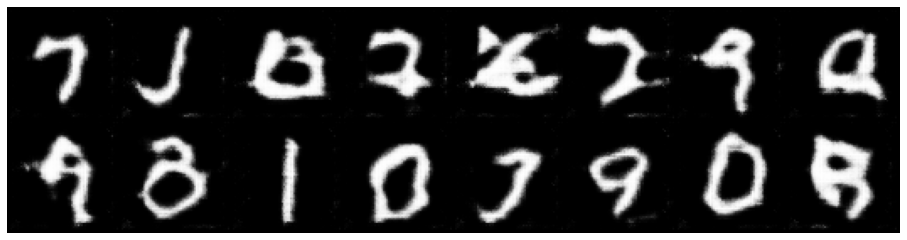

Epoch: [1/5] Batch: [2400/3750]
Loss_D: 1.5520713329315186 Loss_G: 3.3601276874542236
D(x): 0.8796495199203491 D(G(z)): 0.6715995073318481


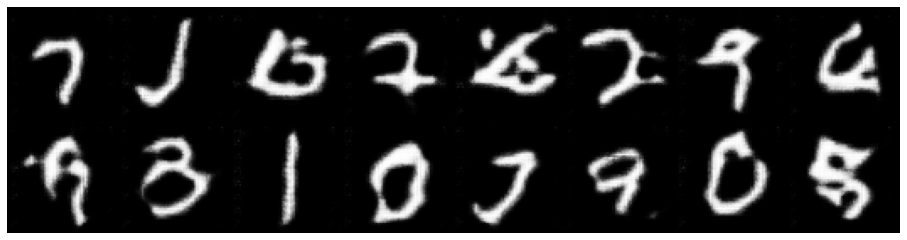

Epoch: [1/5] Batch: [2500/3750]
Loss_D: 0.28059443831443787 Loss_G: 4.619992256164551
D(x): 0.972553551197052 D(G(z)): 0.1665613055229187


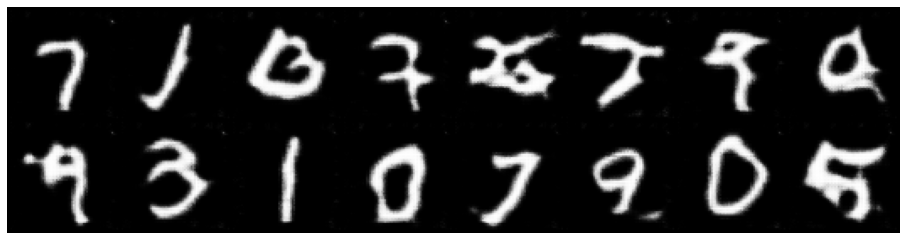

Epoch: [1/5] Batch: [2600/3750]
Loss_D: 0.8549452424049377 Loss_G: 2.1340200901031494
D(x): 0.6833909749984741 D(G(z)): 0.3119434118270874


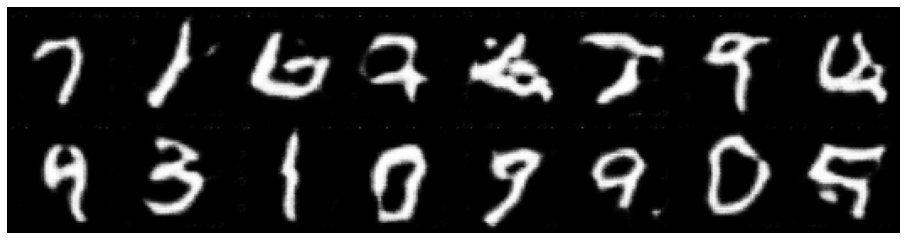

Epoch: [1/5] Batch: [2700/3750]
Loss_D: 0.19733484089374542 Loss_G: 4.402039527893066
D(x): 0.9859368801116943 D(G(z)): 0.1606055349111557


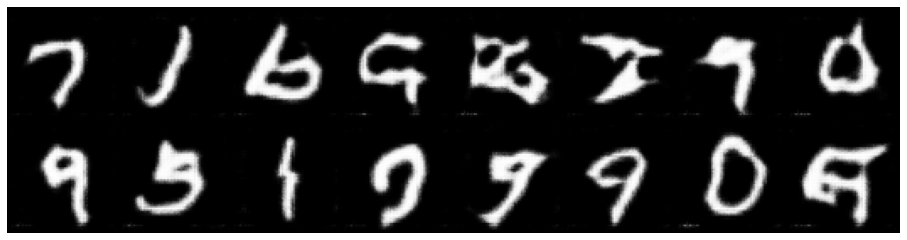

Epoch: [1/5] Batch: [2800/3750]
Loss_D: 0.4402887523174286 Loss_G: 1.9812893867492676
D(x): 0.9492553472518921 D(G(z)): 0.2950507700443268


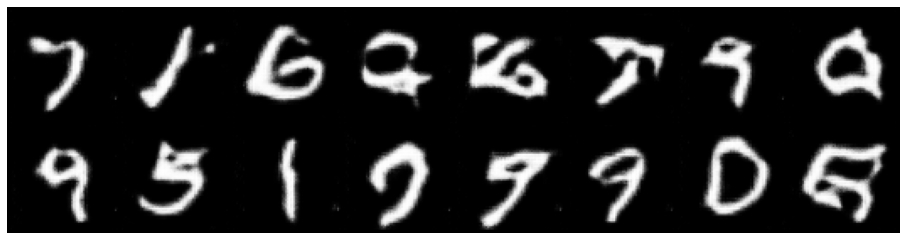

Epoch: [1/5] Batch: [2900/3750]
Loss_D: 0.14786402881145477 Loss_G: 5.107846260070801
D(x): 0.88004469871521 D(G(z)): 0.009222030639648438


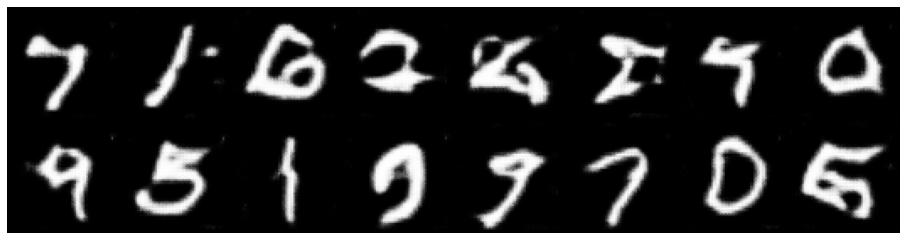

Epoch: [1/5] Batch: [3000/3750]
Loss_D: 0.18179237842559814 Loss_G: 4.407159328460693
D(x): 0.8957055807113647 D(G(z)): 0.0574733167886734


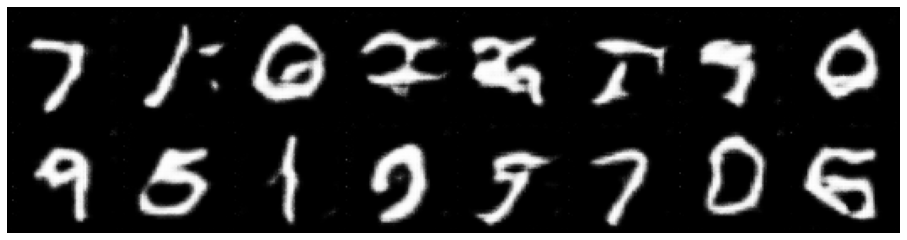

Epoch: [1/5] Batch: [3100/3750]
Loss_D: 0.028904329985380173 Loss_G: 5.527238845825195
D(x): 0.9774616956710815 D(G(z)): 0.005551842041313648


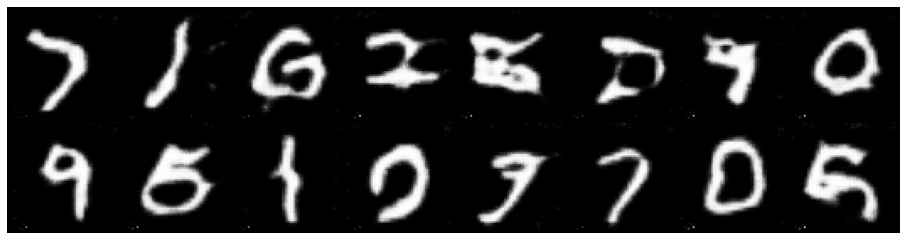

Epoch: [1/5] Batch: [3200/3750]
Loss_D: 1.9421855211257935 Loss_G: 1.5828285217285156
D(x): 0.9810155630111694 D(G(z)): 0.7235446572303772


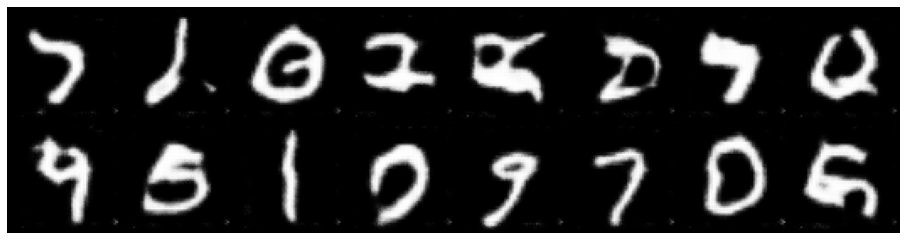

Epoch: [1/5] Batch: [3300/3750]
Loss_D: 0.21015118062496185 Loss_G: 4.794021129608154
D(x): 0.9411254525184631 D(G(z)): 0.12418502569198608


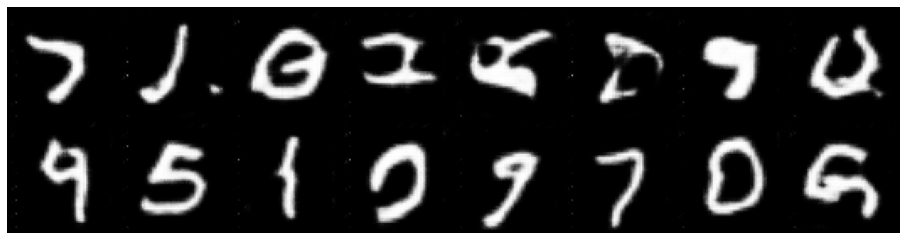

Epoch: [1/5] Batch: [3400/3750]
Loss_D: 0.5894315838813782 Loss_G: 1.7447967529296875
D(x): 0.784335732460022 D(G(z)): 0.2479911595582962


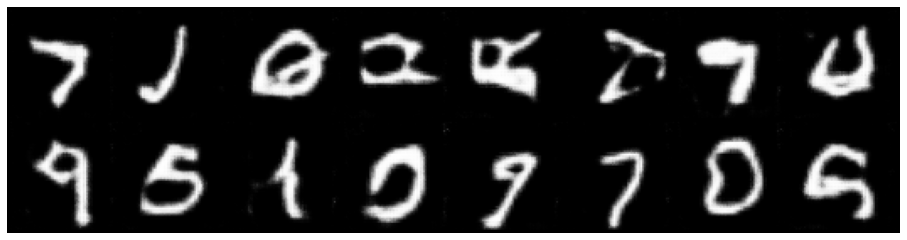

Epoch: [1/5] Batch: [3500/3750]
Loss_D: 0.40479421615600586 Loss_G: 5.6915435791015625
D(x): 0.9723848104476929 D(G(z)): 0.257768839597702


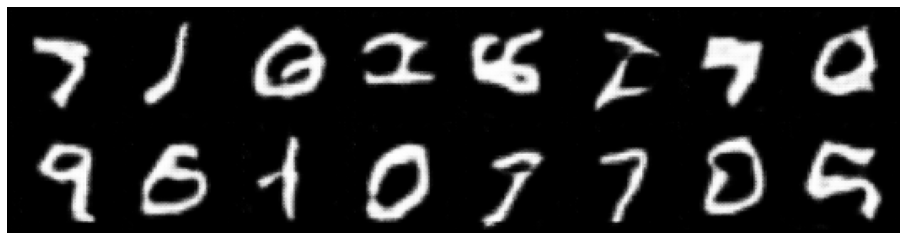

Epoch: [1/5] Batch: [3600/3750]
Loss_D: 0.2919725477695465 Loss_G: 3.8379383087158203
D(x): 0.840248703956604 D(G(z)): 0.09441675245761871


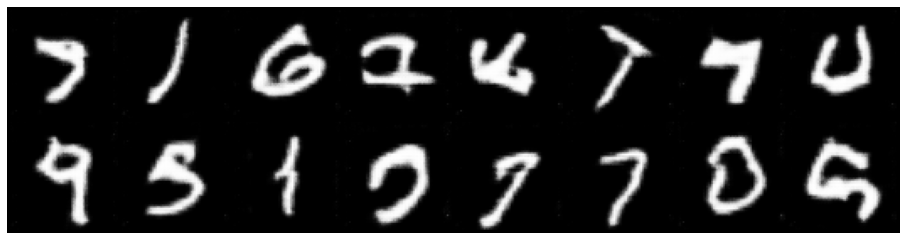

Epoch: [1/5] Batch: [3700/3750]
Loss_D: 0.385623037815094 Loss_G: 2.635948657989502
D(x): 0.7495365738868713 D(G(z)): 0.03888362646102905


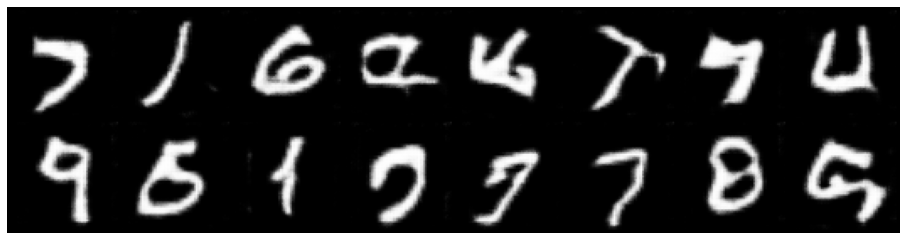

----------------------------------------
Epoch: [2/5] Batch: [0/3750]
Loss_D: 0.6669185161590576 Loss_G: 10.883310317993164
D(x): 0.9968507289886475 D(G(z)): 0.41289663314819336


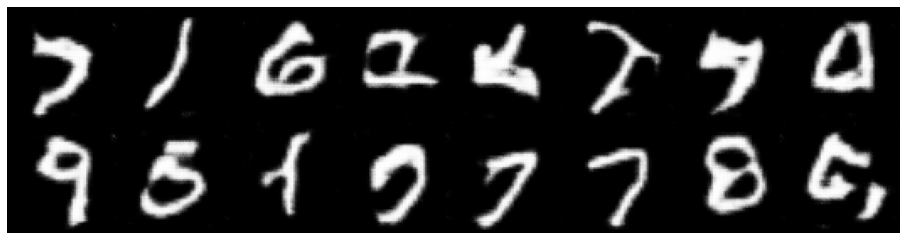

Epoch: [2/5] Batch: [100/3750]
Loss_D: 0.41126561164855957 Loss_G: 1.5126482248306274
D(x): 0.7438254356384277 D(G(z)): 0.08787121623754501


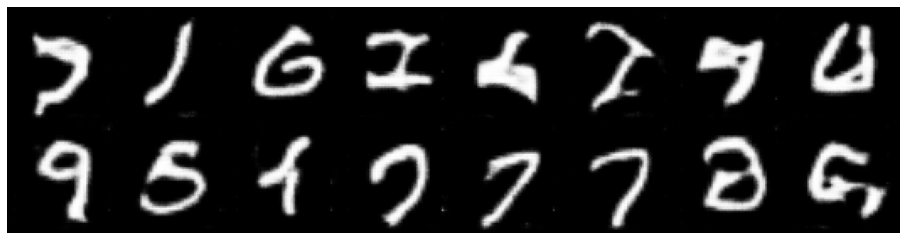

Epoch: [2/5] Batch: [200/3750]
Loss_D: 0.02331043779850006 Loss_G: 5.378966331481934
D(x): 0.9880322217941284 D(G(z)): 0.011073688045144081


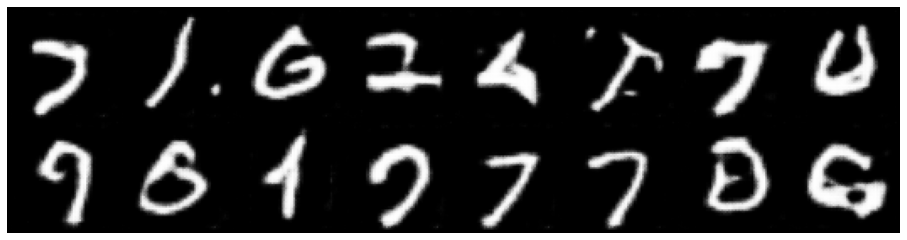

Epoch: [2/5] Batch: [300/3750]
Loss_D: 1.6617770195007324 Loss_G: 2.3570823669433594
D(x): 0.48164522647857666 D(G(z)): 0.4532242715358734


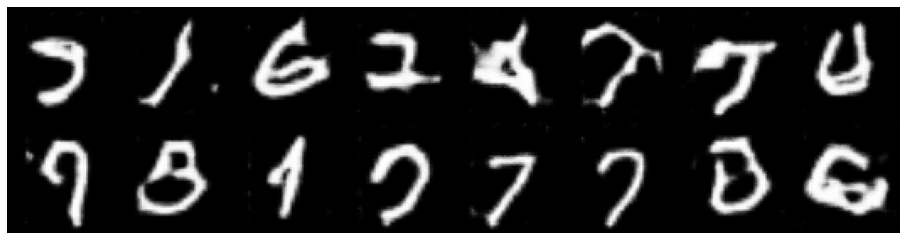

Epoch: [2/5] Batch: [400/3750]
Loss_D: 0.2644541263580322 Loss_G: 9.859935760498047
D(x): 0.9968165755271912 D(G(z)): 0.18683241307735443


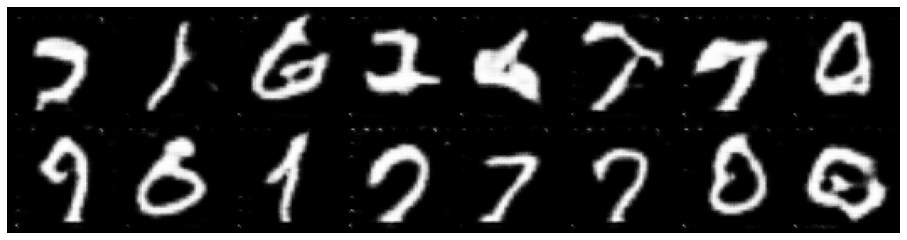

Epoch: [2/5] Batch: [500/3750]
Loss_D: 0.1867041289806366 Loss_G: 4.390684127807617
D(x): 0.9896403551101685 D(G(z)): 0.15079259872436523


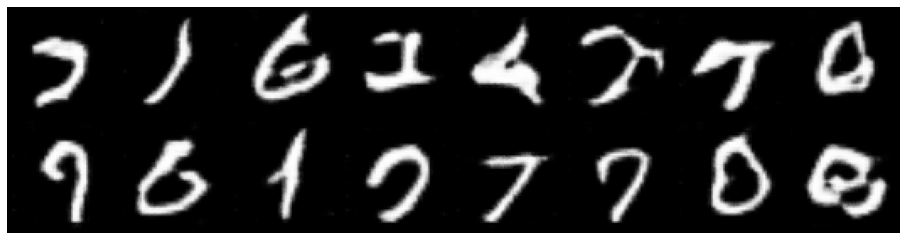

Epoch: [2/5] Batch: [600/3750]
Loss_D: 0.17942331731319427 Loss_G: 3.4941067695617676
D(x): 0.868834912776947 D(G(z)): 0.02820204198360443


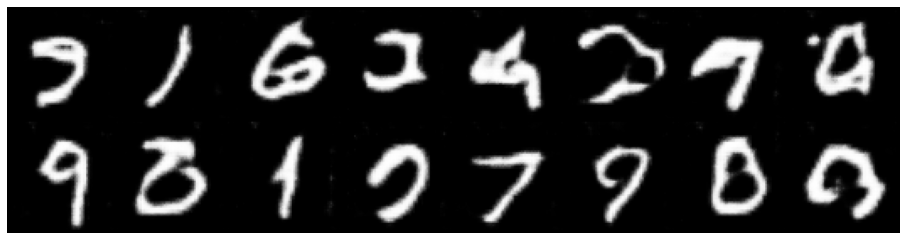

Epoch: [2/5] Batch: [700/3750]
Loss_D: 0.5297675132751465 Loss_G: 2.615455150604248
D(x): 0.6574692130088806 D(G(z)): 0.04158222675323486


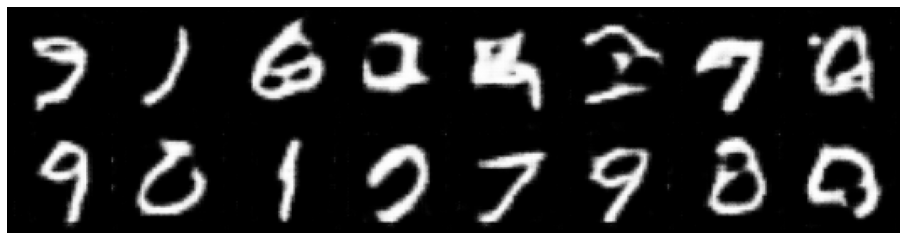

Epoch: [2/5] Batch: [800/3750]
Loss_D: 0.0339057520031929 Loss_G: 5.807706832885742
D(x): 0.976567804813385 D(G(z)): 0.009883678518235683


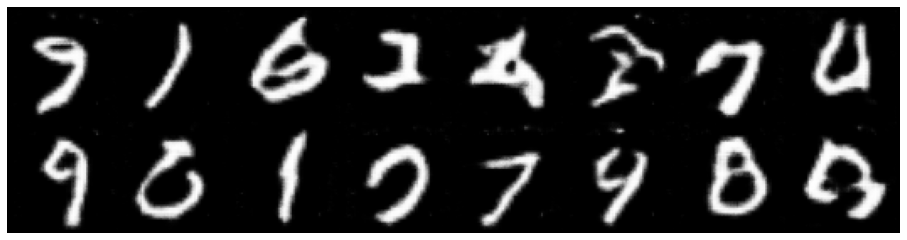

Epoch: [2/5] Batch: [900/3750]
Loss_D: 0.017316458746790886 Loss_G: 5.201846122741699
D(x): 0.9974314570426941 D(G(z)): 0.014528033323585987


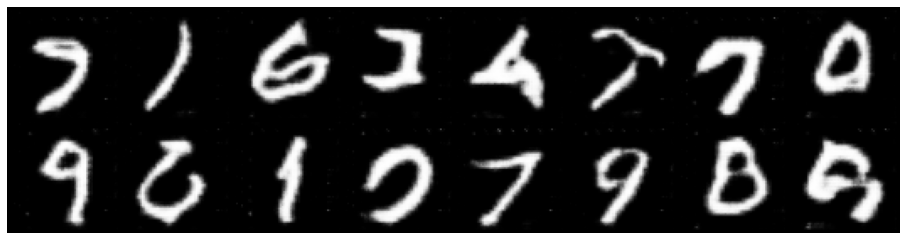

Epoch: [2/5] Batch: [1000/3750]
Loss_D: 0.05303632467985153 Loss_G: 4.768585205078125
D(x): 0.9887497425079346 D(G(z)): 0.0399012565612793


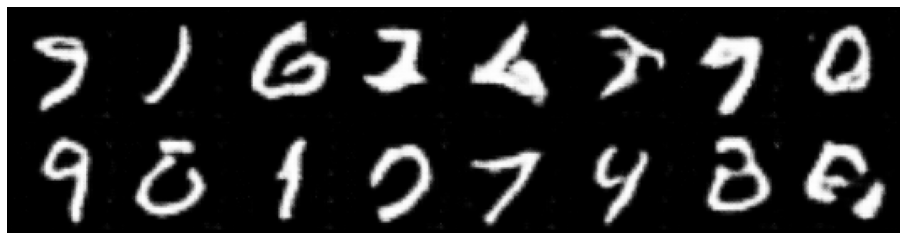

Epoch: [2/5] Batch: [1100/3750]
Loss_D: 0.7804844379425049 Loss_G: 3.8688712120056152
D(x): 0.9213356971740723 D(G(z)): 0.4353830814361572


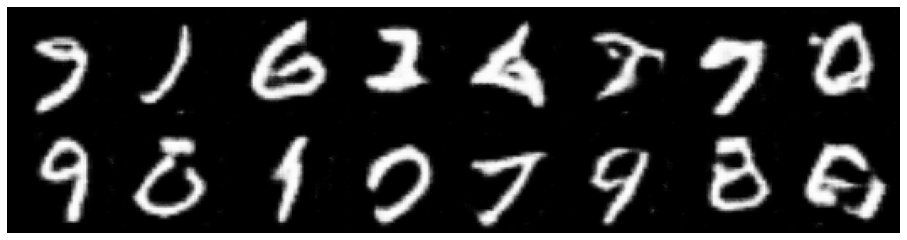

Epoch: [2/5] Batch: [1200/3750]
Loss_D: 0.3138221800327301 Loss_G: 2.237755298614502
D(x): 0.8863327503204346 D(G(z)): 0.1541770100593567


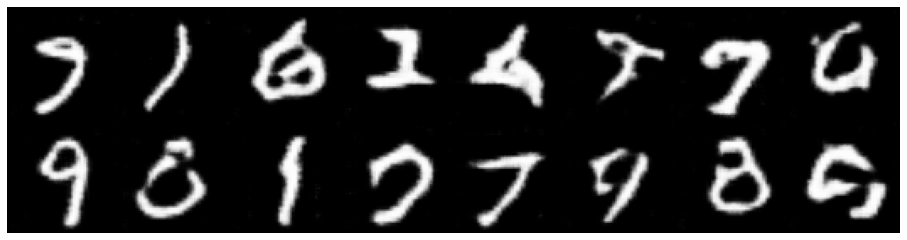

Epoch: [2/5] Batch: [1300/3750]
Loss_D: 1.2147220373153687 Loss_G: 8.169096946716309
D(x): 0.9958065152168274 D(G(z)): 0.6286346912384033


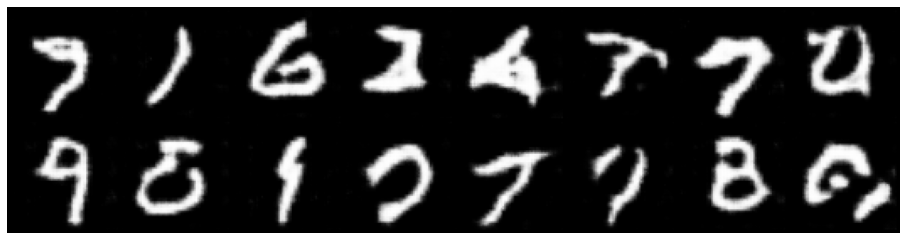

Epoch: [2/5] Batch: [1400/3750]
Loss_D: 0.012394174002110958 Loss_G: 8.882223129272461
D(x): 0.9882838726043701 D(G(z)): 0.0005359969800338149


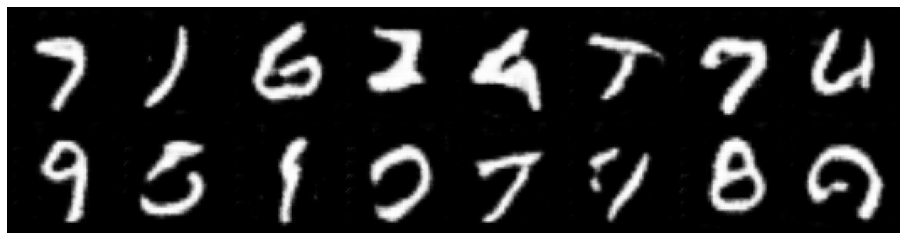

Epoch: [2/5] Batch: [1500/3750]
Loss_D: 0.01410715188831091 Loss_G: 5.8278703689575195
D(x): 0.9963417053222656 D(G(z)): 0.010288111865520477


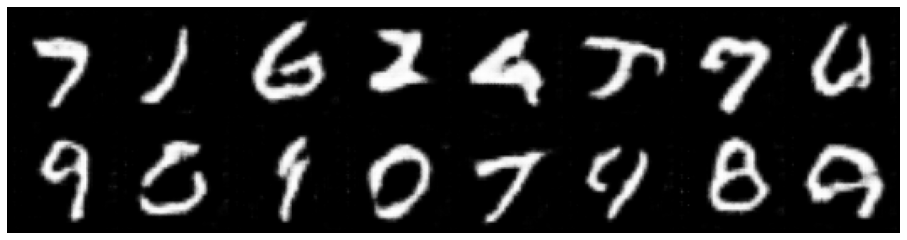

Epoch: [2/5] Batch: [1600/3750]
Loss_D: 0.010672052390873432 Loss_G: 5.667438983917236
D(x): 0.9994564056396484 D(G(z)): 0.010008273646235466


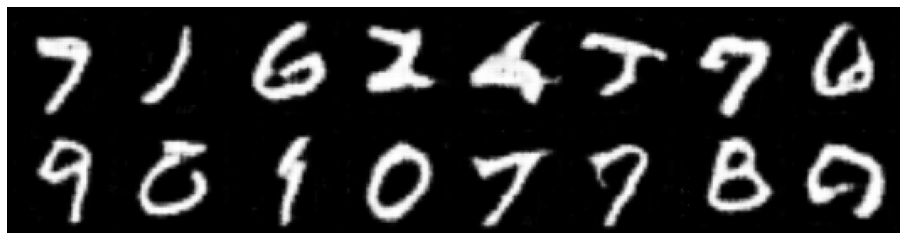

Epoch: [2/5] Batch: [1700/3750]
Loss_D: 0.2252340018749237 Loss_G: 2.5512969493865967
D(x): 0.8921405076980591 D(G(z)): 0.09630455076694489


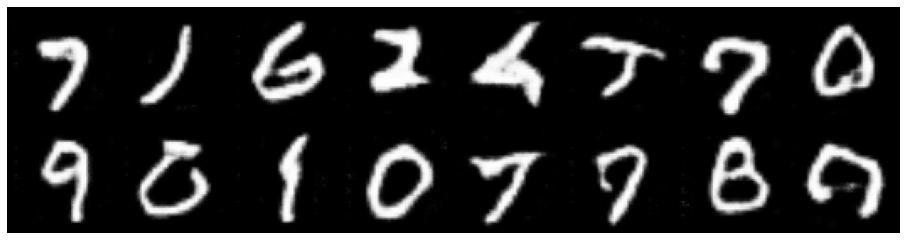

Epoch: [2/5] Batch: [1800/3750]
Loss_D: 2.267333745956421 Loss_G: 10.14370346069336
D(x): 0.9969033002853394 D(G(z)): 0.8502694368362427


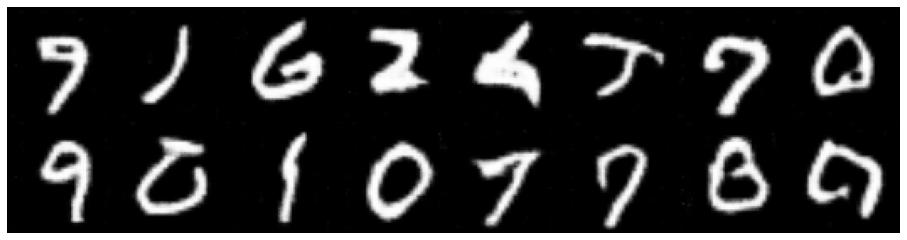

Epoch: [2/5] Batch: [1900/3750]
Loss_D: 0.2744034230709076 Loss_G: 3.4929375648498535
D(x): 0.8359392285346985 D(G(z)): 0.03604985028505325


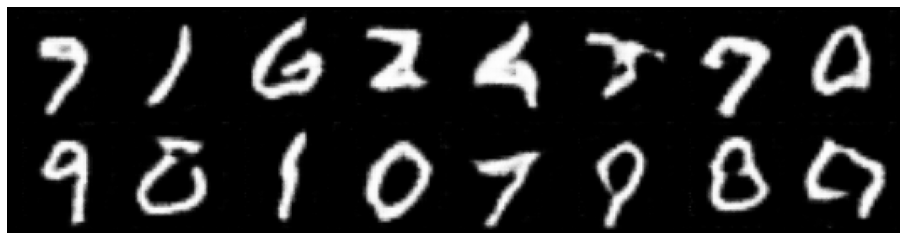

Epoch: [2/5] Batch: [2000/3750]
Loss_D: 0.07041293382644653 Loss_G: 5.316364765167236
D(x): 0.957924485206604 D(G(z)): 0.02497268281877041


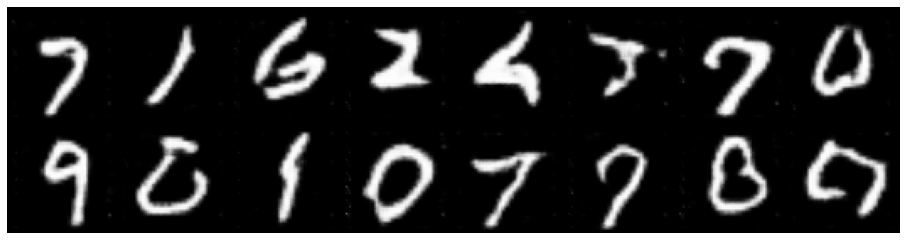

Epoch: [2/5] Batch: [2100/3750]
Loss_D: 0.366425484418869 Loss_G: 2.020965099334717
D(x): 0.7816988229751587 D(G(z)): 0.0895984023809433


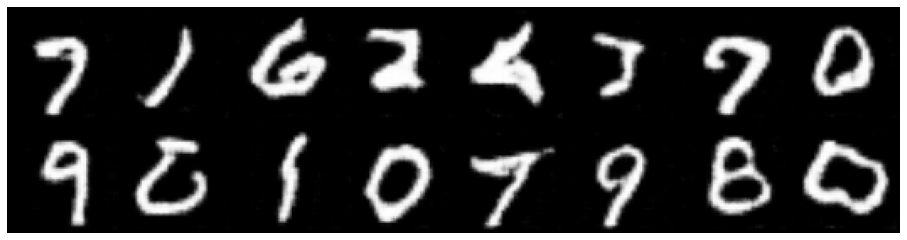

Epoch: [2/5] Batch: [2200/3750]
Loss_D: 0.018833763897418976 Loss_G: 5.55322790145874
D(x): 0.9878638982772827 D(G(z)): 0.006463446654379368


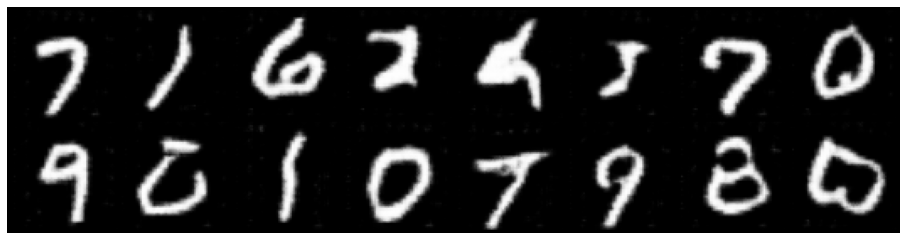

Epoch: [2/5] Batch: [2300/3750]
Loss_D: 0.03416523337364197 Loss_G: 5.776252269744873
D(x): 0.9963308572769165 D(G(z)): 0.029417965561151505


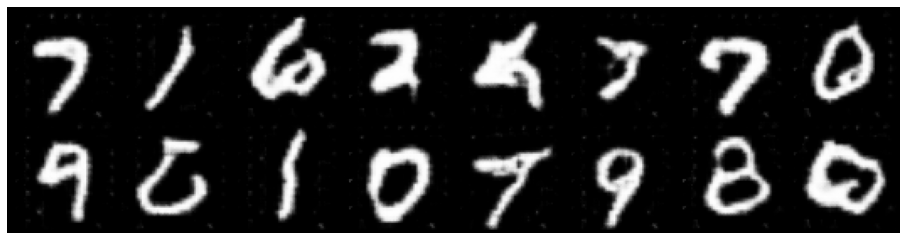

Epoch: [2/5] Batch: [2400/3750]
Loss_D: 0.9744130373001099 Loss_G: 3.856215476989746
D(x): 0.8809034824371338 D(G(z)): 0.462493360042572


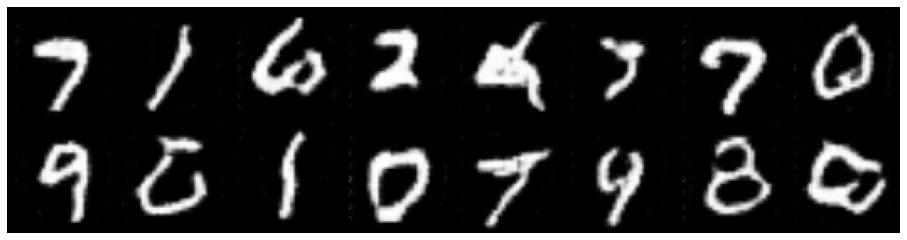

Epoch: [2/5] Batch: [2500/3750]
Loss_D: 0.49692782759666443 Loss_G: 6.4383745193481445
D(x): 0.9847186207771301 D(G(z)): 0.33485129475593567


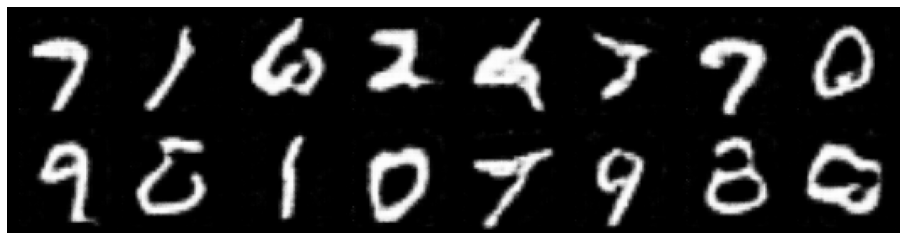

Epoch: [2/5] Batch: [2600/3750]
Loss_D: 0.8173434138298035 Loss_G: 4.627437591552734
D(x): 0.9827421307563782 D(G(z)): 0.44914138317108154


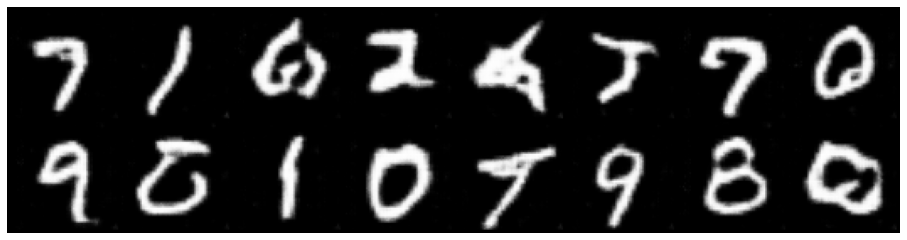

Epoch: [2/5] Batch: [2700/3750]
Loss_D: 0.11474061012268066 Loss_G: 4.560723304748535
D(x): 0.9779451489448547 D(G(z)): 0.08547867834568024


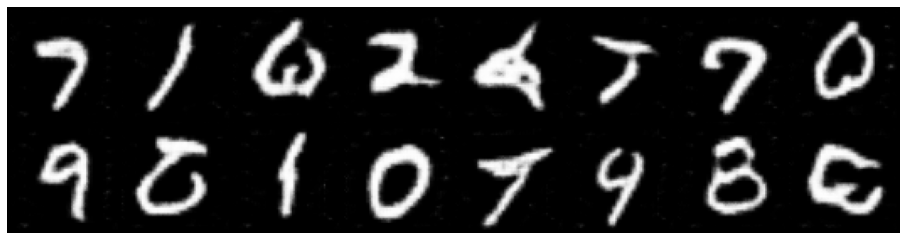

Epoch: [2/5] Batch: [2800/3750]
Loss_D: 0.052490681409835815 Loss_G: 4.187392234802246
D(x): 0.9574207067489624 D(G(z)): 0.006637210957705975


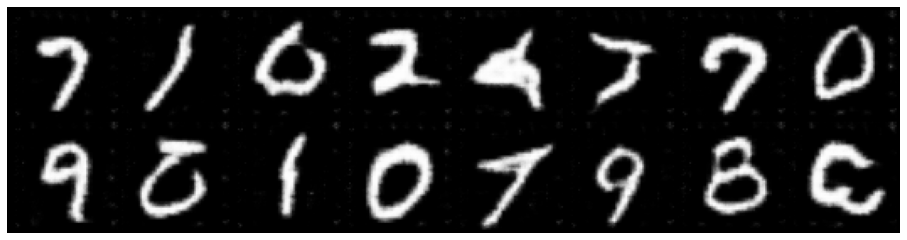

Epoch: [2/5] Batch: [2900/3750]
Loss_D: 1.1265661716461182 Loss_G: 5.645405292510986
D(x): 0.979076623916626 D(G(z)): 0.5450876951217651


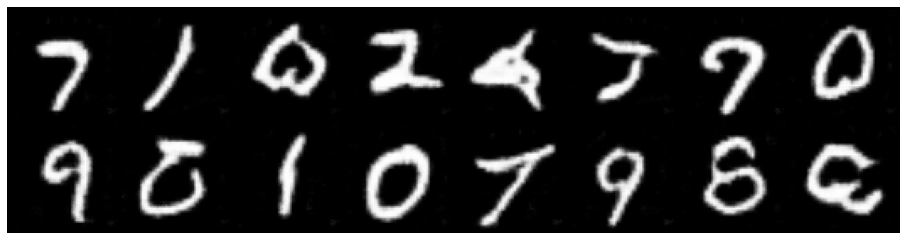

Epoch: [2/5] Batch: [3000/3750]
Loss_D: 0.2624565362930298 Loss_G: 2.4709911346435547
D(x): 0.8331637382507324 D(G(z)): 0.06549165397882462


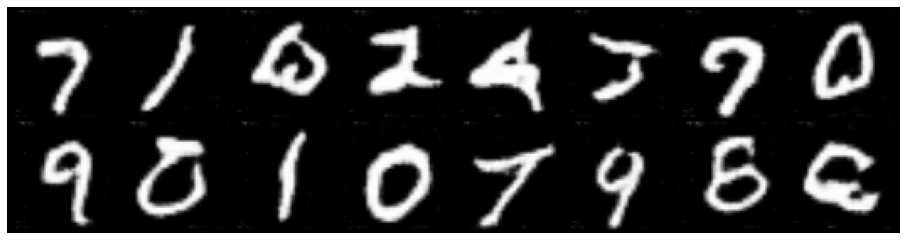

Epoch: [2/5] Batch: [3100/3750]
Loss_D: 0.012225884944200516 Loss_G: 5.910244941711426
D(x): 0.9973341822624207 D(G(z)): 0.009451139718294144


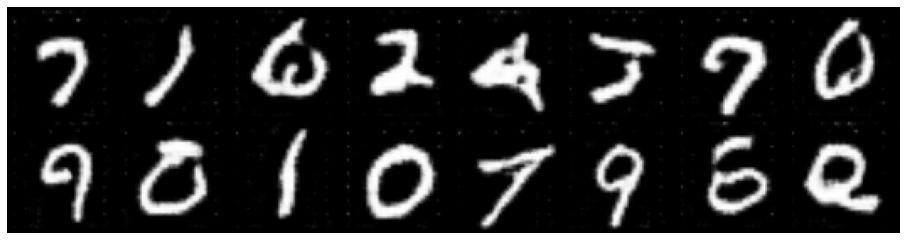

Epoch: [2/5] Batch: [3200/3750]
Loss_D: 0.10788797587156296 Loss_G: 4.271038055419922
D(x): 0.9633550047874451 D(G(z)): 0.06388285011053085


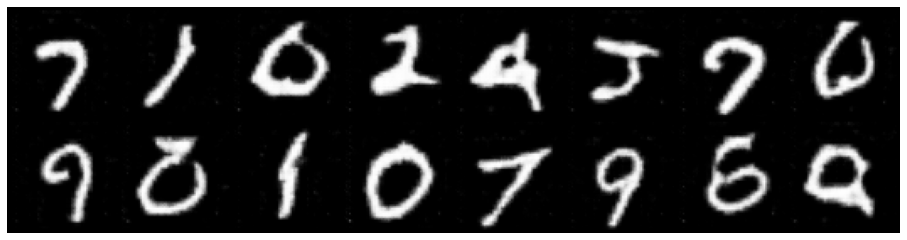

Epoch: [2/5] Batch: [3300/3750]
Loss_D: 0.7201688289642334 Loss_G: 1.808609962463379
D(x): 0.5986476540565491 D(G(z)): 0.00946078822016716


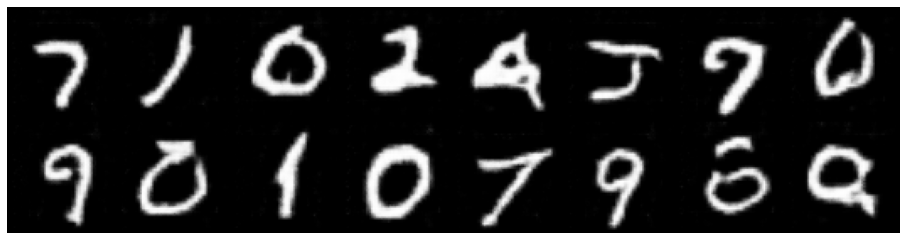

Epoch: [2/5] Batch: [3400/3750]
Loss_D: 0.15815681219100952 Loss_G: 4.846856594085693
D(x): 0.869402289390564 D(G(z)): 0.0008897195803001523


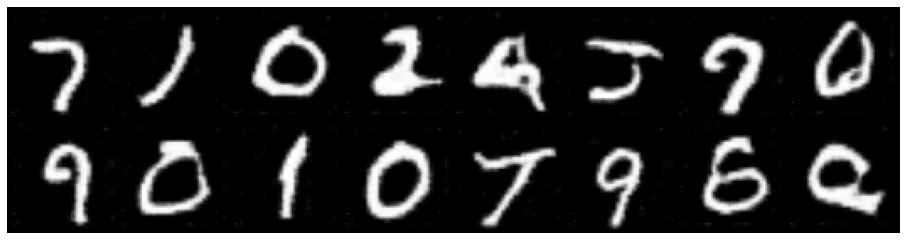

Epoch: [2/5] Batch: [3500/3750]
Loss_D: 0.007275499403476715 Loss_G: 7.558000564575195
D(x): 0.9942649602890015 D(G(z)): 0.0014964628499001265


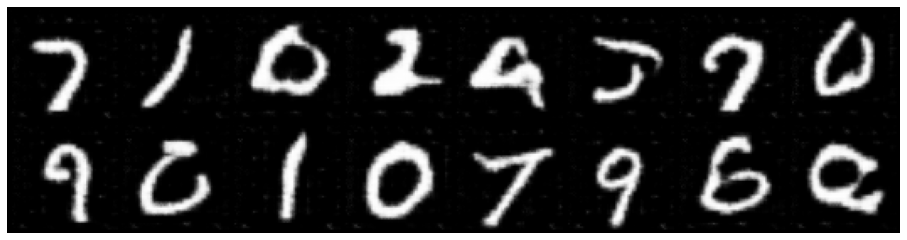

Epoch: [2/5] Batch: [3600/3750]
Loss_D: 3.1657068729400635 Loss_G: 4.996529579162598
D(x): 0.9910615682601929 D(G(z)): 0.9046733379364014


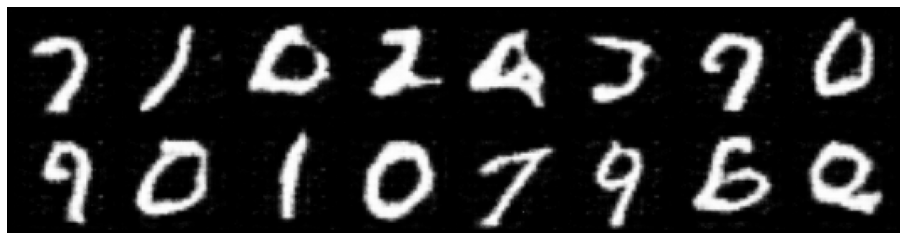

Epoch: [2/5] Batch: [3700/3750]
Loss_D: 0.5197447538375854 Loss_G: 4.435890197753906
D(x): 0.6918339133262634 D(G(z)): 0.04966406896710396


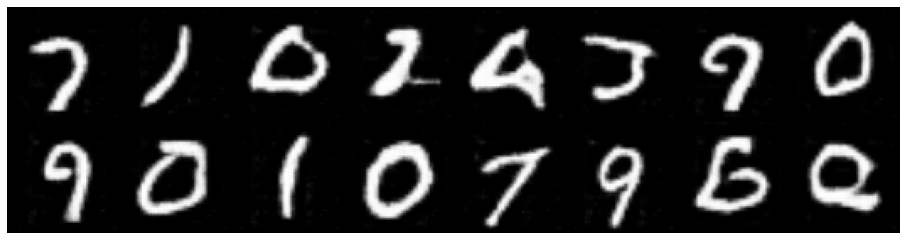

----------------------------------------
Epoch: [3/5] Batch: [0/3750]
Loss_D: 0.16387194395065308 Loss_G: 4.799178123474121
D(x): 0.9071085453033447 D(G(z)): 0.05364710092544556


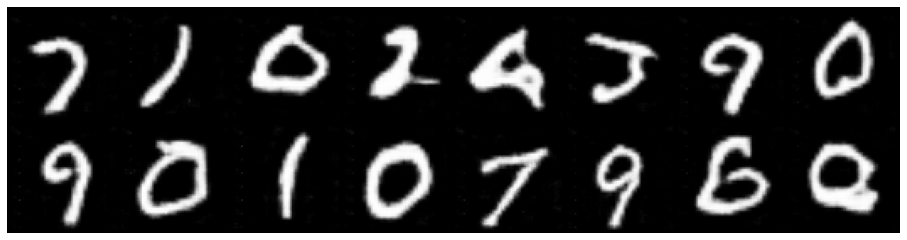

Epoch: [3/5] Batch: [100/3750]
Loss_D: 0.9397355914115906 Loss_G: 2.0487537384033203
D(x): 0.49409016966819763 D(G(z)): 0.0011276800651103258


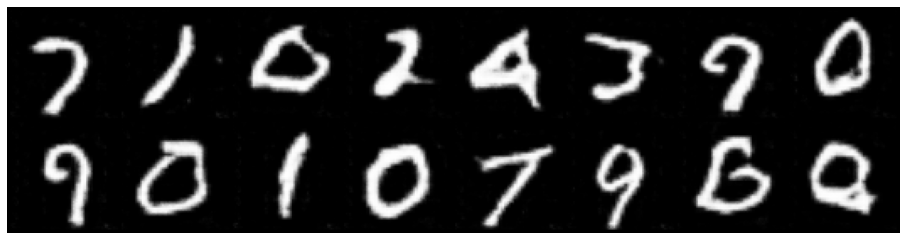

Epoch: [3/5] Batch: [200/3750]
Loss_D: 0.04964456707239151 Loss_G: 4.83515739440918
D(x): 0.9837523698806763 D(G(z)): 0.03206942230463028


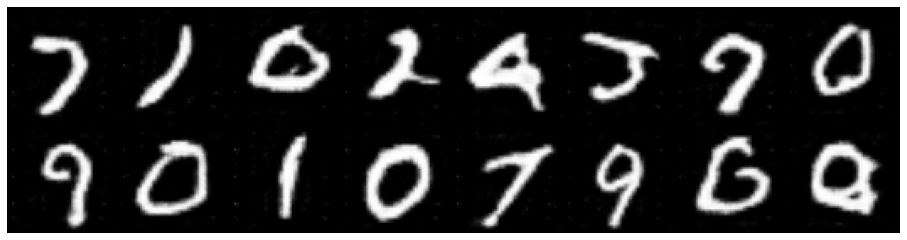

Epoch: [3/5] Batch: [300/3750]
Loss_D: 0.006964316591620445 Loss_G: 5.5456719398498535
D(x): 0.9962310791015625 D(G(z)): 0.003171008313074708


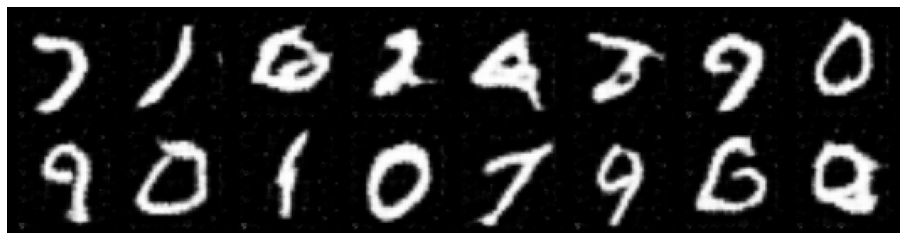

Epoch: [3/5] Batch: [400/3750]
Loss_D: 0.04048984870314598 Loss_G: 6.119800567626953
D(x): 0.9889904260635376 D(G(z)): 0.026771239936351776


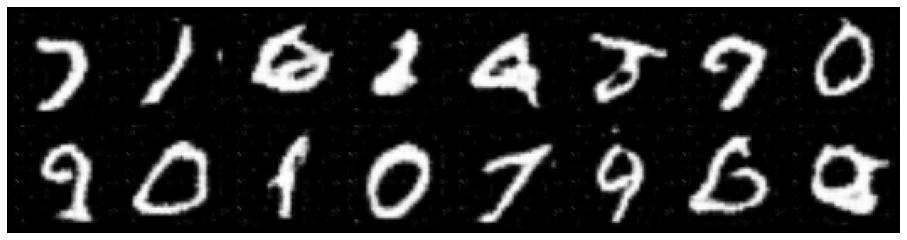

Epoch: [3/5] Batch: [500/3750]
Loss_D: 0.9346010684967041 Loss_G: 0.3075818121433258
D(x): 0.5141128897666931 D(G(z)): 0.08237859606742859


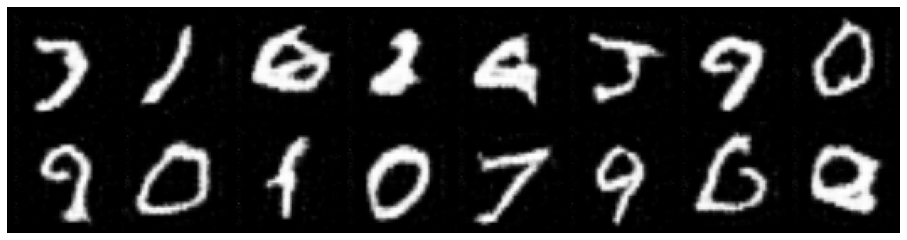

Epoch: [3/5] Batch: [600/3750]
Loss_D: 0.03073916584253311 Loss_G: 4.927915096282959
D(x): 0.9898865222930908 D(G(z)): 0.020000938326120377


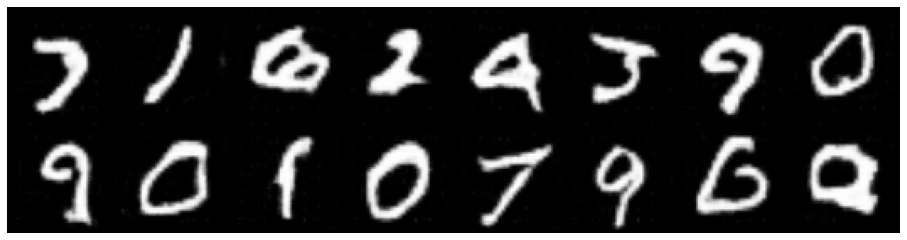

Epoch: [3/5] Batch: [700/3750]
Loss_D: 0.36535510420799255 Loss_G: 4.612008094787598
D(x): 0.9814987778663635 D(G(z)): 0.24827124178409576


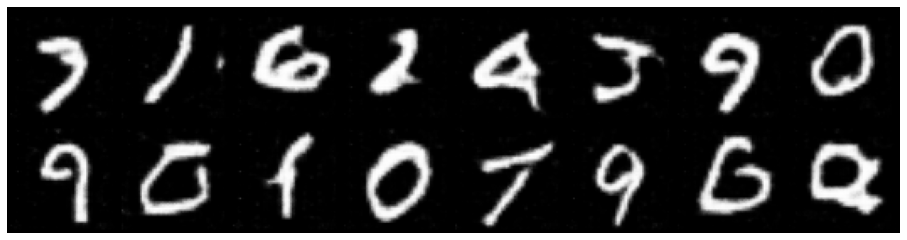

Epoch: [3/5] Batch: [800/3750]
Loss_D: 0.08572446554899216 Loss_G: 2.915463447570801
D(x): 0.9722808599472046 D(G(z)): 0.053722698241472244


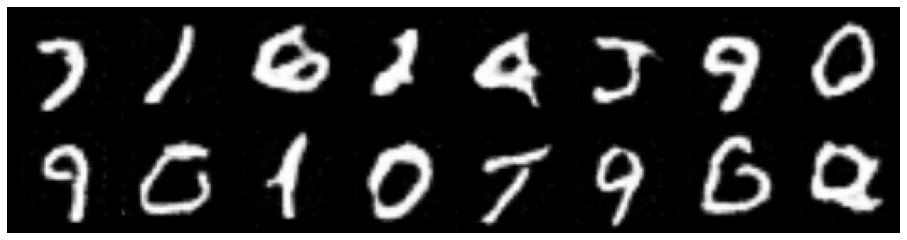

Epoch: [3/5] Batch: [900/3750]
Loss_D: 0.301769495010376 Loss_G: 6.792215347290039
D(x): 0.9983242750167847 D(G(z)): 0.2051924765110016


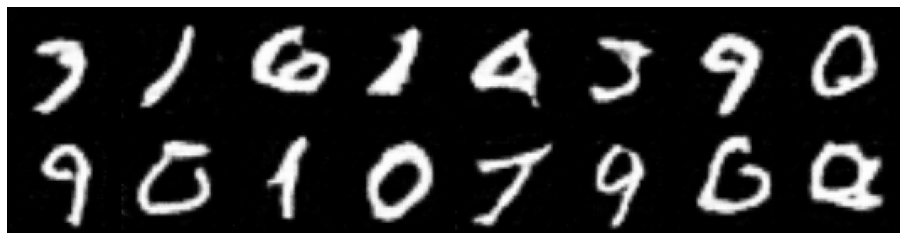

Epoch: [3/5] Batch: [1000/3750]
Loss_D: 0.34768176078796387 Loss_G: 4.841431617736816
D(x): 0.988300085067749 D(G(z)): 0.256975919008255


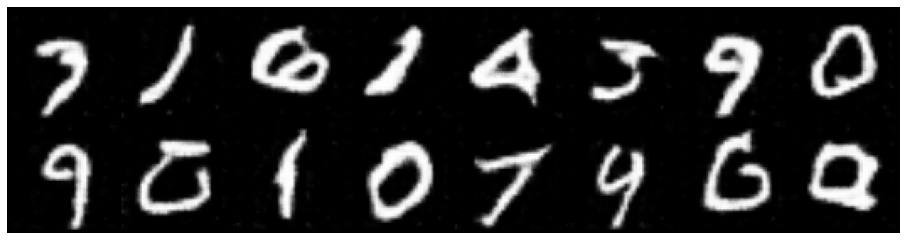

Epoch: [3/5] Batch: [1100/3750]
Loss_D: 0.06798746436834335 Loss_G: 3.9645872116088867
D(x): 0.9433584213256836 D(G(z)): 0.007411590777337551


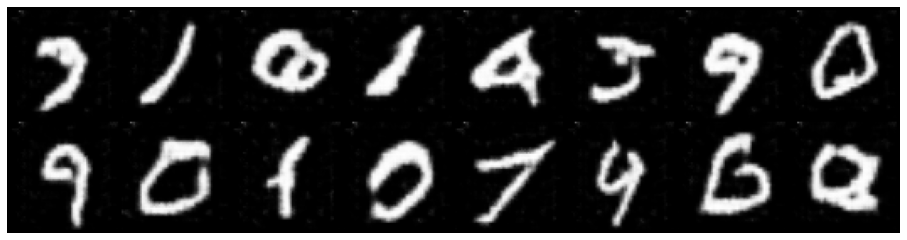

Epoch: [3/5] Batch: [1200/3750]
Loss_D: 0.15715840458869934 Loss_G: 5.302193641662598
D(x): 0.8935041427612305 D(G(z)): 0.0155855817720294


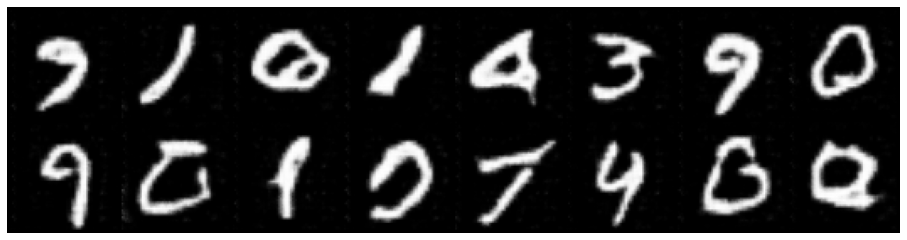

Epoch: [3/5] Batch: [1300/3750]
Loss_D: 0.0728311836719513 Loss_G: 5.064388275146484
D(x): 0.9941346645355225 D(G(z)): 0.060235604643821716


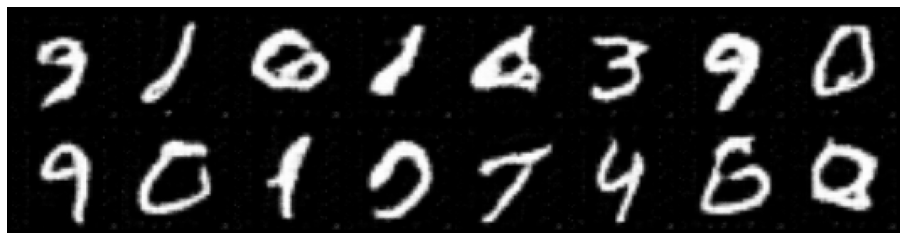

Epoch: [3/5] Batch: [1400/3750]
Loss_D: 0.016420619562268257 Loss_G: 4.304853439331055
D(x): 0.9998301267623901 D(G(z)): 0.015922874212265015


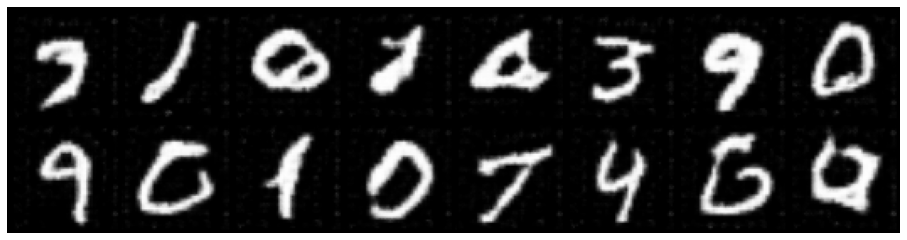

Epoch: [3/5] Batch: [1500/3750]
Loss_D: 0.043890707194805145 Loss_G: 5.123940944671631
D(x): 0.9908058643341064 D(G(z)): 0.03314036503434181


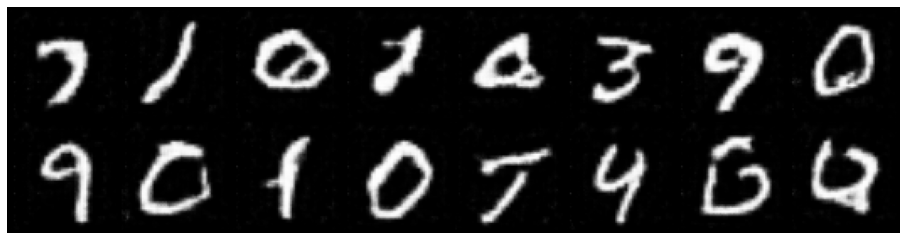

Epoch: [3/5] Batch: [1600/3750]
Loss_D: 0.14716196060180664 Loss_G: 3.5910251140594482
D(x): 0.9307452440261841 D(G(z)): 0.06567709147930145


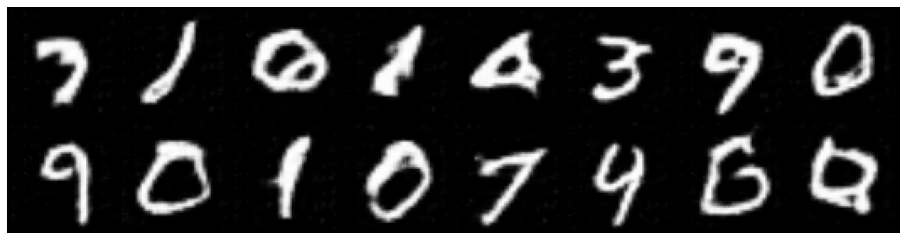

Epoch: [3/5] Batch: [1700/3750]
Loss_D: 0.14609478414058685 Loss_G: 6.104741096496582
D(x): 0.9953534603118896 D(G(z)): 0.11908422410488129


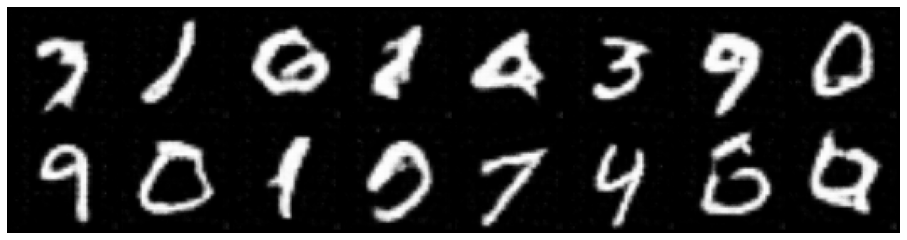

Epoch: [3/5] Batch: [1800/3750]
Loss_D: 0.06849222630262375 Loss_G: 5.775411128997803
D(x): 0.9987296462059021 D(G(z)): 0.059232667088508606


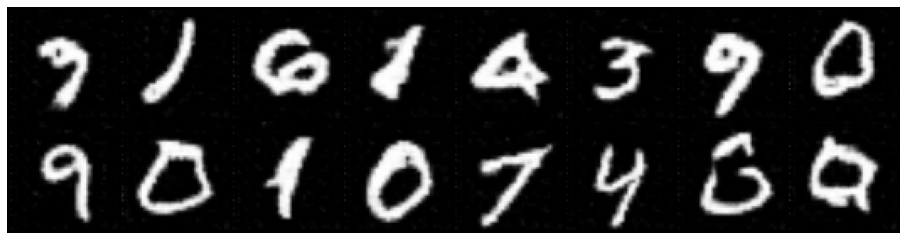

Epoch: [3/5] Batch: [1900/3750]
Loss_D: 0.06984348595142365 Loss_G: 5.698911666870117
D(x): 0.9394335150718689 D(G(z)): 0.005803005304187536


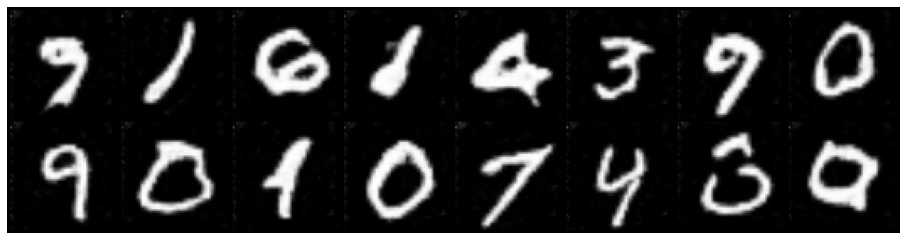

Epoch: [3/5] Batch: [2000/3750]
Loss_D: 0.01243694219738245 Loss_G: 5.743747711181641
D(x): 0.9999409914016724 D(G(z)): 0.011976356618106365


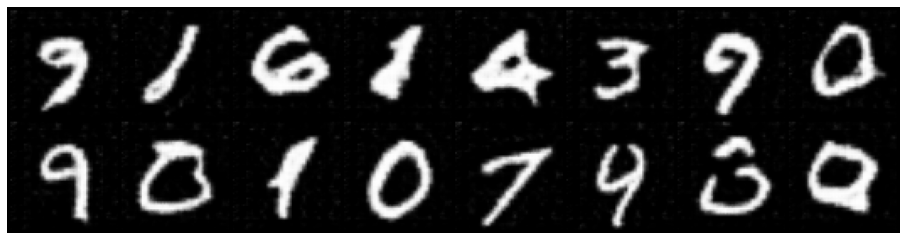

Epoch: [3/5] Batch: [2100/3750]
Loss_D: 0.23456111550331116 Loss_G: 4.844947814941406
D(x): 0.811484694480896 D(G(z)): 0.0015826912131160498


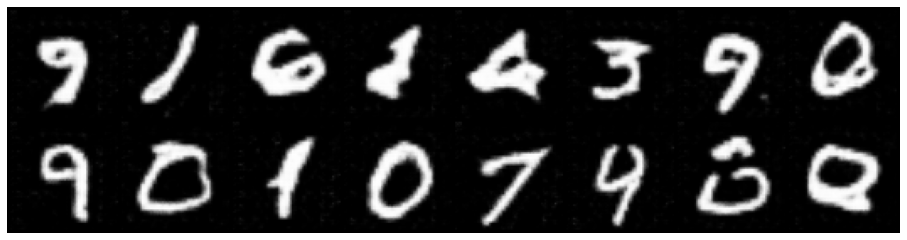

Epoch: [3/5] Batch: [2200/3750]
Loss_D: 0.36105090379714966 Loss_G: 2.7278451919555664
D(x): 0.8311071395874023 D(G(z)): 0.1179952323436737


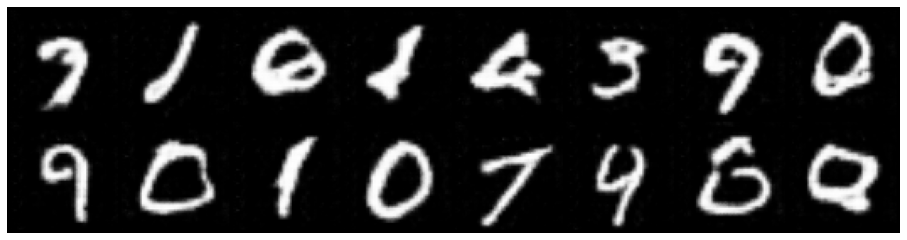

Epoch: [3/5] Batch: [2300/3750]
Loss_D: 0.08121383190155029 Loss_G: 7.692196369171143
D(x): 0.9257347583770752 D(G(z)): 0.0006372109055519104


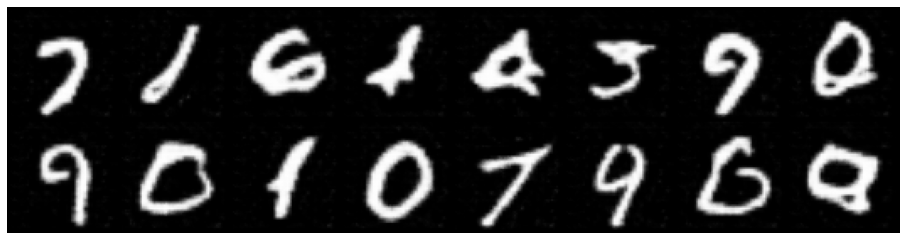

Epoch: [3/5] Batch: [2400/3750]
Loss_D: 0.003428984899073839 Loss_G: 7.538189888000488
D(x): 0.9989331960678101 D(G(z)): 0.002352581825107336


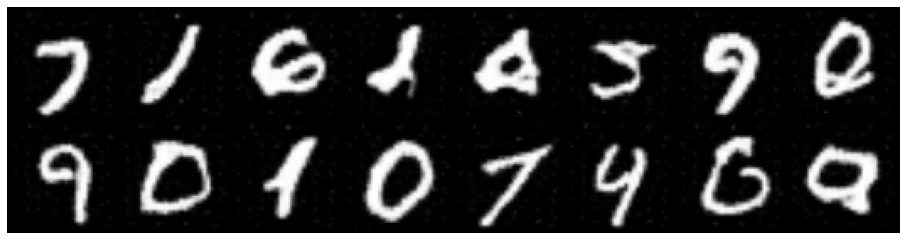

Epoch: [3/5] Batch: [2500/3750]
Loss_D: 0.10536817461252213 Loss_G: 4.215275764465332
D(x): 0.9959385991096497 D(G(z)): 0.08913181722164154


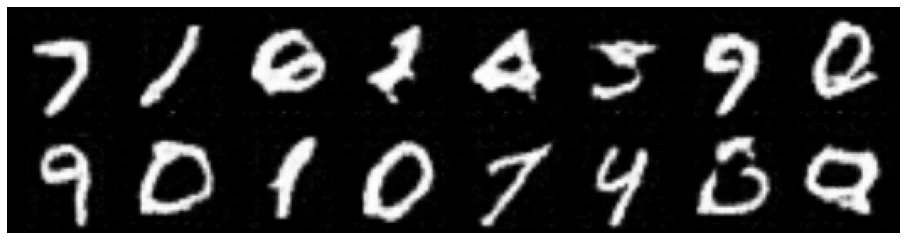

Epoch: [3/5] Batch: [2600/3750]
Loss_D: 0.14119721949100494 Loss_G: 4.913098335266113
D(x): 0.9809173345565796 D(G(z)): 0.10944179445505142


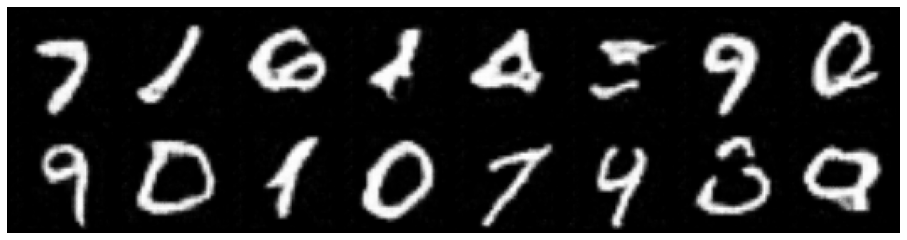

Epoch: [3/5] Batch: [2700/3750]
Loss_D: 0.0458790548145771 Loss_G: 7.547146797180176
D(x): 0.9570589065551758 D(G(z)): 0.0003900688898283988


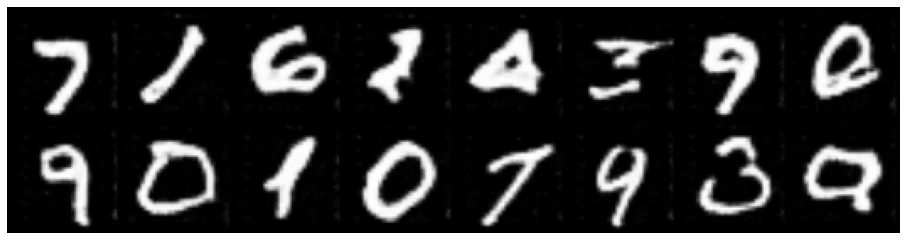

Epoch: [3/5] Batch: [2800/3750]
Loss_D: 0.01252330094575882 Loss_G: 9.470915794372559
D(x): 0.9879242777824402 D(G(z)): 0.0001779465383151546


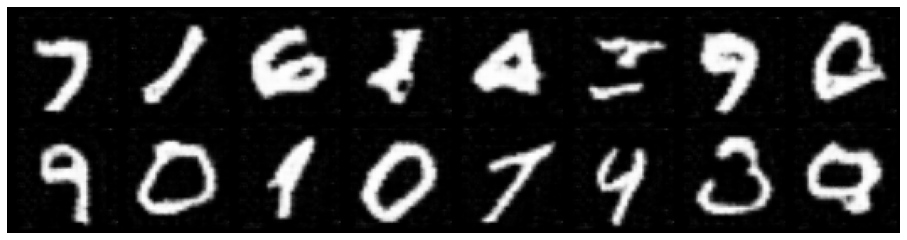

Epoch: [3/5] Batch: [2900/3750]
Loss_D: 0.05898195132613182 Loss_G: 5.496912002563477
D(x): 0.9470657706260681 D(G(z)): 0.0025943368673324585


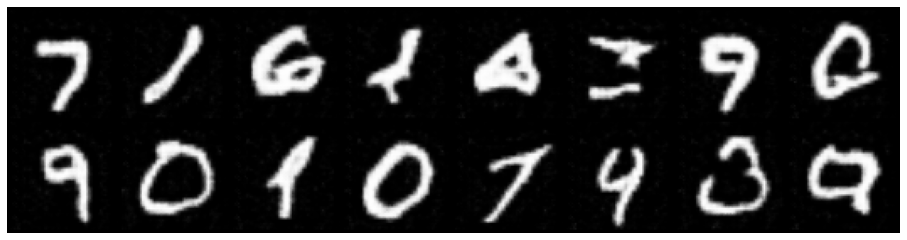

Epoch: [3/5] Batch: [3000/3750]
Loss_D: 0.01196567714214325 Loss_G: 6.850547790527344
D(x): 0.9892113208770752 D(G(z)): 0.001021081581711769


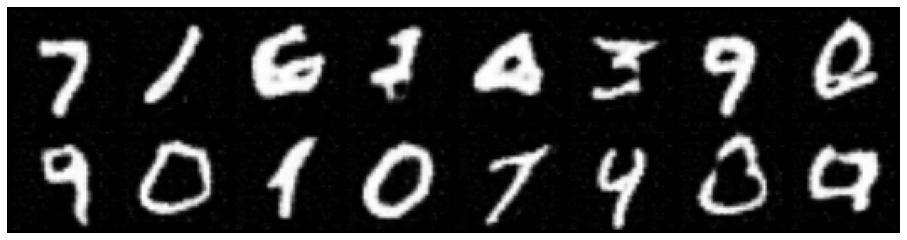

Epoch: [3/5] Batch: [3100/3750]
Loss_D: 0.01346212811768055 Loss_G: 5.854610443115234
D(x): 0.9936628341674805 D(G(z)): 0.006983826402574778


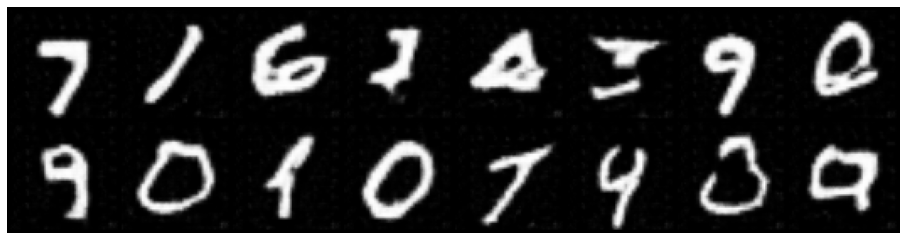

Epoch: [3/5] Batch: [3200/3750]
Loss_D: 0.008237846195697784 Loss_G: 6.61777400970459
D(x): 0.9961442351341248 D(G(z)): 0.004333148244768381


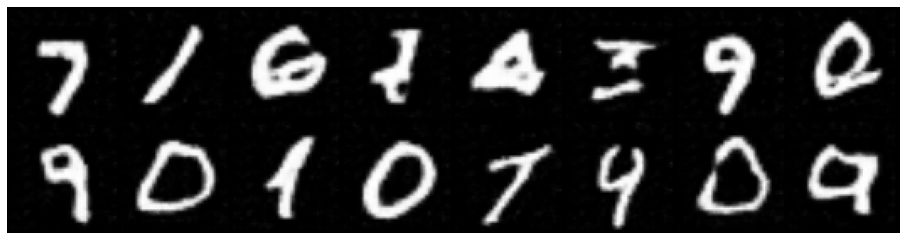

Epoch: [3/5] Batch: [3300/3750]
Loss_D: 0.004617350175976753 Loss_G: 6.623016834259033
D(x): 0.9987077116966248 D(G(z)): 0.0033101183362305164


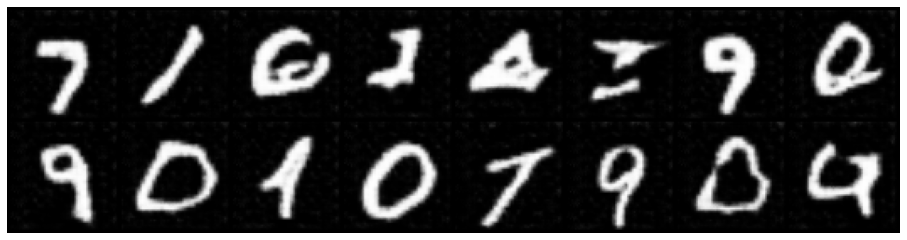

Epoch: [3/5] Batch: [3400/3750]
Loss_D: 0.01371057704091072 Loss_G: 6.633608818054199
D(x): 0.9946819543838501 D(G(z)): 0.008221779018640518


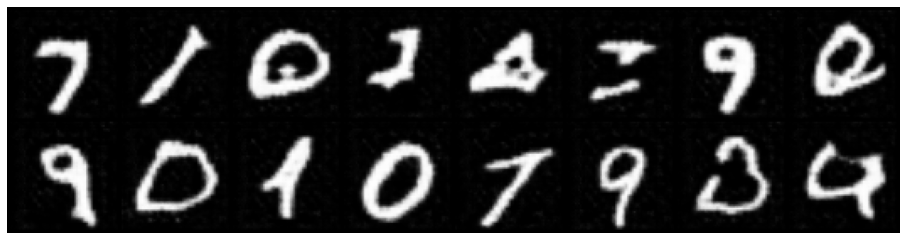

Epoch: [3/5] Batch: [3500/3750]
Loss_D: 0.5811640024185181 Loss_G: 2.2415995597839355
D(x): 0.7211791276931763 D(G(z)): 0.17953987419605255


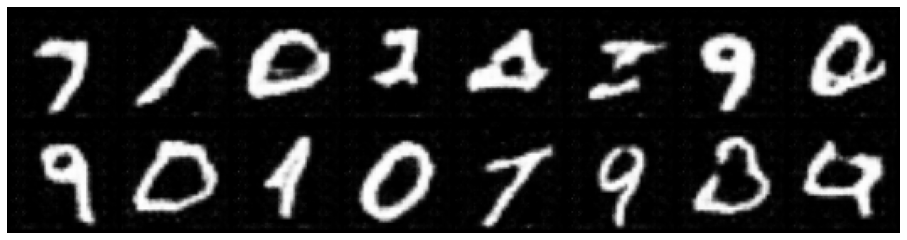

Epoch: [3/5] Batch: [3600/3750]
Loss_D: 0.5197528004646301 Loss_G: 5.005056381225586
D(x): 0.8473125696182251 D(G(z)): 0.21114525198936462


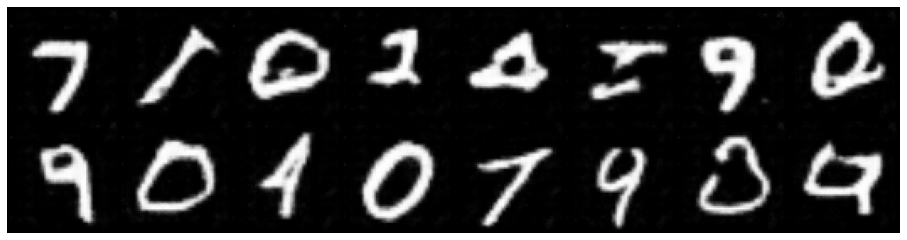

Epoch: [3/5] Batch: [3700/3750]
Loss_D: 0.34780749678611755 Loss_G: 3.672935962677002
D(x): 0.7728431224822998 D(G(z)): 0.020814599469304085


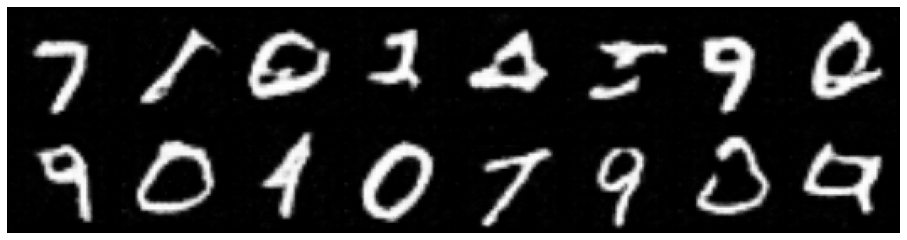

----------------------------------------
Epoch: [4/5] Batch: [0/3750]
Loss_D: 0.1654176414012909 Loss_G: 1.933556079864502
D(x): 0.9678325057029724 D(G(z)): 0.11246177554130554


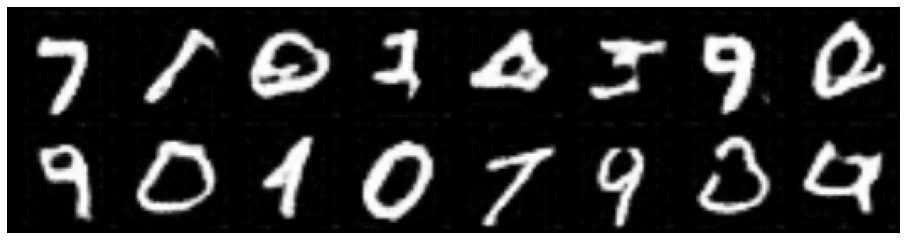

Epoch: [4/5] Batch: [100/3750]
Loss_D: 0.15876314043998718 Loss_G: 6.210324287414551
D(x): 0.9875749349594116 D(G(z)): 0.12399980425834656


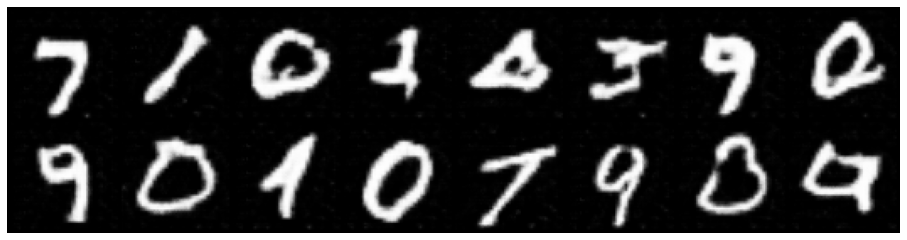

Epoch: [4/5] Batch: [200/3750]
Loss_D: 0.3249877989292145 Loss_G: 3.7514472007751465
D(x): 0.9510228633880615 D(G(z)): 0.19688105583190918


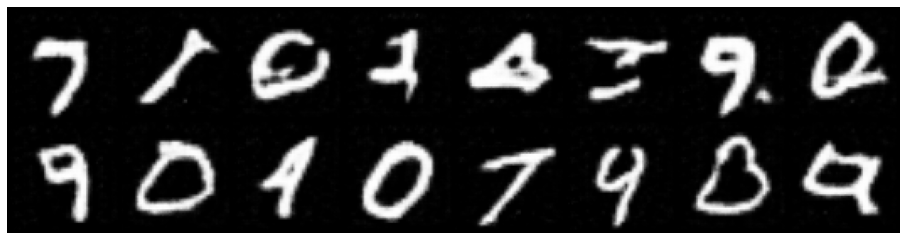

Epoch: [4/5] Batch: [300/3750]
Loss_D: 0.04418036714196205 Loss_G: 4.642394065856934
D(x): 0.9886621236801147 D(G(z)): 0.03056000918149948


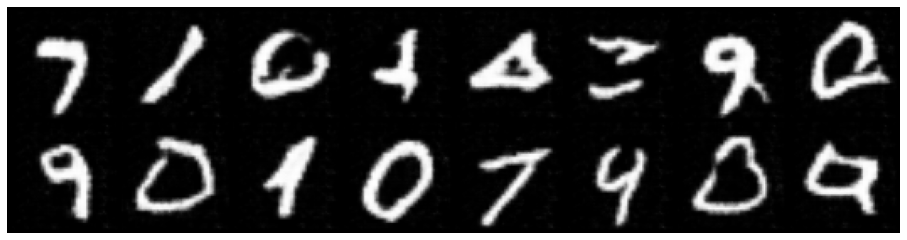

Epoch: [4/5] Batch: [400/3750]
Loss_D: 0.09163229167461395 Loss_G: 5.469228744506836
D(x): 0.9907529950141907 D(G(z)): 0.07497961074113846


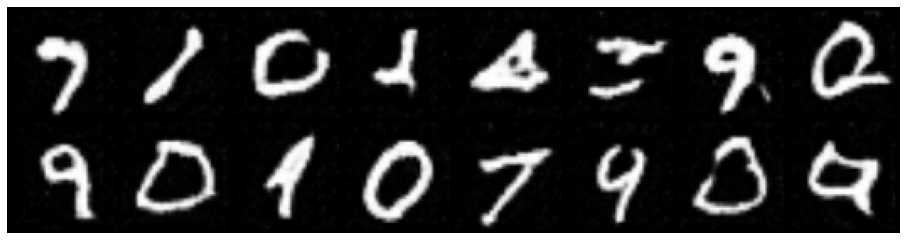

Epoch: [4/5] Batch: [500/3750]
Loss_D: 0.17673435807228088 Loss_G: 4.407768249511719
D(x): 0.9936305284500122 D(G(z)): 0.1474381685256958


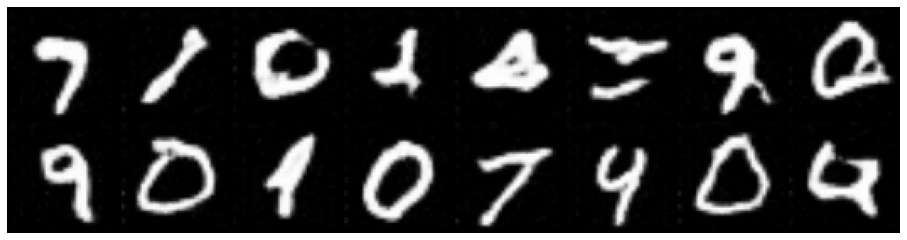

Epoch: [4/5] Batch: [600/3750]
Loss_D: 0.009460988454520702 Loss_G: 5.931659698486328
D(x): 0.9931981563568115 D(G(z)): 0.002568027703091502


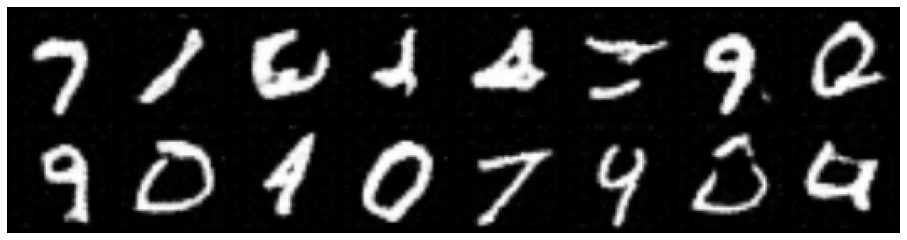

Epoch: [4/5] Batch: [700/3750]
Loss_D: 0.07918696850538254 Loss_G: 3.82500958442688
D(x): 0.9895730018615723 D(G(z)): 0.06426297128200531


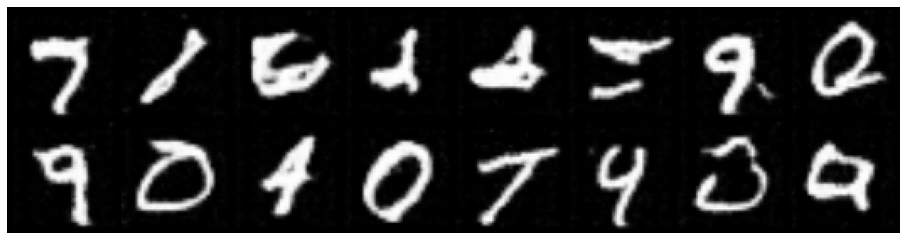

Epoch: [4/5] Batch: [800/3750]
Loss_D: 0.10348767787218094 Loss_G: 5.337239742279053
D(x): 0.9875138401985168 D(G(z)): 0.07974668592214584


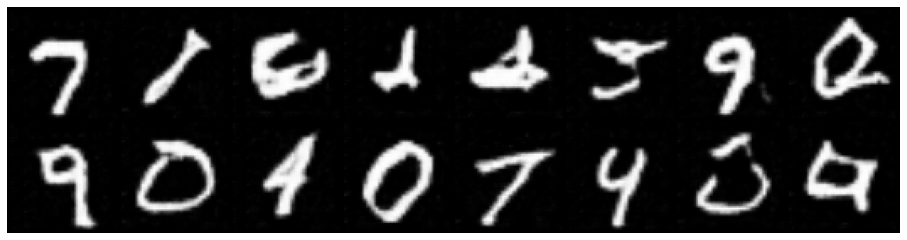

Epoch: [4/5] Batch: [900/3750]
Loss_D: 0.006299986038357019 Loss_G: 6.560015678405762
D(x): 0.9982098340988159 D(G(z)): 0.004483044613152742


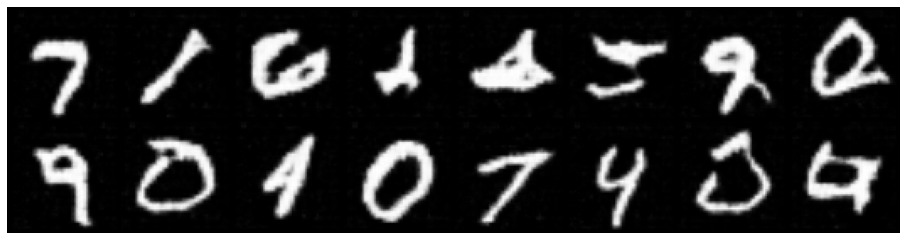

Epoch: [4/5] Batch: [1000/3750]
Loss_D: 0.04279683902859688 Loss_G: 5.401440620422363
D(x): 0.9998980760574341 D(G(z)): 0.041320133954286575


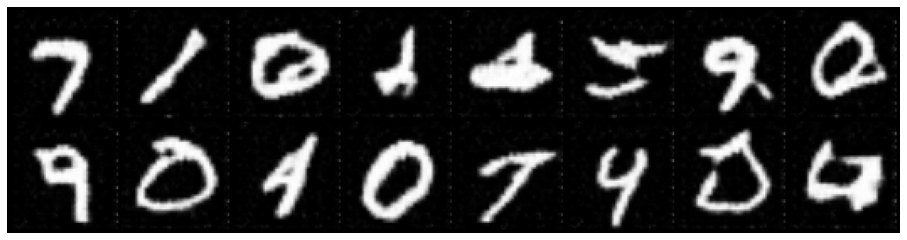

Epoch: [4/5] Batch: [1100/3750]
Loss_D: 0.012821443378925323 Loss_G: 6.862144470214844
D(x): 0.9885187745094299 D(G(z)): 0.00109868252184242


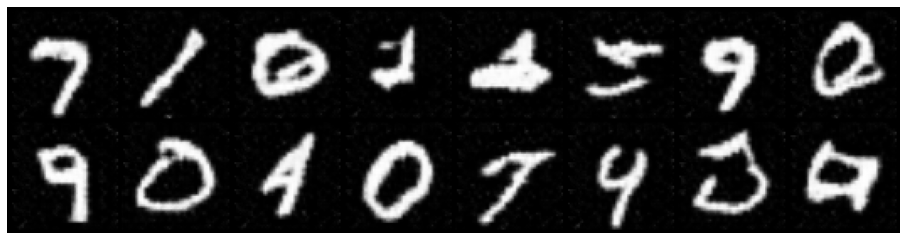

Epoch: [4/5] Batch: [1200/3750]
Loss_D: 0.016925018280744553 Loss_G: 5.362058639526367
D(x): 0.9887768030166626 D(G(z)): 0.0055788978934288025


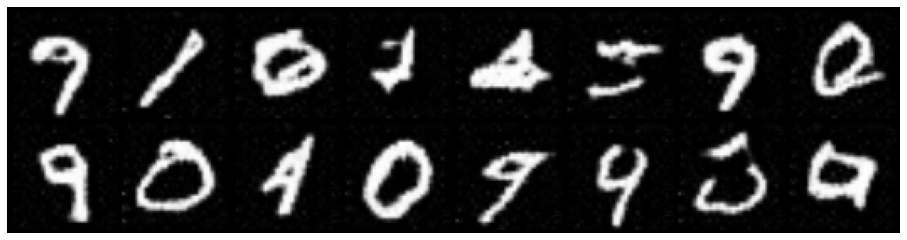

Epoch: [4/5] Batch: [1300/3750]
Loss_D: 0.04013486206531525 Loss_G: 4.946164131164551
D(x): 0.9727219939231873 D(G(z)): 0.012046441435813904


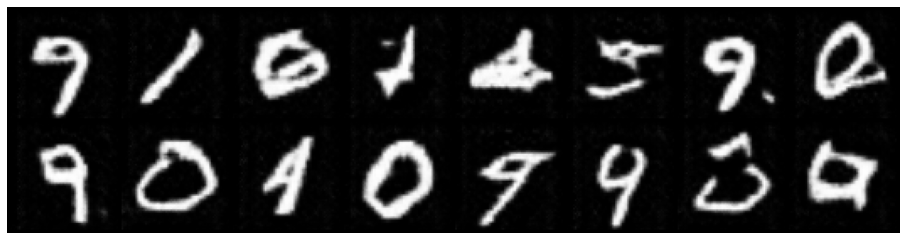

Epoch: [4/5] Batch: [1400/3750]
Loss_D: 0.7172762155532837 Loss_G: 3.2814722061157227
D(x): 0.6088845133781433 D(G(z)): 0.019153378903865814


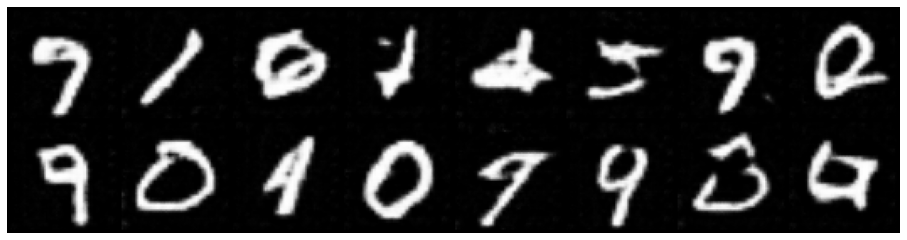

Epoch: [4/5] Batch: [1500/3750]
Loss_D: 0.03775645047426224 Loss_G: 5.0244598388671875
D(x): 0.9773856401443481 D(G(z)): 0.013913817703723907


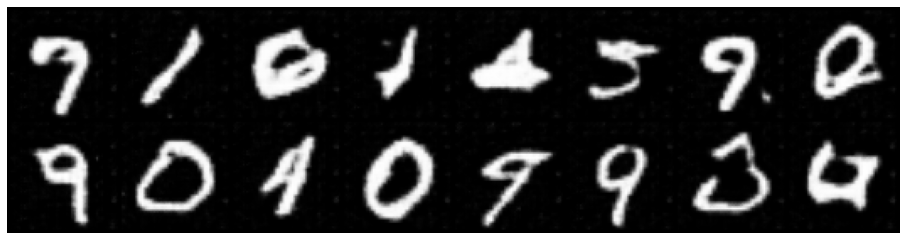

Epoch: [4/5] Batch: [1600/3750]
Loss_D: 0.006420391611754894 Loss_G: 6.524872303009033
D(x): 0.9959044456481934 D(G(z)): 0.00230757100507617


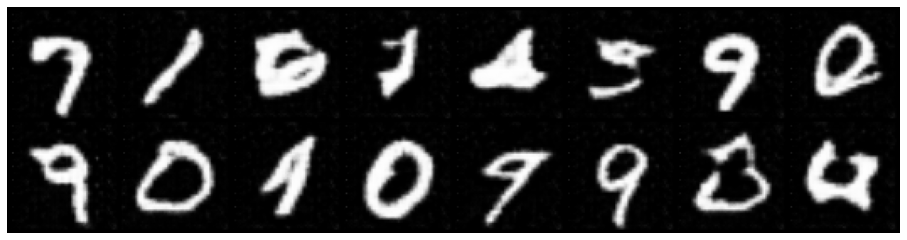

Epoch: [4/5] Batch: [1700/3750]
Loss_D: 0.045217279344797134 Loss_G: 5.069668769836426
D(x): 0.9770321846008301 D(G(z)): 0.020125562325119972


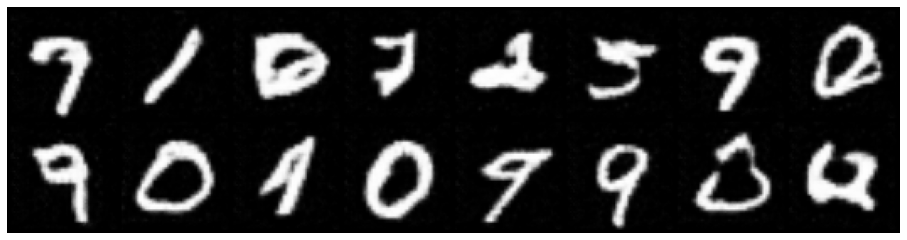

Epoch: [4/5] Batch: [1800/3750]
Loss_D: 0.4807608425617218 Loss_G: 1.6845860481262207
D(x): 0.7157149910926819 D(G(z)): 0.06739935278892517


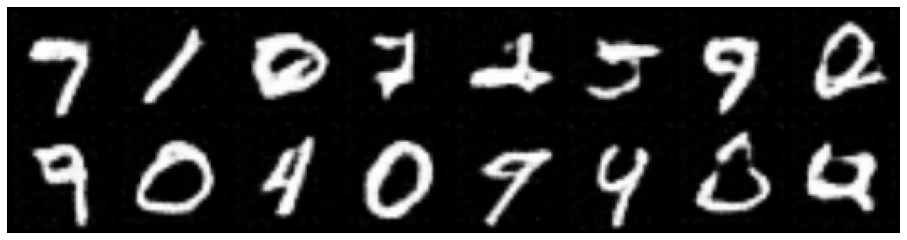

Epoch: [4/5] Batch: [1900/3750]
Loss_D: 0.2105361819267273 Loss_G: 5.5086989402771
D(x): 0.9346957206726074 D(G(z)): 0.10139475017786026


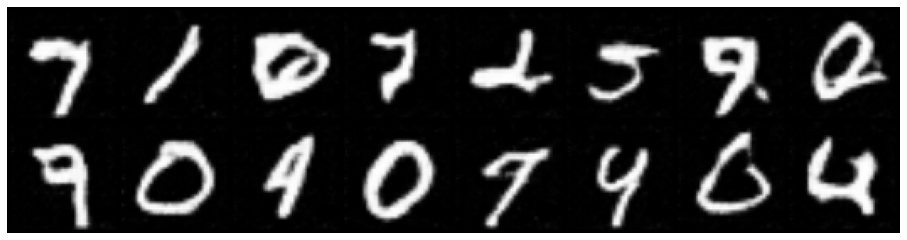

Epoch: [4/5] Batch: [2000/3750]
Loss_D: 0.011548280715942383 Loss_G: 6.760007858276367
D(x): 0.9916533827781677 D(G(z)): 0.0030924398452043533


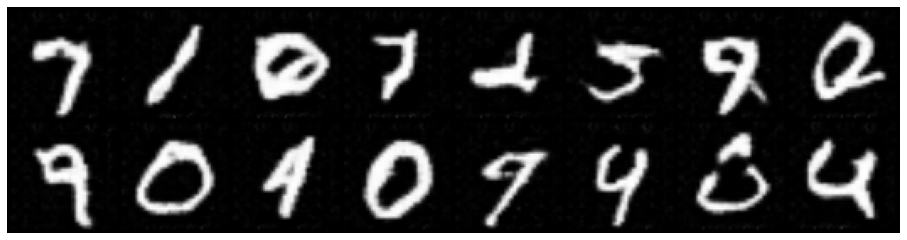

Epoch: [4/5] Batch: [2100/3750]
Loss_D: 0.002987493295222521 Loss_G: 7.430815696716309
D(x): 0.9981150031089783 D(G(z)): 0.0010972226737067103


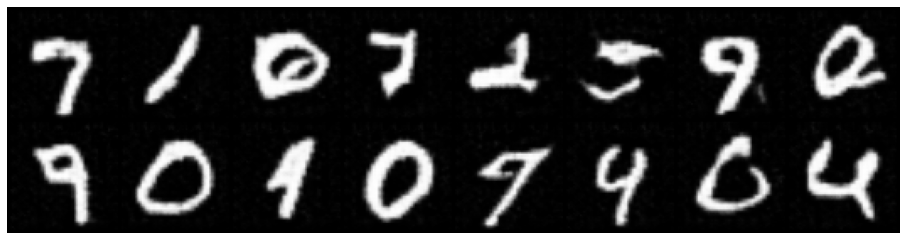

Epoch: [4/5] Batch: [2200/3750]
Loss_D: 0.011020789854228497 Loss_G: 6.165535926818848
D(x): 0.9995883703231812 D(G(z)): 0.01052301935851574


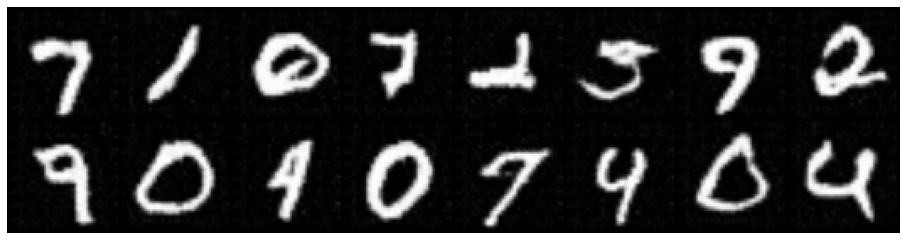

Epoch: [4/5] Batch: [2300/3750]
Loss_D: 7.10032844543457 Loss_G: 0.6155509948730469
D(x): 0.002316170372068882 D(G(z)): 5.660999704559799e-06


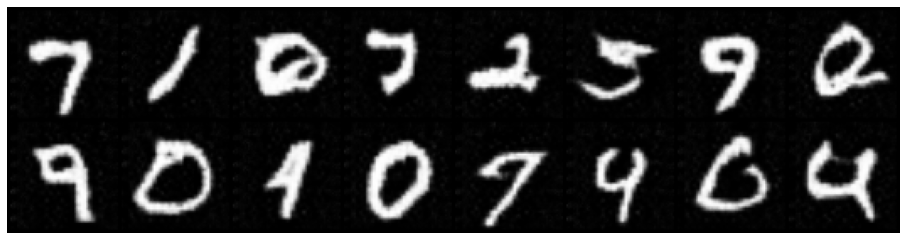

Epoch: [4/5] Batch: [2400/3750]
Loss_D: 0.9795979261398315 Loss_G: 11.373659133911133
D(x): 0.99991774559021 D(G(z)): 0.5386746525764465


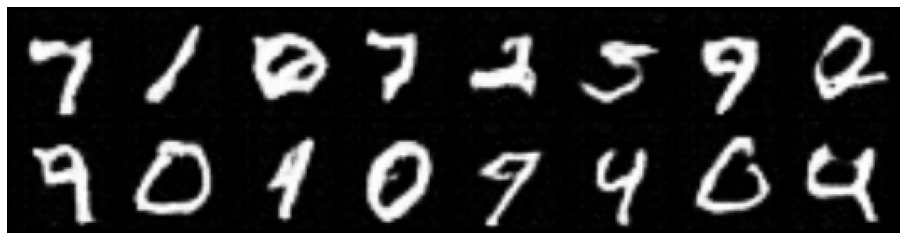

Epoch: [4/5] Batch: [2500/3750]
Loss_D: 0.08340628445148468 Loss_G: 4.85181999206543
D(x): 0.9775053262710571 D(G(z)): 0.05305550992488861


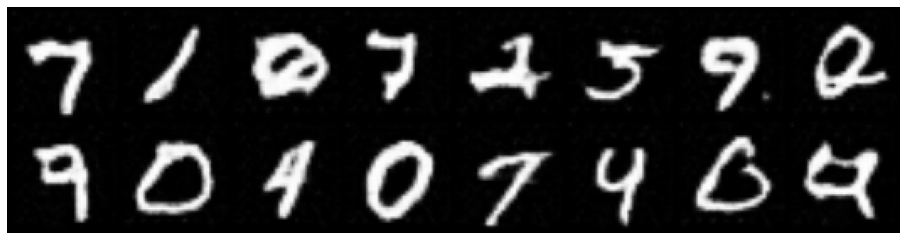

Epoch: [4/5] Batch: [2600/3750]
Loss_D: 0.26503413915634155 Loss_G: 2.928069829940796
D(x): 0.8493366241455078 D(G(z)): 0.08304227888584137


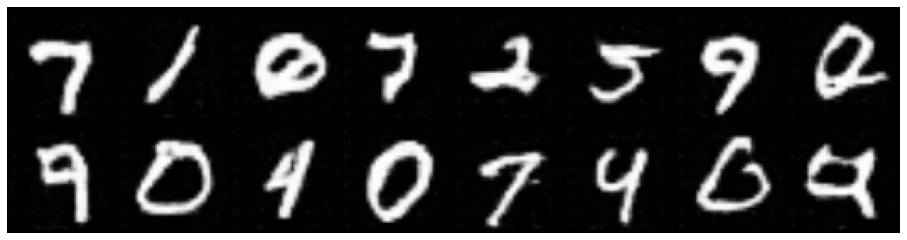

Epoch: [4/5] Batch: [2700/3750]
Loss_D: 0.01294194720685482 Loss_G: 4.911847114562988
D(x): 0.9931586384773254 D(G(z)): 0.005964853800833225


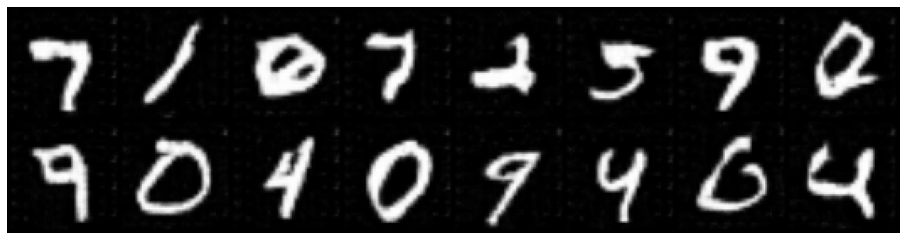

Epoch: [4/5] Batch: [2800/3750]
Loss_D: 0.016277045011520386 Loss_G: 6.484332084655762
D(x): 0.9963188171386719 D(G(z)): 0.012351062148809433


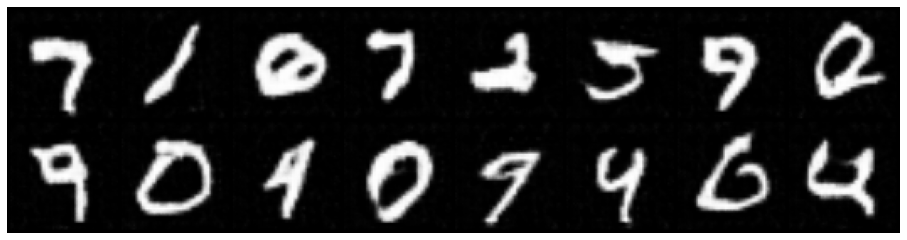

Epoch: [4/5] Batch: [2900/3750]
Loss_D: 0.10227106511592865 Loss_G: 5.0023393630981445
D(x): 0.998267650604248 D(G(z)): 0.0907488614320755


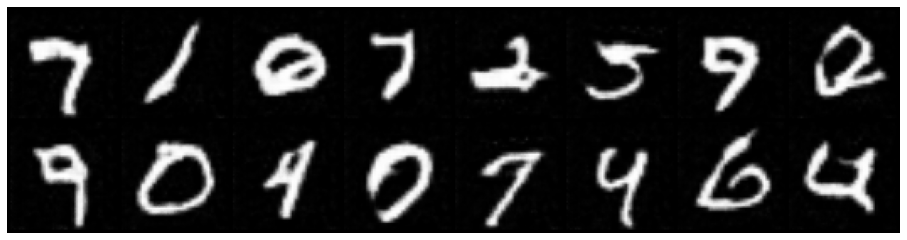

Epoch: [4/5] Batch: [3000/3750]
Loss_D: 0.05519399046897888 Loss_G: 6.190191268920898
D(x): 0.9531775116920471 D(G(z)): 0.0051601119339466095


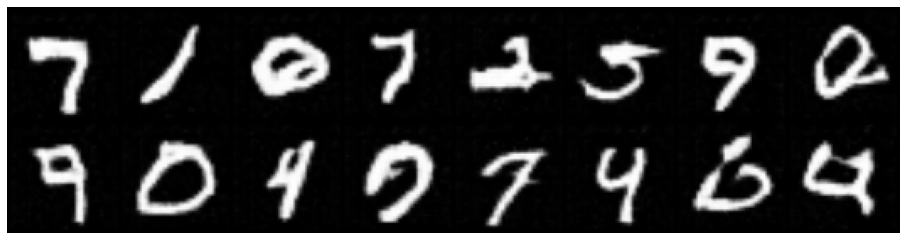

Epoch: [4/5] Batch: [3100/3750]
Loss_D: 0.007612913381308317 Loss_G: 6.178776741027832
D(x): 0.9955915212631226 D(G(z)): 0.003145611146464944


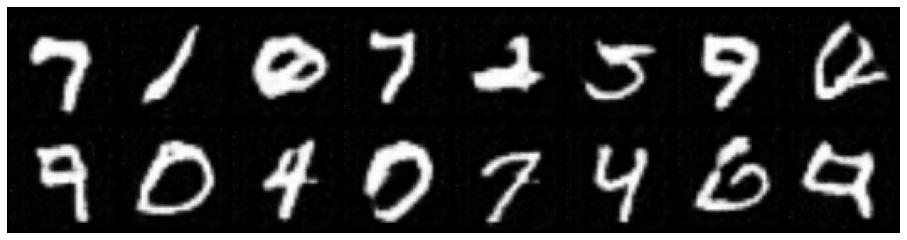

Epoch: [4/5] Batch: [3200/3750]
Loss_D: 0.026364393532276154 Loss_G: 6.183477401733398
D(x): 0.9993604421615601 D(G(z)): 0.023567982017993927


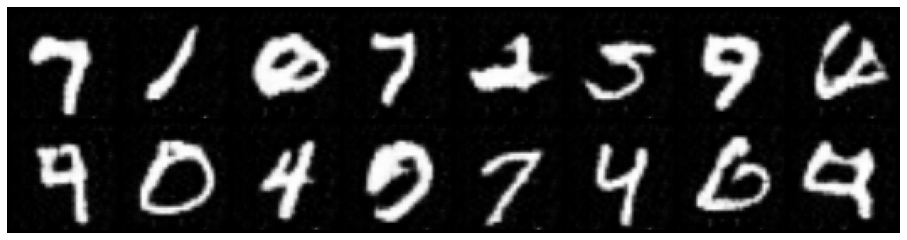

Epoch: [4/5] Batch: [3300/3750]
Loss_D: 0.005752109922468662 Loss_G: 5.837278366088867
D(x): 0.9987204074859619 D(G(z)): 0.004451008513569832


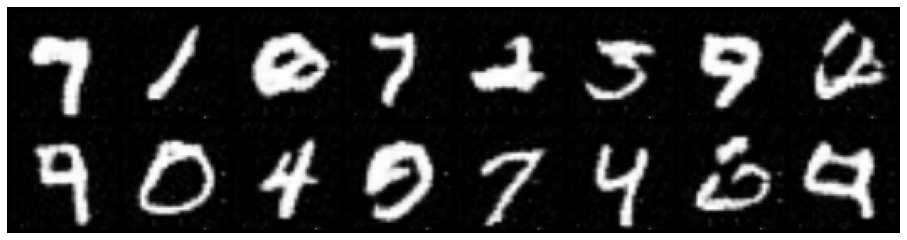

Epoch: [4/5] Batch: [3400/3750]
Loss_D: 0.0037219529040157795 Loss_G: 7.026708602905273
D(x): 0.9977614283561707 D(G(z)): 0.0014744119253009558


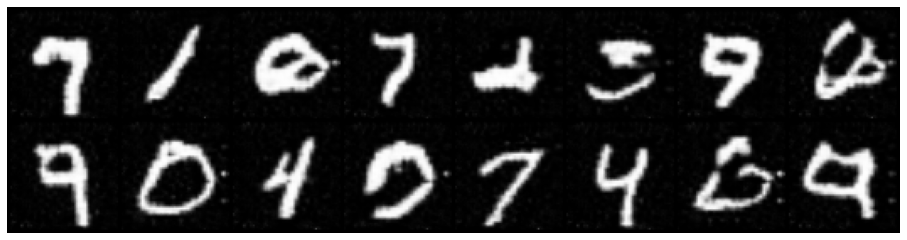

Epoch: [4/5] Batch: [3500/3750]
Loss_D: 1.1070644855499268 Loss_G: 3.6462440490722656
D(x): 0.5481863617897034 D(G(z)): 0.010736117139458656


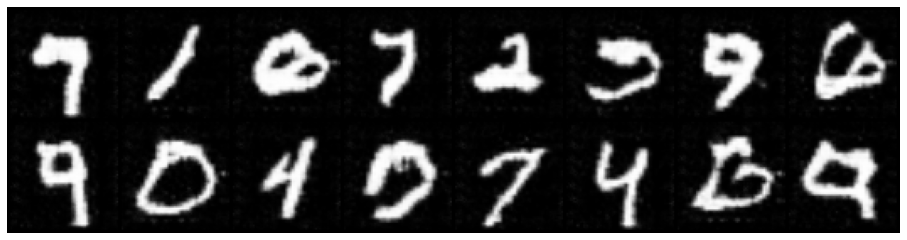

Epoch: [4/5] Batch: [3600/3750]
Loss_D: 0.6378030180931091 Loss_G: 3.4265425205230713
D(x): 0.5894092917442322 D(G(z)): 0.0008005885174497962


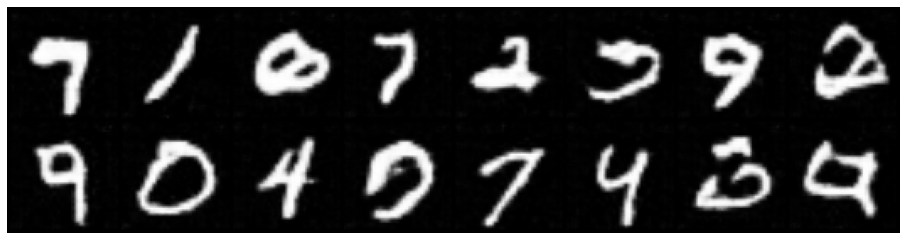

Epoch: [4/5] Batch: [3700/3750]
Loss_D: 0.09002859890460968 Loss_G: 4.6400861740112305
D(x): 0.9242125749588013 D(G(z)): 0.008299372158944607


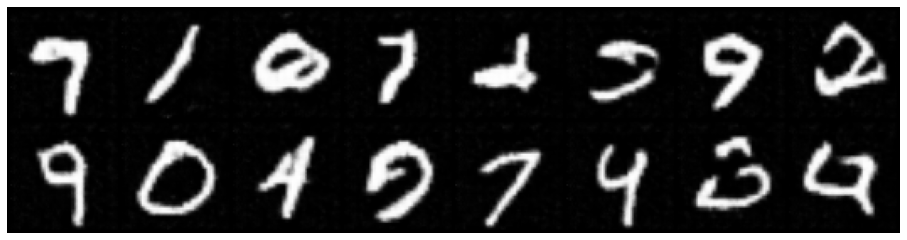

----------------------------------------
Epoch: [5/5] Batch: [0/3750]
Loss_D: 0.020999882370233536 Loss_G: 4.69703483581543
D(x): 0.9993758201599121 D(G(z)): 0.019874580204486847


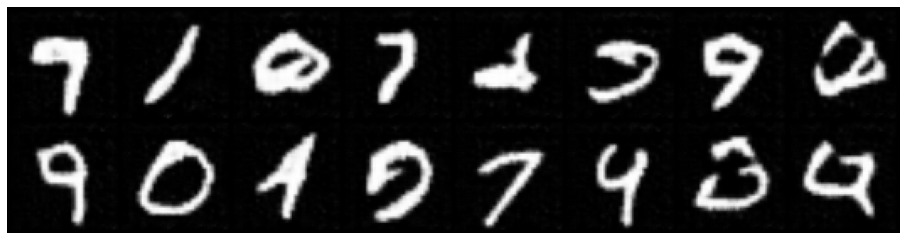

Epoch: [5/5] Batch: [100/3750]
Loss_D: 0.005995058920234442 Loss_G: 6.455044746398926
D(x): 0.9974806308746338 D(G(z)): 0.0034550209529697895


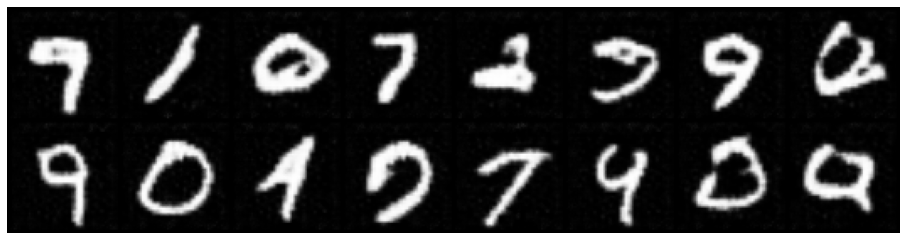

Epoch: [5/5] Batch: [200/3750]
Loss_D: 0.08842941373586655 Loss_G: 5.07988166809082
D(x): 0.9220403432846069 D(G(z)): 0.0045856209471821785


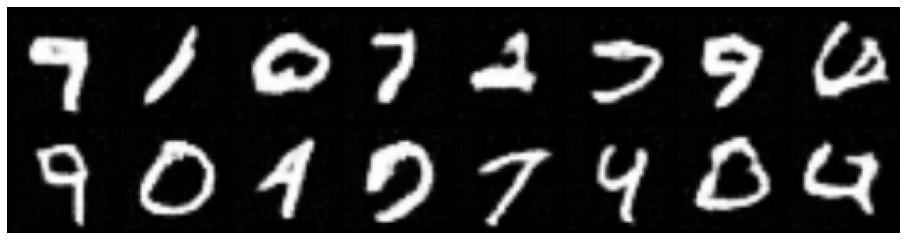

Epoch: [5/5] Batch: [300/3750]
Loss_D: 0.03172338008880615 Loss_G: 5.990128040313721
D(x): 0.9935616254806519 D(G(z)): 0.023933053016662598


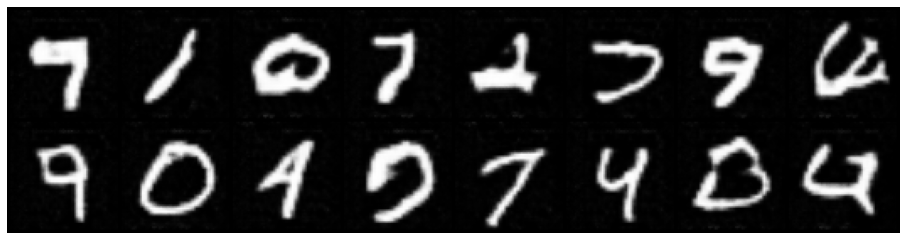

Epoch: [5/5] Batch: [400/3750]
Loss_D: 0.004435571376234293 Loss_G: 6.632616996765137
D(x): 0.9984908103942871 D(G(z)): 0.002911810064688325


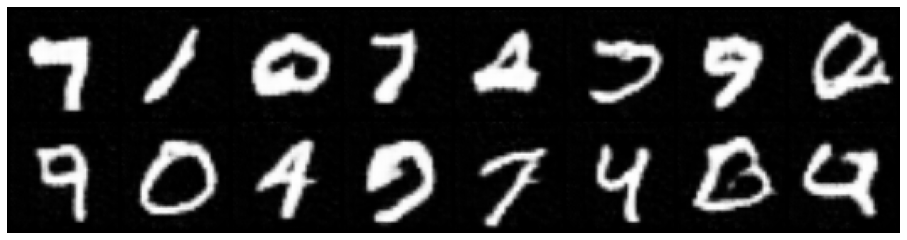

Epoch: [5/5] Batch: [500/3750]
Loss_D: 0.002657981589436531 Loss_G: 7.293785095214844
D(x): 0.9996277093887329 D(G(z)): 0.0022742992732673883


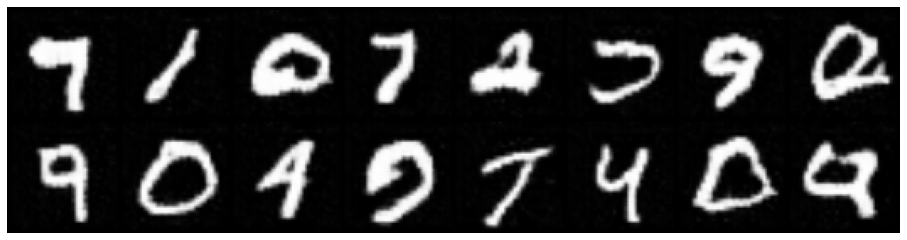

Epoch: [5/5] Batch: [600/3750]
Loss_D: 0.01103334128856659 Loss_G: 5.978554725646973
D(x): 0.9977635145187378 D(G(z)): 0.008728377521038055


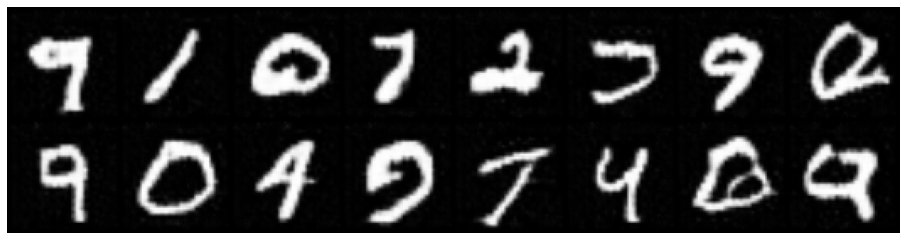

Epoch: [5/5] Batch: [700/3750]
Loss_D: 0.004417120479047298 Loss_G: 8.10540771484375
D(x): 0.9961934089660645 D(G(z)): 0.0005851417081430554


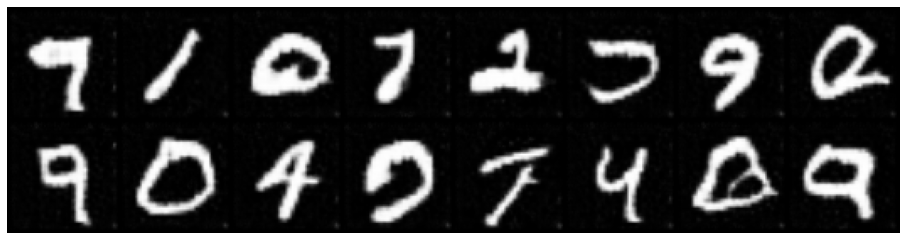

Epoch: [5/5] Batch: [800/3750]
Loss_D: 0.44246596097946167 Loss_G: 2.696946382522583
D(x): 0.8122138977050781 D(G(z)): 0.17043742537498474


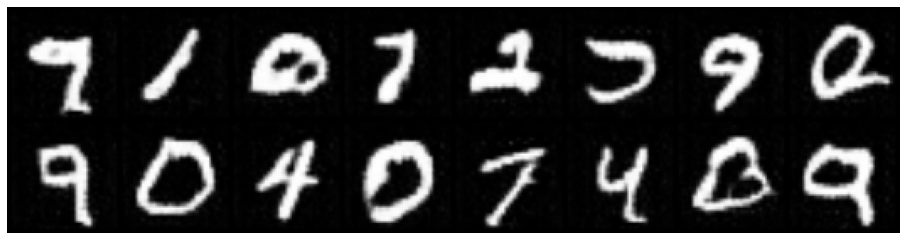

Epoch: [5/5] Batch: [900/3750]
Loss_D: 0.48133569955825806 Loss_G: 5.451898574829102
D(x): 0.7849524021148682 D(G(z)): 0.018711725249886513


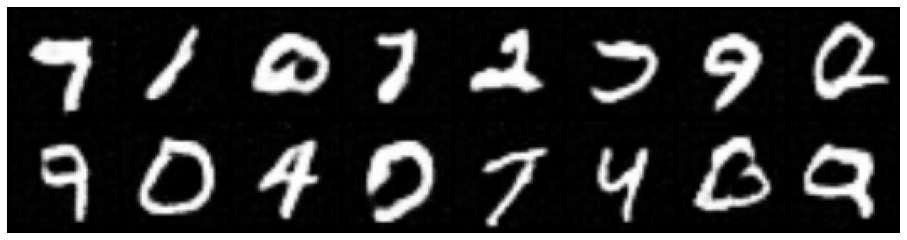

Epoch: [5/5] Batch: [1000/3750]
Loss_D: 0.7868776321411133 Loss_G: 8.391471862792969
D(x): 0.9976845979690552 D(G(z)): 0.44462451338768005


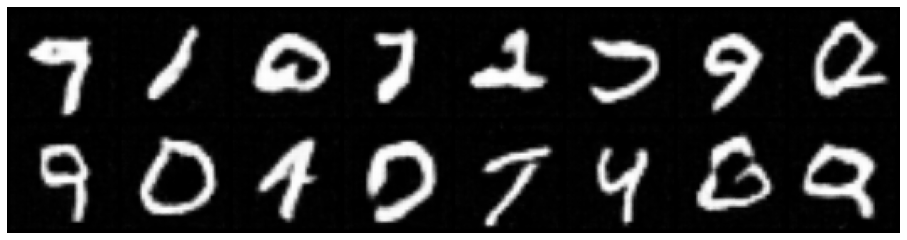

Epoch: [5/5] Batch: [1100/3750]
Loss_D: 3.5225276947021484 Loss_G: 9.62739372253418
D(x): 0.9985238313674927 D(G(z)): 0.9178205728530884


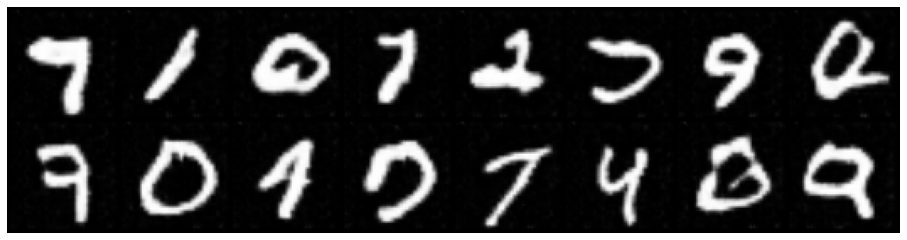

Epoch: [5/5] Batch: [1200/3750]
Loss_D: 0.05723465234041214 Loss_G: 4.99361515045166
D(x): 0.9494825005531311 D(G(z)): 0.003130507655441761


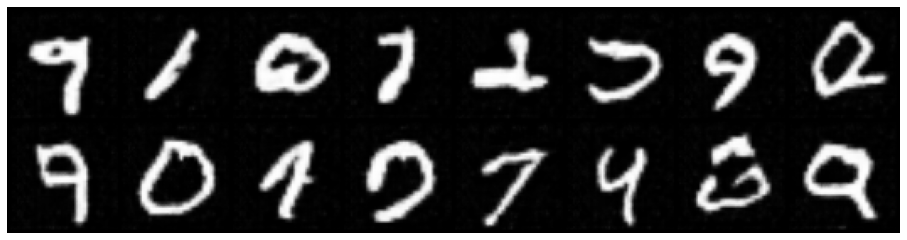

Epoch: [5/5] Batch: [1300/3750]
Loss_D: 0.02364460378885269 Loss_G: 4.791190147399902
D(x): 0.9897361993789673 D(G(z)): 0.012933693826198578


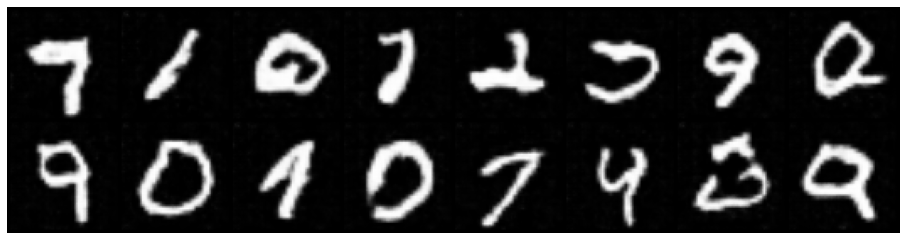

Epoch: [5/5] Batch: [1400/3750]
Loss_D: 0.03312145918607712 Loss_G: 4.60374641418457
D(x): 0.9966609477996826 D(G(z)): 0.028426682576537132


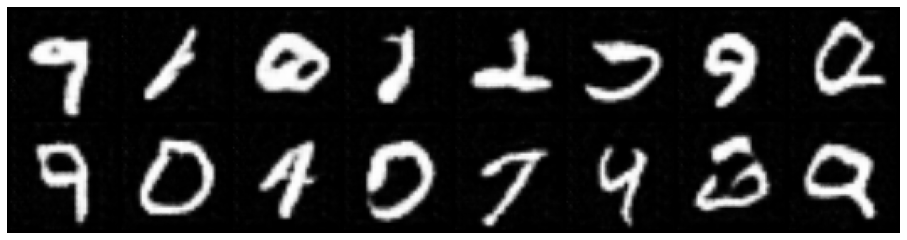

Epoch: [5/5] Batch: [1500/3750]
Loss_D: 0.03189500421285629 Loss_G: 8.737443923950195
D(x): 0.9696052074432373 D(G(z)): 0.0006959326565265656


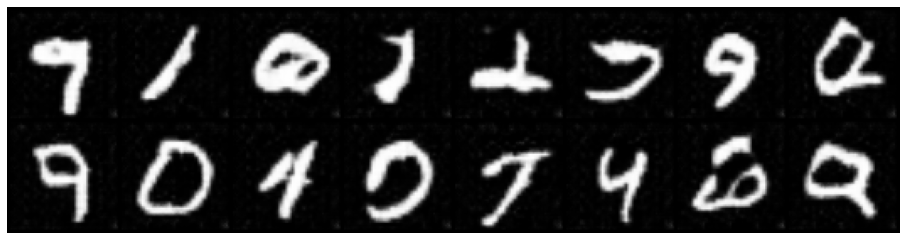

Epoch: [5/5] Batch: [1600/3750]
Loss_D: 0.004513588733971119 Loss_G: 6.540588855743408
D(x): 0.9991984367370605 D(G(z)): 0.003697361797094345


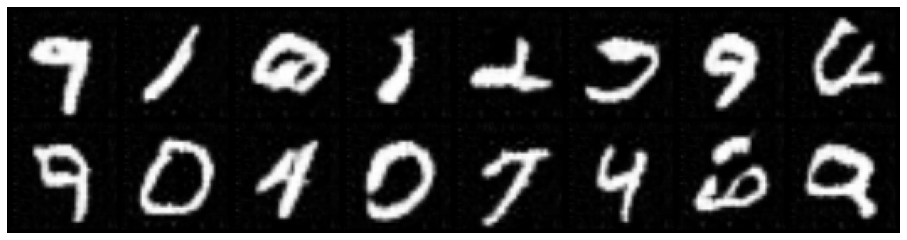

Epoch: [5/5] Batch: [1700/3750]
Loss_D: 0.0052015408873558044 Loss_G: 8.706296920776367
D(x): 0.9952069520950317 D(G(z)): 0.0003703845723066479


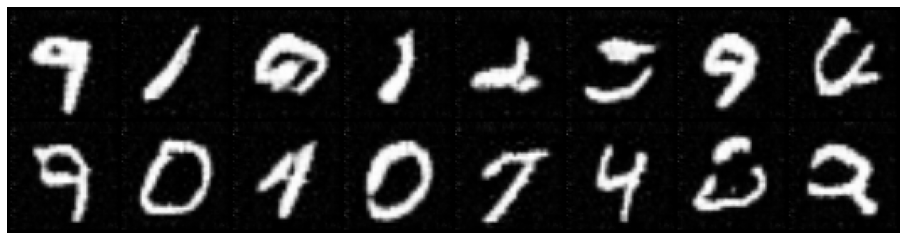

Epoch: [5/5] Batch: [1800/3750]
Loss_D: 0.07281271368265152 Loss_G: 4.137700080871582
D(x): 0.956576943397522 D(G(z)): 0.02541491389274597


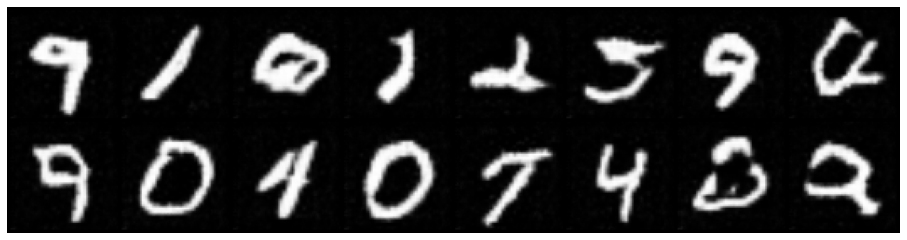

Epoch: [5/5] Batch: [1900/3750]
Loss_D: 0.9745395183563232 Loss_G: 0.4667710065841675
D(x): 0.49338001012802124 D(G(z)): 0.016797097399830818


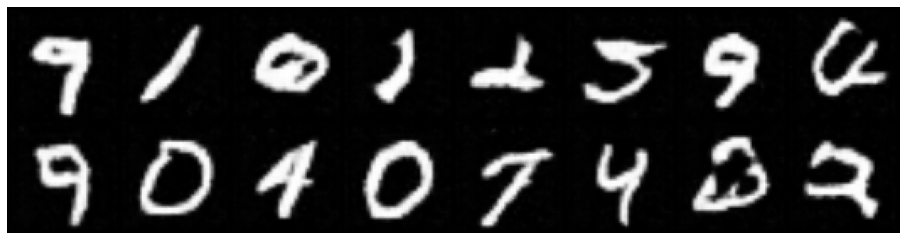

Epoch: [5/5] Batch: [2000/3750]
Loss_D: 0.03417658433318138 Loss_G: 9.577017784118652
D(x): 0.9677557349205017 D(G(z)): 0.00028055623988620937


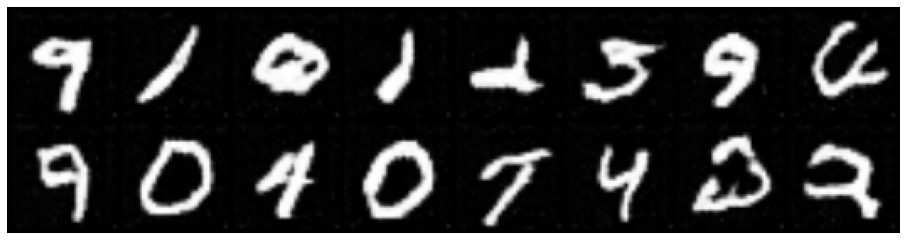

Epoch: [5/5] Batch: [2100/3750]
Loss_D: 0.010733331553637981 Loss_G: 5.94411563873291
D(x): 0.9936707615852356 D(G(z)): 0.004342958331108093


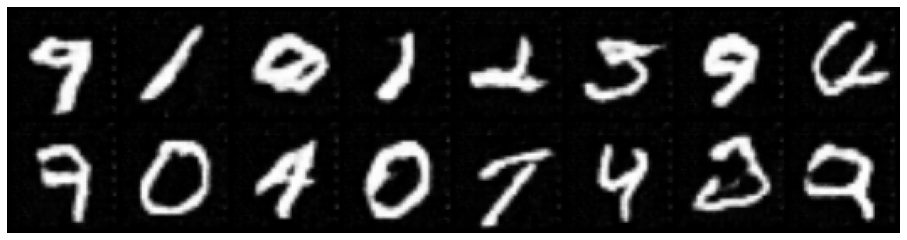

Epoch: [5/5] Batch: [2200/3750]
Loss_D: 0.02295905537903309 Loss_G: 5.742321014404297
D(x): 0.997599720954895 D(G(z)): 0.01993834786117077


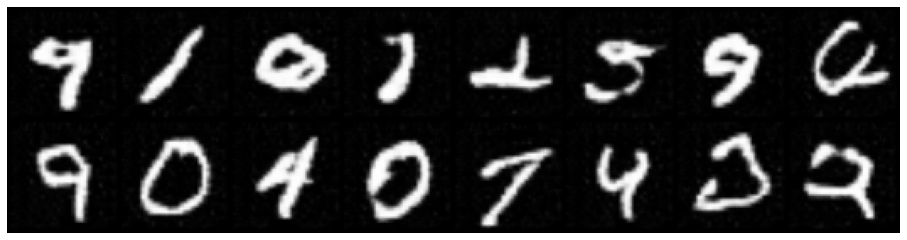

Epoch: [5/5] Batch: [2300/3750]
Loss_D: 0.03581719845533371 Loss_G: 6.292392730712891
D(x): 0.9658901691436768 D(G(z)): 0.0005862737307325006


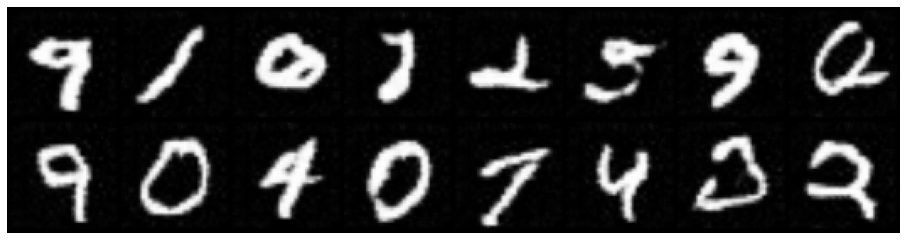

Epoch: [5/5] Batch: [2400/3750]
Loss_D: 0.449686199426651 Loss_G: 8.790863990783691
D(x): 0.9985654354095459 D(G(z)): 0.3281695246696472


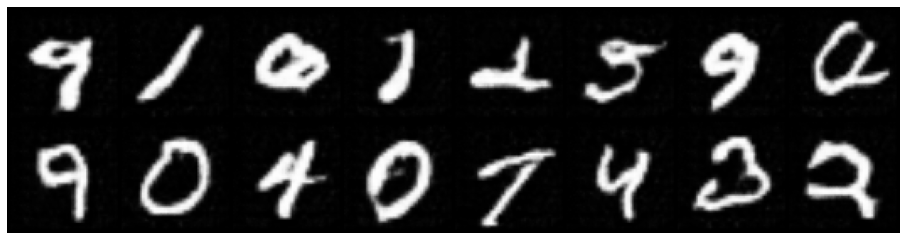

Epoch: [5/5] Batch: [2500/3750]
Loss_D: 0.009877653792500496 Loss_G: 5.661291122436523
D(x): 0.9981234073638916 D(G(z)): 0.007941339164972305


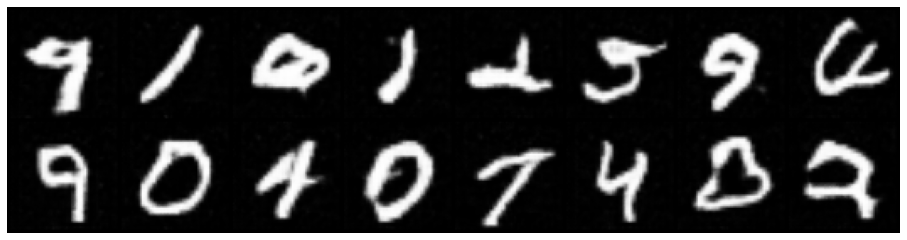

Epoch: [5/5] Batch: [2600/3750]
Loss_D: 0.019519668072462082 Loss_G: 5.496708393096924
D(x): 0.9997336268424988 D(G(z)): 0.01873335987329483


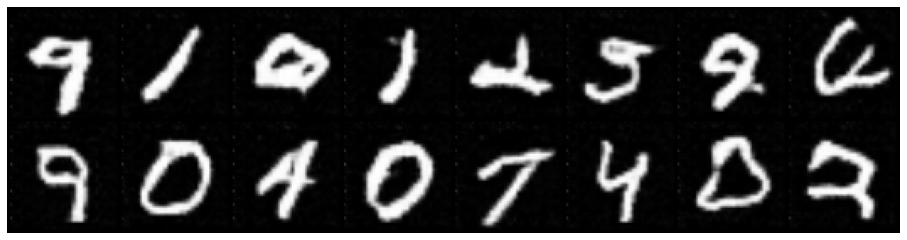

Epoch: [5/5] Batch: [2700/3750]
Loss_D: 0.5844086408615112 Loss_G: 7.788266181945801
D(x): 0.99971604347229 D(G(z)): 0.33944714069366455


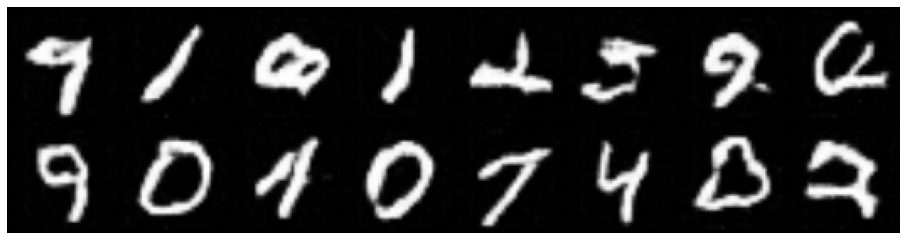

Epoch: [5/5] Batch: [2800/3750]
Loss_D: 0.04423278570175171 Loss_G: 5.852409362792969
D(x): 0.9605298042297363 D(G(z)): 0.0017912928014993668


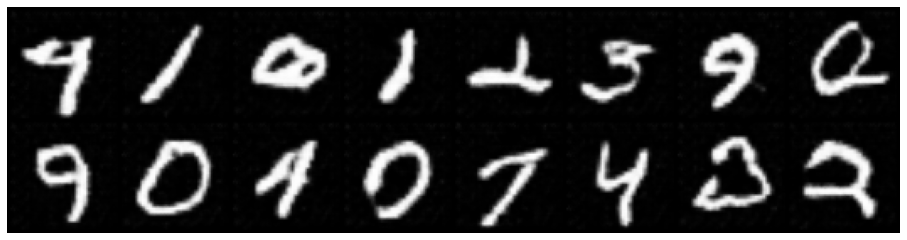

Epoch: [5/5] Batch: [2900/3750]
Loss_D: 0.004753609653562307 Loss_G: 6.289247989654541
D(x): 0.9987757802009583 D(G(z)): 0.003516976721584797


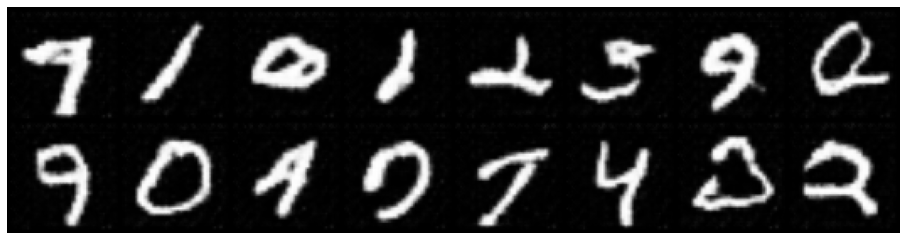

Epoch: [5/5] Batch: [3000/3750]
Loss_D: 0.037663981318473816 Loss_G: 5.460626602172852
D(x): 0.9673463106155396 D(G(z)): 0.002988527761772275


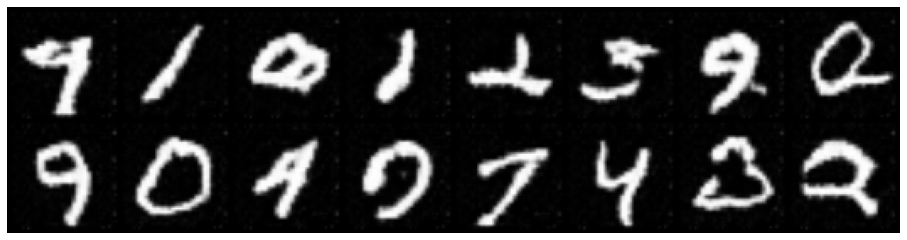

Epoch: [5/5] Batch: [3100/3750]
Loss_D: 0.004383014515042305 Loss_G: 6.515183925628662
D(x): 0.9974105358123779 D(G(z)): 0.0017848005518317223


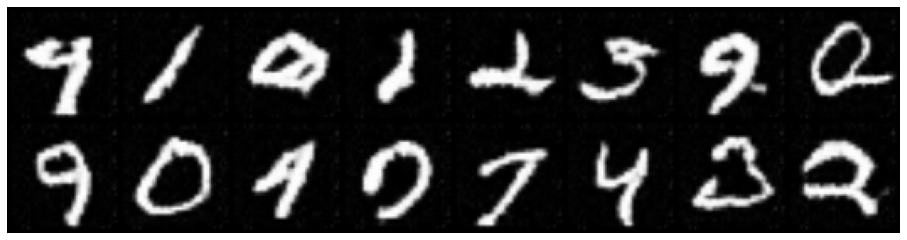

Epoch: [5/5] Batch: [3200/3750]
Loss_D: 0.0015170484548434615 Loss_G: 7.85895299911499
D(x): 0.9994282722473145 D(G(z)): 0.0009436315158382058


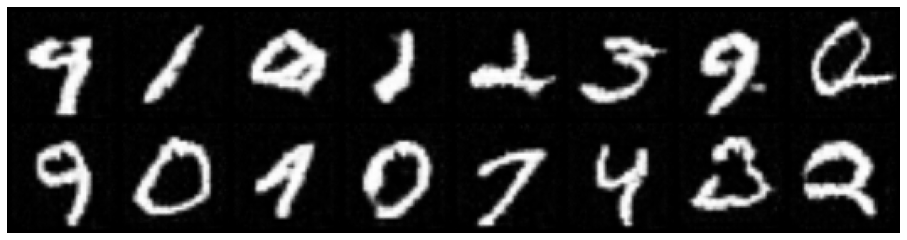

Epoch: [5/5] Batch: [3300/3750]
Loss_D: 0.018070943653583527 Loss_G: 6.221513271331787
D(x): 0.9958502650260925 D(G(z)): 0.013015711680054665


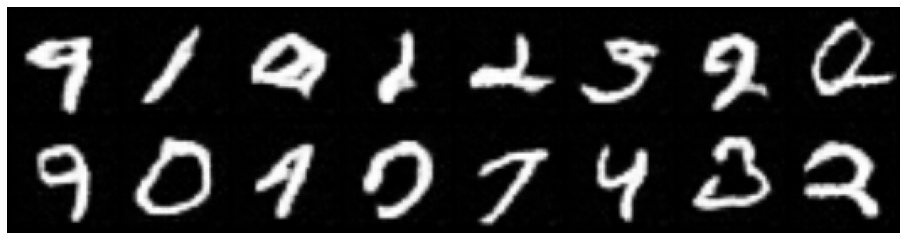

Epoch: [5/5] Batch: [3400/3750]
Loss_D: 0.7337067723274231 Loss_G: 2.8670127391815186
D(x): 0.6075503826141357 D(G(z)): 0.016741862520575523


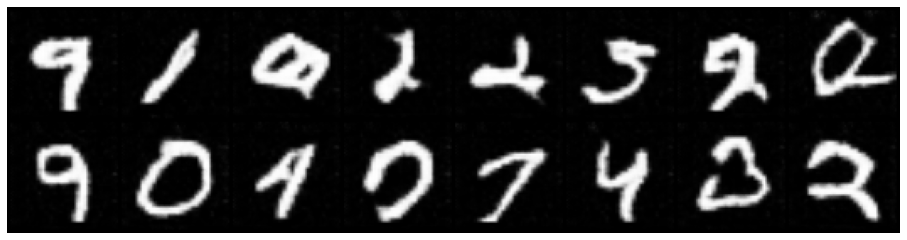

Epoch: [5/5] Batch: [3500/3750]
Loss_D: 0.015129825100302696 Loss_G: 5.453683853149414
D(x): 0.9898984432220459 D(G(z)): 0.004619728308171034


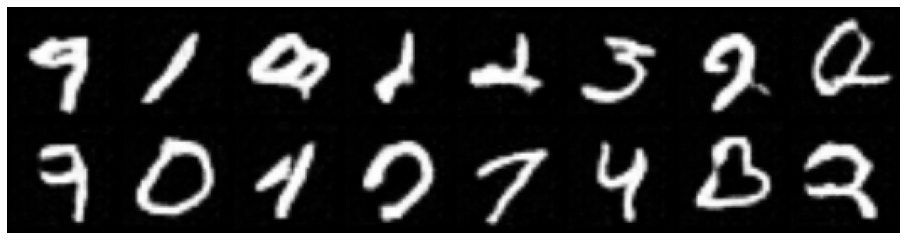

Epoch: [5/5] Batch: [3600/3750]
Loss_D: 0.12960593402385712 Loss_G: 6.592791557312012
D(x): 0.999160647392273 D(G(z)): 0.11043275147676468


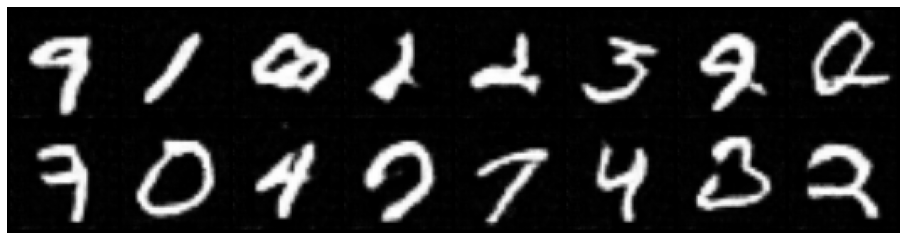

Epoch: [5/5] Batch: [3700/3750]
Loss_D: 0.015110710635781288 Loss_G: 5.926548957824707
D(x): 0.9959433078765869 D(G(z)): 0.010912822559475899


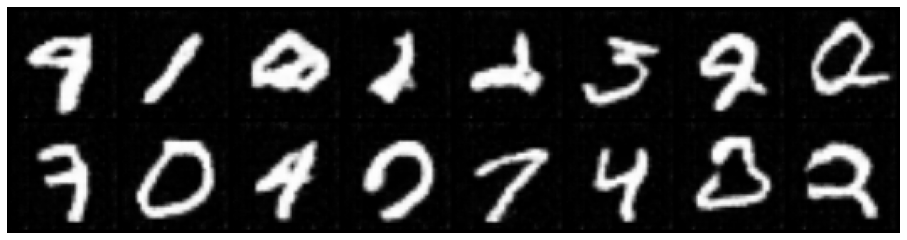

In [23]:
imgs, g_loss, d_loss = train(dataset=dc_mnist,test_noise=test_noise,linear=False)

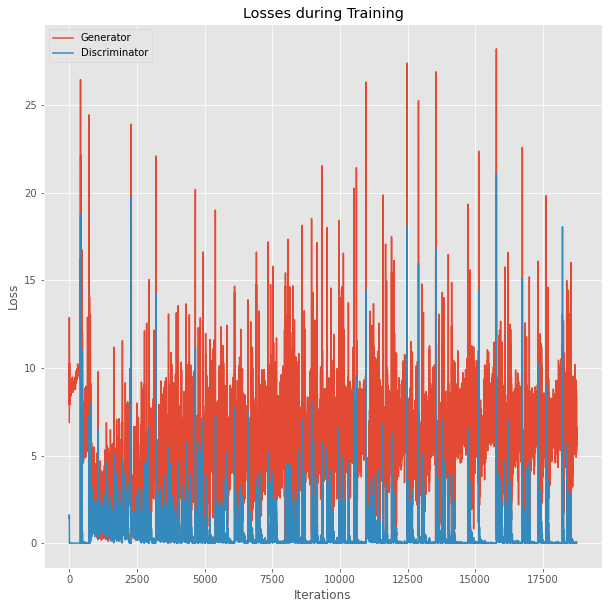

In [24]:
plt.style.use('ggplot')
fig, ax = plt.subplots(figsize=(10,10))
ax.set_title('Losses during Training')
ax.plot(g_loss,label="Generator")
ax.plot(d_loss,label="Discriminator")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [29]:
import cv2 as cv
import imageio
import os

#VERY VERY ROUGH CONVERSION. But it worked. Got a bit lazy here. hehe
converted_list = []

for i in imgs:
    img = cv.resize((i*255).numpy().transpose(1,2,0),[262,262]).astype('uint8')
    converted_list.append(img)
#     break
# converted_list = [np.transpose((i*255).numpy().astype('uint8'),(1,2,0)) for i in imgs]

imageio.mimsave('./dc_mnist_test.gif',converted_list,fps=5)